In [8]:
import image_process
import os
from glob import glob
from matplotlib import pyplot as plt
import math
import numpy as np
from tensorflow.keras.layers import Input, Reshape, Dropout, Dense, Flatten, BatchNormalization, Activation, ZeroPadding2D
from tensorflow.python.keras.layers.advanced_activations import LeakyReLU
from tensorflow.python.keras.layers.convolutional import UpSampling2D, Conv2D
from tensorflow.python.keras.models import Sequential, Model, load_model
from tensorflow.keras.optimizers import Adam

In [9]:
data_dir = './data'
image_process.download_and_unzip(data_dir)

Data already exists


In [10]:
address = glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))
images = image_process.process_image_batch(address, 64, 64)
train = images / 127.5 - 1.

In [43]:
train.shape

(202599, 64, 64, 3)

In [55]:
train = train.reshape(202599, 12288)

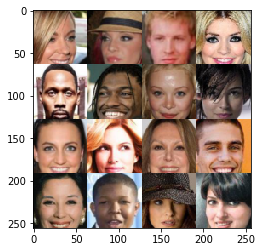

In [181]:
eg = image_process.process_image_batch(address[:16], 64, 64)
pyplot.imshow(image_process.plot_example_image(eg))

In [12]:
def build_generator():
    input = Input(shape=(100,))
    d1 = Dense(256*4*4,activation="relu")(input)
    d1 = Reshape((4,4,256))(d1)
    up = UpSampling2D()(d1)
    conv1 = Conv2D(256,kernel_size=3,padding="same")(up)
    conv1 = BatchNormalization(momentum=0.8)(conv1)
    conv1 = Activation("relu")(conv1)
    conv2 = UpSampling2D()(conv1)
    conv2 = Conv2D(256,kernel_size=3,padding="same")(conv2)
    conv2 = BatchNormalization(momentum=0.8)(conv2)
    conv2 = Activation("relu")(conv2)
    conv3 = UpSampling2D()(conv2)
    conv3 = Conv2D(128,kernel_size=3,padding="same")(conv3)
    conv3 = BatchNormalization(momentum=0.8)(conv3)
    conv3 = Activation("relu")(conv3)
    conv4 = UpSampling2D()(conv3)
    conv4 = Conv2D(128,kernel_size=3,padding="same")(conv4)
    conv4 = BatchNormalization(momentum=0.8)(conv4)
    conv4 = Activation("relu")(conv4)
    
    conv5 = Conv2D(3,kernel_size=3,padding="same")(conv4)
    conv5 = Activation("tanh")(conv5)
    
    generator = Model(input,conv5)
    
    generator.compile(loss='binary_crossentropy', optimizer=Adam(0.0002,0.5))
    
    return generator

In [56]:
def adam_optimizer():
    return Adam(lr=0.0002, beta_1=0.5)
def build_generator():
    generator=Sequential()
    generator.add(Dense(units=256,input_dim=100))
    generator.add(LeakyReLU(0.2))
    
    generator.add(Dense(units=512))
    generator.add(LeakyReLU(0.2))
    
    generator.add(Dense(units=1024))
    generator.add(LeakyReLU(0.2))
    
    generator.add(Dense(units=12288, activation='tanh'))
    
    generator.compile(loss='binary_crossentropy', optimizer=adam_optimizer())
    return generator
g=build_generator()
g.summary()

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_42 (Dense)             (None, 256)               25856     
_________________________________________________________________
leaky_re_lu_50 (LeakyReLU)   (None, 256)               0         
_________________________________________________________________
dense_43 (Dense)             (None, 512)               131584    
_________________________________________________________________
leaky_re_lu_51 (LeakyReLU)   (None, 512)               0         
_________________________________________________________________
dense_44 (Dense)             (None, 1024)              525312    
_________________________________________________________________
leaky_re_lu_52 (LeakyReLU)   (None, 1024)              0         
_________________________________________________________________
dense_45 (Dense)             (None, 12288)            

In [13]:
def build_discriminator():
    
    input = Input(shape=(64,64,3))
    conv1 = Conv2D(32, kernel_size=3, strides=2, padding="same")(input)
    conv1 = LeakyReLU(alpha=0.2)(conv1)
    conv1 = Dropout(0.25)(conv1)
    conv2 = Conv2D(64, kernel_size=3, strides=2, padding="same")(conv1)
    conv2 = ZeroPadding2D(padding=((0,1),(0,1)))(conv2)
    conv2 = BatchNormalization(momentum=0.8)(conv2)
    conv2 = LeakyReLU(alpha=0.2)(conv2)
    conv2 = Dropout(0.25)(conv2)
    conv3 = Conv2D(128, kernel_size=3, strides=2, padding="same")(conv2)
    conv3 = BatchNormalization(momentum=0.8)(conv3)
    conv3 = LeakyReLU(alpha=0.2)(conv3)
    conv3 = Dropout(0.25)(conv3)
    conv4 = Conv2D(256, kernel_size=3, strides=1, padding="same")(conv3)
    conv4 = BatchNormalization(momentum=0.8)(conv4)
    conv4 = LeakyReLU(alpha=0.2)(conv4)
    conv4 = Dropout(0.25)(conv4)
    d = Flatten()(conv4)
    d = Dense(1, activation='sigmoid')(d)
    
    discriminator = Model(input,d)
    discriminator.compile(loss="binary_crossentropy",optimizer=Adam(0.0002,0.5),metrics=["accuracy"])
    
    return discriminator

In [57]:
def build_discriminator():
    discriminator=Sequential()
    discriminator.add(Dense(units=1024,input_dim=12288))
    discriminator.add(LeakyReLU(0.2))
    discriminator.add(Dropout(0.3))
       
    
    discriminator.add(Dense(units=512))
    discriminator.add(LeakyReLU(0.2))
    discriminator.add(Dropout(0.3))
       
    discriminator.add(Dense(units=256))
    discriminator.add(LeakyReLU(0.2))
    
    discriminator.add(Dense(units=1, activation='sigmoid'))
    
    discriminator.compile(loss='binary_crossentropy', optimizer=adam_optimizer())
    return discriminator
d =build_discriminator()
d.summary()

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_46 (Dense)             (None, 1024)              12583936  
_________________________________________________________________
leaky_re_lu_53 (LeakyReLU)   (None, 1024)              0         
_________________________________________________________________
dropout_35 (Dropout)         (None, 1024)              0         
_________________________________________________________________
dense_47 (Dense)             (None, 512)               524800    
_________________________________________________________________
leaky_re_lu_54 (LeakyReLU)   (None, 512)               0         
_________________________________________________________________
dropout_36 (Dropout)         (None, 512)               0         
_________________________________________________________________
dense_48 (Dense)             (None, 256)             

In [60]:
generator = build_generator()
discriminator = build_discriminator()

In [61]:
def build_gan(generator,discriminator):
    discriminator.trainable=False
    gan_input = Input(shape=(100,))
    x = generator(gan_input)
    gan_output= discriminator(x)
    
    gan= Model(gan_input, gan_output)
    gan.compile(loss='binary_crossentropy', optimizer=Adam(0.0002,0.5))
    return gan
    

In [62]:
gan = build_gan(generator,discriminator)
gan.summary()

Model: "model_22"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_24 (InputLayer)        [(None, 100)]             0         
_________________________________________________________________
sequential_11 (Sequential)   (None, 12288)             13277952  
_________________________________________________________________
sequential_12 (Sequential)   (None, 1)                 13240321  
Total params: 26,518,273
Trainable params: 13,277,952
Non-trainable params: 13,240,321
_________________________________________________________________


In [24]:
def save_images(epoch):
    rows, columns = 5, 5
    noise = np.random.normal(0, 1, (rows * columns, 100))
    generated_images = generator.predict(noise)

    generated_images = 0.5 * generated_images + 0.5

    figure, axis = plt.subplots(rows, columns)
    image_count = 0
    for row in range(rows):
        for column in range(columns):
            axis[row,column].imshow(generated_images[image_count, :], cmap='spring')
            axis[row,column].axis('off')
            image_count += 1
    figure.savefig("./generated_images/generated_%d.png" % epoch)
    plt.close()


In [63]:
def plot_generated_images(epoch, generator, examples=100, dim=(10,10), figsize=(10,10)):
    noise= np.random.normal(loc=0, scale=1, size=[examples, 100])
    generated_images = generator.predict(noise)
    generated_images = generated_images.reshape(100,64,64,3)
    plt.figure(figsize=figsize)
    for i in range(generated_images.shape[0]):
        plt.subplot(dim[0], dim[1], i+1)
        plt.imshow(generated_images[i], interpolation='nearest')
        plt.axis('off')
    plt.tight_layout()
    plt.savefig('gan_generated_image %d.png' %epoch)

In [19]:
y_dis=np.zeros(2*32)
y_dis[:32]=0.9

In [29]:
tqdm(range(32))

  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

In [68]:
def training(training_data, epochs=1, batch_size=32):
    for e in range(1,epochs+1):
        print("Epoch %d" %e)
        for _ in tqdm(range(batch_size)):
            noise= np.random.normal(0,1, [batch_size, 100])
            generated_images = generator.predict(noise)
            image_batch =training_data[np.random.randint(low=0,high=training_data.shape[0],size=batch_size)]
            
            X= np.concatenate([image_batch, generated_images])
            
            y_dis=np.zeros(2*batch_size)
            y_dis[:batch_size]=0.9
            
            discriminator.trainable=True
            discriminator.train_on_batch(X, y_dis)
            
            noise= np.random.normal(0,1, [batch_size, 100])
            y_gen = np.ones(batch_size)
            
            discriminator.trainable=False
            gan.train_on_batch(noise, y_gen)
            
        if e % 50 == 0:
            plot_generated_images(e, generator)






  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 1







  1%|          | 1/128 [00:00<01:28,  1.43it/s]




  2%|▏         | 2/128 [00:01<01:15,  1.68it/s]




  2%|▏         | 3/128 [00:01<01:05,  1.90it/s]




  3%|▎         | 4/128 [00:01<00:58,  2.12it/s]




  4%|▍         | 5/128 [00:02<00:54,  2.26it/s]




  5%|▍         | 6/128 [00:02<00:52,  2.35it/s]




  5%|▌         | 7/128 [00:02<00:48,  2.48it/s]




  6%|▋         | 8/128 [00:03<00:47,  2.55it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.56it/s]




  8%|▊         | 10/128 [00:04<00:45,  2.57it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.59it/s]




  9%|▉         | 12/128 [00:04<00:46,  2.50it/s]




 10%|█         | 13/128 [00:05<00:44,  2.57it/s]




 11%|█         | 14/128 [00:05<00:43,  2.64it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.67it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.63it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.63it/s]




 14%|█▍        | 18/128 [00:07<00:41,  2.68it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:46<00:02,  2.65it/s]




 95%|█████████▌| 122/128 [00:46<00:02,  2.66it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:47<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:47<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:48<00:00,  2.72it/s]




100%|██████████| 128/128 [00:48<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 2







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:40,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:47,  2.34it/s]




 15%|█▍        | 19/128 [00:07<00:44,  2.43it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.39it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.47it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.53it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.55it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.55it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.57it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.61it/s]




100%|██████████| 128/128 [00:48<00:00,  2.62it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 3







  1%|          | 1/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.62it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.64it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.64it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.64it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.67it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.66it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.65it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.65it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:42,  2.68it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:47<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.75it/s]




100%|██████████| 128/128 [00:48<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 4







  1%|          | 1/128 [00:00<00:50,  2.51it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.66it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.70it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:42,  2.70it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 5







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 6







  1%|          | 1/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.71it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.68it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.69it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:42,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:43,  2.56it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.63it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.67it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.71it/s]




100%|██████████| 128/128 [00:46<00:00,  2.64it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 7







  1%|          | 1/128 [00:00<00:48,  2.63it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.62it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.67it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 8







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:04<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:43,  2.56it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.54it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.66it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.67it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 9







  1%|          | 1/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.64it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:43,  2.67it/s]




 11%|█         | 14/128 [00:05<00:42,  2.66it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.69it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.91it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 10







  1%|          | 1/128 [00:00<00:52,  2.42it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.93it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.90it/s]




 10%|█         | 13/128 [00:04<00:39,  2.88it/s]




 11%|█         | 14/128 [00:04<00:39,  2.89it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.79it/s]




100%|██████████| 128/128 [00:45<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 11







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:05<00:40,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.85it/s]




100%|██████████| 128/128 [00:45<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 12







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:39,  2.90it/s]




 11%|█         | 14/128 [00:04<00:39,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.87it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.89it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.90it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.89it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.89it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.89it/s]




100%|██████████| 128/128 [00:45<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 13







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:52,  2.16it/s]




 12%|█▎        | 16/128 [00:06<00:49,  2.26it/s]




 13%|█▎        | 17/128 [00:06<00:45,  2.43it/s]




 14%|█▍        | 18/128 [00:06<00:43,  2.52it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.61it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 14







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:42,  2.68it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.66it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 15







  1%|          | 1/128 [00:00<00:39,  3.22it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.08it/s]




  2%|▏         | 3/128 [00:01<00:41,  3.00it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.91it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.92it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.91it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:39,  2.90it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.78it/s]




100%|██████████| 128/128 [00:45<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 16







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.88it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 17







  1%|          | 1/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.88it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:04<00:39,  2.92it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.92it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.87it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.88it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.99it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.99it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.97it/s]




100%|██████████| 128/128 [00:45<00:00,  2.96it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 18







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.87it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.88it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 19







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.68it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.63it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.76it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:43,  2.65it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.59it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.62it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.75it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 20







  1%|          | 1/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:04<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.92it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 21







  1%|          | 1/128 [00:00<00:44,  2.88it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:43,  2.62it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:45<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 22







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:04<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.88it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 23







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.91it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.94it/s]




  5%|▌         | 7/128 [00:02<00:40,  2.99it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.99it/s]




  7%|▋         | 9/128 [00:03<00:39,  2.99it/s]




  8%|▊         | 10/128 [00:03<00:39,  2.98it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.97it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.93it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:04<00:40,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.92it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.95it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.89it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.85it/s]




100%|██████████| 128/128 [00:45<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 24







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.70it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.63it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.84it/s]




100%|██████████| 128/128 [00:45<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 25







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.91it/s]




 10%|█         | 13/128 [00:04<00:39,  2.95it/s]




 11%|█         | 14/128 [00:04<00:38,  2.93it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.88it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.92it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.92it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.92it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.88it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 26







  1%|          | 1/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.71it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.88it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 27







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.86it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 28







  1%|          | 1/128 [00:00<00:44,  2.88it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.94it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.91it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.96it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.97it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.92it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:42<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.82it/s]




100%|██████████| 128/128 [00:45<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 29







  1%|          | 1/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.89it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:04<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.89it/s]




100%|██████████| 128/128 [00:45<00:00,  2.94it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 30







  1%|          | 1/128 [00:00<00:51,  2.45it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.51it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.58it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.66it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.76it/s]




100%|██████████| 128/128 [00:45<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 31







  1%|          | 1/128 [00:00<00:44,  2.88it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.64it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.63it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.56it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.63it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.63it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:40,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.96it/s]




100%|██████████| 128/128 [00:46<00:00,  2.89it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 32







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:40,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.80it/s]




100%|██████████| 128/128 [00:47<00:00,  2.88it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 33







  1%|          | 1/128 [00:00<00:41,  3.04it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.04it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.68it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.88it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.90it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 34







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.87it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.90it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.89it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.92it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.92it/s]




 10%|█         | 13/128 [00:04<00:39,  2.91it/s]




 11%|█         | 14/128 [00:04<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.90it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.87it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.64it/s]




100%|██████████| 128/128 [00:45<00:00,  2.64it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 35







  1%|          | 1/128 [00:00<00:48,  2.63it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:04<00:39,  2.89it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.66it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.85it/s]




100%|██████████| 128/128 [00:45<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 36







  1%|          | 1/128 [00:00<00:44,  2.88it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.59it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.63it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:42<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.69it/s]




100%|██████████| 128/128 [00:45<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 37







  1%|          | 1/128 [00:00<00:43,  2.94it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.95it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.94it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.94it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.93it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:43,  2.54it/s]




 15%|█▍        | 19/128 [00:06<00:42,  2.58it/s]



 95%|█████████▍| 121/128 [00:42<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.94it/s]




 97%|█████████▋| 124/128 [00:43<00:01,  2.94it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.93it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.91it/s]




 99%|█████████▉| 127/128 [00:44<00:00,  2.90it/s]




100%|██████████| 128/128 [00:45<00:00,  2.93it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 38







  1%|          | 1/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.94it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.91it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.98it/s]




  4%|▍         | 5/128 [00:01<00:41,  3.00it/s]




  5%|▍         | 6/128 [00:01<00:40,  3.03it/s]




  5%|▌         | 7/128 [00:02<00:40,  2.99it/s]




  6%|▋         | 8/128 [00:02<00:39,  3.03it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.97it/s]




  8%|▊         | 10/128 [00:03<00:39,  2.99it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:04<00:40,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.87it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.91it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.90it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.90it/s]




100%|██████████| 128/128 [00:45<00:00,  2.88it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 39







  1%|          | 1/128 [00:00<00:40,  3.11it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.06it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:39,  2.91it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.89it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.63it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.87it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.92it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.53it/s]




100%|██████████| 128/128 [00:46<00:00,  2.66it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 40







  1%|          | 1/128 [00:00<00:44,  2.88it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.91it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.59it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.64it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.66it/s]




 10%|█         | 13/128 [00:04<00:43,  2.64it/s]




 11%|█         | 14/128 [00:05<00:42,  2.68it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.69it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.67it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.71it/s]




100%|██████████| 128/128 [00:45<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 41







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.74it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.63it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.79it/s]




100%|██████████| 128/128 [00:45<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 42







  1%|          | 1/128 [00:00<00:41,  3.05it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.93it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:04<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:42<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:43<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:44<00:00,  2.72it/s]




100%|██████████| 128/128 [00:45<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 43







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.93it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.92it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.90it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.90it/s]




 10%|█         | 13/128 [00:04<00:39,  2.88it/s]




 11%|█         | 14/128 [00:04<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:42<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:42<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.87it/s]




 97%|█████████▋| 124/128 [00:43<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:43<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:44<00:00,  2.88it/s]




100%|██████████| 128/128 [00:44<00:00,  2.94it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 44







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.93it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.90it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.89it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.91it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.96it/s]




 10%|█         | 13/128 [00:04<00:38,  2.97it/s]




 11%|█         | 14/128 [00:04<00:38,  2.99it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.92it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:42<00:02,  2.89it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.93it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:43<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:44<00:00,  2.99it/s]




100%|██████████| 128/128 [00:45<00:00,  2.96it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 45







  1%|          | 1/128 [00:00<00:39,  3.25it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.08it/s]




  2%|▏         | 3/128 [00:00<00:39,  3.14it/s]




  3%|▎         | 4/128 [00:01<00:40,  3.05it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.92it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.88it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.94it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.94it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.96it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:39,  2.92it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.89it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:42<00:02,  3.05it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.99it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  3.00it/s]




 97%|█████████▋| 124/128 [00:43<00:01,  2.89it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.99it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.96it/s]




 99%|█████████▉| 127/128 [00:44<00:00,  2.91it/s]




100%|██████████| 128/128 [00:45<00:00,  2.89it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 46







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.89it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.91it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.91it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.91it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.90it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:43,  2.61it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.83it/s]




100%|██████████| 128/128 [00:45<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 47







  1%|          | 1/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.96it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.77it/s]




100%|██████████| 128/128 [00:45<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 48







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.89it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:40,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.89it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.92it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.91it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.93it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.91it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 49







  1%|          | 1/128 [00:00<00:43,  2.94it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.88it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.88it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.87it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.82it/s]




100%|██████████| 128/128 [00:45<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 50







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:04<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.65it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.63it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  3.01it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.88it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.92it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.86it/s]




100%|██████████| 128/128 [00:45<00:00,  2.91it/s]W0822 00:56:40.776055 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 00:56:40.891286 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 00:56:40.971956 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 00:56:41.052747 4463596992 image.py:693] Clipping input data to the valid range for imshow with 

W0822 00:56:41.901695 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 00:56:41.915863 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 00:56:41.937181 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 00:56:41.963721 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 00:56:41.978218 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 00:56:41.994087 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 00:56:42.008165 4463596992 image.py:693] Clipping in

Epoch 51







  1%|          | 1/128 [00:00<01:02,  2.03it/s]




  2%|▏         | 2/128 [00:00<00:56,  2.23it/s]




  2%|▏         | 3/128 [00:01<00:55,  2.26it/s]




  3%|▎         | 4/128 [00:01<00:52,  2.37it/s]




  4%|▍         | 5/128 [00:01<00:48,  2.51it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.52it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.59it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.65it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.60it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.63it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.61it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.60it/s]




 10%|█         | 13/128 [00:05<00:43,  2.65it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:06<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.88it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.94it/s]




100%|██████████| 128/128 [00:46<00:00,  2.90it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 52







  1%|          | 1/128 [00:00<00:41,  3.04it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.97it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.68it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:42,  2.68it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.88it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 53







  1%|          | 1/128 [00:00<00:49,  2.56it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.64it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.63it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.90it/s]




 10%|█         | 13/128 [00:04<00:39,  2.88it/s]




 11%|█         | 14/128 [00:04<00:39,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.88it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.92it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.89it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 54







  1%|          | 1/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.93it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.90it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:46,  2.54it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.59it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.87it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.92it/s]




 15%|█▍        | 19/128 [00:06<00:36,  3.02it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.59it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.64it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.86it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 55







  1%|          | 1/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.93it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.92it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.95it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:04<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.70it/s]




100%|██████████| 128/128 [00:45<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 56







  1%|          | 1/128 [00:00<00:48,  2.64it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:04<00:39,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:44,  2.42it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:45<00:00,  3.00it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.92it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 57







  1%|          | 1/128 [00:00<00:54,  2.33it/s]




  2%|▏         | 2/128 [00:00<00:51,  2.43it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.58it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.70it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.67it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.63it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.66it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.64it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.86it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 58







  1%|          | 1/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.70it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:47,  2.47it/s]




  9%|▊         | 11/128 [00:04<00:46,  2.50it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.55it/s]




 10%|█         | 13/128 [00:04<00:43,  2.62it/s]




 11%|█         | 14/128 [00:05<00:42,  2.65it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.72it/s]




100%|██████████| 128/128 [00:45<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 59







  1%|          | 1/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.87it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.89it/s]




 10%|█         | 13/128 [00:04<00:38,  2.98it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.93it/s]




 12%|█▎        | 16/128 [00:05<00:37,  2.97it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.93it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:42<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:42<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:43<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:44<00:00,  2.74it/s]




100%|██████████| 128/128 [00:45<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 60







  1%|          | 1/128 [00:00<00:51,  2.46it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.54it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.53it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.61it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.67it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:05<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.85it/s]




100%|██████████| 128/128 [00:45<00:00,  2.86it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 61







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.87it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.87it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.79it/s]



 95%|█████████▍| 121/128 [00:42<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.94it/s]




100%|██████████| 128/128 [00:45<00:00,  3.05it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 62







  1%|          | 1/128 [00:00<00:41,  3.04it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.03it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.92it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.54it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.61it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.68it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:39,  2.97it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.91it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.90it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.65it/s]




 15%|█▍        | 19/128 [00:06<00:42,  2.55it/s]



 95%|█████████▍| 121/128 [00:42<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.71it/s]




100%|██████████| 128/128 [00:45<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 63







  1%|          | 1/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.92it/s]




  4%|▍         | 5/128 [00:02<01:08,  1.79it/s]




  5%|▍         | 6/128 [00:02<01:00,  2.02it/s]




  5%|▌         | 7/128 [00:03<00:55,  2.17it/s]




  6%|▋         | 8/128 [00:03<00:50,  2.35it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.49it/s]




  8%|▊         | 10/128 [00:04<00:45,  2.57it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.66it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.61it/s]




 10%|█         | 13/128 [00:05<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:43,  2.63it/s]




 12%|█▏        | 15/128 [00:06<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.60it/s]




 14%|█▍        | 18/128 [00:07<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.43it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.51it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.59it/s]




100%|██████████| 128/128 [00:47<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 64







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.67it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.66it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.67it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.62it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 65







  1%|          | 1/128 [00:00<00:42,  2.99it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.02it/s]




  2%|▏         | 3/128 [00:01<00:41,  2.99it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.98it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.93it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.94it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.93it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.91it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.89it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.92it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:04<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.94it/s]




100%|██████████| 128/128 [00:45<00:00,  2.93it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 66







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.92it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:04<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.96it/s]




 12%|█▎        | 16/128 [00:05<00:37,  2.96it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.95it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.89it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.89it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.95it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  3.03it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.96it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.69it/s]




100%|██████████| 128/128 [00:45<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 67







  1%|          | 1/128 [00:00<00:51,  2.46it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.47it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.58it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:40,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.88it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.89it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.89it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.88it/s]




100%|██████████| 128/128 [00:45<00:00,  2.89it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 68







  1%|          | 1/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.94it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.90it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:39,  2.94it/s]




 11%|█         | 14/128 [00:04<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.89it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.87it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.46it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.56it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.50it/s]




100%|██████████| 128/128 [00:45<00:00,  2.56it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 69







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.93it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.58it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.73it/s]




100%|██████████| 128/128 [00:45<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 70







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.87it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.92it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.67it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.64it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.66it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.68it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.62it/s]




100%|██████████| 128/128 [00:46<00:00,  2.65it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 71







  1%|          | 1/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.87it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.93it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.95it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.92it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.90it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.78it/s]




100%|██████████| 128/128 [00:45<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 72







  1%|          | 1/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.91it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.94it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.92it/s]




 10%|█         | 13/128 [00:04<00:39,  2.92it/s]




 11%|█         | 14/128 [00:04<00:38,  2.93it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.95it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.66it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.68it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.65it/s]




100%|██████████| 128/128 [00:45<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 73







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:39,  2.88it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.89it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.56it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.90it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.92it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.89it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.87it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 74







  1%|          | 1/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.95it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.89it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.63it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.90it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.93it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.89it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:42<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:43<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.91it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.76it/s]




100%|██████████| 128/128 [00:45<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 75







  1%|          | 1/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.83it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:05<00:40,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.88it/s]



 95%|█████████▍| 121/128 [00:44<00:03,  2.22it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.39it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.56it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.59it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.67it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.60it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 76







  1%|          | 1/128 [00:00<00:46,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.87it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.90it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.98it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.54it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.65it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.89it/s]




100%|██████████| 128/128 [00:45<00:00,  2.95it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 77







  1%|          | 1/128 [00:00<00:41,  3.05it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.65it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.60it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 78







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:04<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:45,  2.46it/s]




 13%|█▎        | 17/128 [00:06<00:44,  2.51it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.58it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.65it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.60it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.52it/s]




100%|██████████| 128/128 [00:46<00:00,  2.61it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 79







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.91it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.66it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.88it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.88it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 80







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.95it/s]




  2%|▏         | 3/128 [00:00<00:41,  3.01it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.89it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.50it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.61it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.87it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.66it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.68it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.60it/s]




100%|██████████| 128/128 [00:46<00:00,  2.66it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 81







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.95it/s]




 10%|█         | 13/128 [00:04<00:39,  2.94it/s]




 11%|█         | 14/128 [00:04<00:37,  3.00it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.94it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.91it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.92it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.89it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.91it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 82







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.90it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:39,  2.91it/s]




 11%|█         | 14/128 [00:04<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.93it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.94it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.89it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.96it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:42<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.61it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.62it/s]




100%|██████████| 128/128 [00:45<00:00,  2.63it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 83







  1%|          | 1/128 [00:00<00:41,  3.04it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.53it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.62it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.83it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 84







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.88it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.89it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:04<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.80it/s]




100%|██████████| 128/128 [00:45<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 85







  1%|          | 1/128 [00:00<00:42,  3.01it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.02it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.97it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.53it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.54it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.59it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.60it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.60it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:39,  2.91it/s]




 11%|█         | 14/128 [00:05<00:39,  2.89it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.88it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.70it/s]




100%|██████████| 128/128 [00:46<00:00,  2.68it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 86







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.66it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.68it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.83it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:05<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.90it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.93it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.61it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.66it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.67it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.67it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.84it/s]




100%|██████████| 128/128 [00:45<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 87







  1%|          | 1/128 [00:00<00:39,  3.18it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.03it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.94it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.78it/s]




100%|██████████| 128/128 [00:45<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 88







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.90it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:04<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.62it/s]



 95%|█████████▍| 121/128 [00:43<00:03,  2.00it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.09it/s]




 96%|█████████▌| 123/128 [00:44<00:02,  2.26it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.36it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.44it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.52it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.59it/s]




100%|██████████| 128/128 [00:46<00:00,  2.61it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 89







  1%|          | 1/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.71it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.61it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.62it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.61it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.59it/s]




 10%|█         | 13/128 [00:04<00:43,  2.66it/s]




 11%|█         | 14/128 [00:05<00:41,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.65it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.63it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.57it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.63it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:47<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 90







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.63it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.68it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.66it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:39,  2.93it/s]




 11%|█         | 14/128 [00:05<00:39,  2.92it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.92it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.91it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.90it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.91it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.82it/s]




100%|██████████| 128/128 [00:45<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 91







  1%|          | 1/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.93it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.90it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.91it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.91it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.95it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.89it/s]




 10%|█         | 13/128 [00:04<00:38,  2.97it/s]




 11%|█         | 14/128 [00:04<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 92







  1%|          | 1/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.94it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.89it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:05<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.87it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.93it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 93







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.63it/s]




 10%|█         | 13/128 [00:04<00:42,  2.68it/s]




 11%|█         | 14/128 [00:05<00:43,  2.64it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.60it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.63it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.67it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:45<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 94







  1%|          | 1/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.70it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.68it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.58it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.53it/s]




 10%|█         | 13/128 [00:04<00:45,  2.54it/s]




 11%|█         | 14/128 [00:05<00:44,  2.58it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.87it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:45<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 95







  1%|          | 1/128 [00:00<00:43,  2.94it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.94it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.89it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.89it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.94it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.66it/s]




 10%|█         | 13/128 [00:04<00:44,  2.60it/s]




 11%|█         | 14/128 [00:05<00:43,  2.64it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.71it/s]




100%|██████████| 128/128 [00:45<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 96







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.89it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.83it/s]




 10%|█         | 13/128 [00:04<00:39,  2.88it/s]




 11%|█         | 14/128 [00:04<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.90it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.89it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.91it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 97







  1%|          | 1/128 [00:00<00:43,  2.94it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.93it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.91it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.90it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.90it/s]




 10%|█         | 13/128 [00:04<00:39,  2.92it/s]




 11%|█         | 14/128 [00:04<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.92it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.78it/s]




100%|██████████| 128/128 [00:45<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 98







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.92it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:04<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 99







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.87it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.63it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.64it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:37,  2.95it/s]




 13%|█▎        | 17/128 [00:06<00:37,  2.93it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.66it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.87it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 100







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.87it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:39,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.70it/s]




100%|██████████| 128/128 [00:45<00:00,  2.70it/s]W0822 01:35:05.237244 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 01:35:05.261701 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 01:35:05.274972 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 01:35:05.287147 4463596992 image.py:693] Clipping input data to the valid range for imshow with 

W0822 01:35:06.025563 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 01:35:06.041465 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 01:35:06.064463 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 01:35:06.094158 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 01:35:06.124973 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 01:35:06.141269 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 01:35:06.157580 4463596992 image.py:693] Clipping in

Epoch 101







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.61it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.63it/s]




  4%|▍         | 5/128 [00:01<00:49,  2.51it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.56it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:03<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.81it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.76it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:43,  2.63it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.64it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.64it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.62it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.92it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.95it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.89it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.63it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 102







  1%|          | 1/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.68it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:42,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.67it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.60it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 103







  1%|          | 1/128 [00:00<00:59,  2.13it/s]




  2%|▏         | 2/128 [00:00<00:55,  2.25it/s]




  2%|▏         | 3/128 [00:01<00:50,  2.46it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.55it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.58it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.61it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.64it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.91it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.64it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.65it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.69it/s]




100%|██████████| 128/128 [00:46<00:00,  2.64it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 104







  1%|          | 1/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:46,  2.57it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.83it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:52,  2.14it/s]




 12%|█▎        | 16/128 [00:06<01:00,  1.85it/s]




 13%|█▎        | 17/128 [00:06<00:54,  2.04it/s]




 14%|█▍        | 18/128 [00:07<00:48,  2.25it/s]




 15%|█▍        | 19/128 [00:07<00:45,  2.40it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 105







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.90it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.90it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.89it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:04<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.89it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.88it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.92it/s]




100%|██████████| 128/128 [00:45<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 106







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.64it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.85it/s]




100%|██████████| 128/128 [00:45<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 107







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.87it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.91it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.66it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.61it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 108







  1%|          | 1/128 [00:00<00:50,  2.52it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.53it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.63it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.83it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.61it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.67it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.60it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 109







  1%|          | 1/128 [00:00<00:50,  2.53it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.59it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.63it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.64it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.71it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.62it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.63it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.68it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.68it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.70it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.87it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.91it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.93it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.89it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 110







  1%|          | 1/128 [00:00<00:46,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.64it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.57it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.61it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.89it/s]




 10%|█         | 13/128 [00:04<00:38,  2.98it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.89it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.68it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.63it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 111







  1%|          | 1/128 [00:00<00:41,  3.03it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.95it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.92it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.94it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.66it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 112







  1%|          | 1/128 [00:00<00:48,  2.63it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.83it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:04<00:39,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.89it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.98it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.91it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.89it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.91it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.78it/s]




100%|██████████| 128/128 [00:45<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 113







  1%|          | 1/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.89it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:39,  2.88it/s]




 11%|█         | 14/128 [00:04<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.90it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.68it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.76it/s]




100%|██████████| 128/128 [00:45<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 114







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:39,  2.91it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.61it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.66it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.59it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.66it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 115







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.63it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:40,  2.96it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.88it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.91it/s]




  9%|▉         | 12/128 [00:04<00:38,  2.98it/s]




 10%|█         | 13/128 [00:04<00:39,  2.94it/s]




 11%|█         | 14/128 [00:04<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.56it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.63it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  1.84it/s]




100%|██████████| 128/128 [00:47<00:00,  1.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 116







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.92it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.96it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:44,  2.62it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.55it/s]




 10%|█         | 13/128 [00:04<00:43,  2.67it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.66it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.59it/s]




100%|██████████| 128/128 [00:45<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 117







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.87it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.60it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.66it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 118







  1%|          | 1/128 [00:00<00:46,  2.75it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:04<00:38,  2.98it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.94it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.91it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.90it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.94it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.87it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 119







  1%|          | 1/128 [00:00<00:44,  2.88it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:44,  2.60it/s]




 11%|█         | 14/128 [00:05<00:43,  2.62it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.63it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.65it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 120







  1%|          | 1/128 [00:00<00:52,  2.43it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.59it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.57it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:46,  2.49it/s]




 11%|█         | 14/128 [00:05<00:44,  2.57it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.63it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.69it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.91it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.94it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.92it/s]




100%|██████████| 128/128 [00:47<00:00,  2.93it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 121







  1%|          | 1/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.65it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.61it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.51it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.58it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.69it/s]




100%|██████████| 128/128 [00:46<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 122







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.65it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:42,  2.74it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.66it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.89it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.91it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.93it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.90it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 123







  1%|          | 1/128 [00:00<00:41,  3.06it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.89it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.95it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.95it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.64it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.86it/s]




100%|██████████| 128/128 [00:45<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 124







  1%|          | 1/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.89it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:04<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.58it/s]




 12%|█▎        | 16/128 [00:05<00:43,  2.59it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.64it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.92it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 125







  1%|          | 1/128 [00:00<00:42,  3.01it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.66it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.60it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.63it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.58it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.68it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:43,  2.65it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.65it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.62it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.57it/s]




 15%|█▍        | 19/128 [00:07<00:44,  2.43it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.69it/s]




100%|██████████| 128/128 [00:46<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 126







  1%|          | 1/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.61it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.65it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.60it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.65it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.54it/s]




 10%|█         | 13/128 [00:04<00:44,  2.57it/s]




 11%|█         | 14/128 [00:05<00:43,  2.63it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.59it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.65it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.68it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.95it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.93it/s]




100%|██████████| 128/128 [00:46<00:00,  2.87it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 127







  1%|          | 1/128 [00:00<00:51,  2.44it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.58it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.64it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:04<00:39,  2.91it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.87it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.65it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.64it/s]




100%|██████████| 128/128 [00:46<00:00,  2.63it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 128







  1%|          | 1/128 [00:00<00:51,  2.45it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.53it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.59it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.63it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.71it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.61it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.65it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.64it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.89it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.89it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 129







  1%|          | 1/128 [00:00<00:42,  3.00it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.93it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.96it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.94it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.65it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:42,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.68it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.69it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 130







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.63it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.87it/s]




100%|██████████| 128/128 [00:46<00:00,  2.87it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 131







  1%|          | 1/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.87it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.92it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.90it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.93it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.92it/s]




 10%|█         | 13/128 [00:04<00:39,  2.90it/s]




 11%|█         | 14/128 [00:04<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.68it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.63it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.68it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 132







  1%|          | 1/128 [00:00<00:41,  3.03it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.90it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:40,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.53it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.60it/s]




100%|██████████| 128/128 [00:46<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 133







  1%|          | 1/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.69it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 134







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.88it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 135







  1%|          | 1/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.88it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.88it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.83it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:39,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.91it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.91it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.94it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.89it/s]




100%|██████████| 128/128 [00:45<00:00,  2.87it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 136







  1%|          | 1/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.56it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.57it/s]




  4%|▍         | 5/128 [00:01<00:48,  2.53it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.60it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.68it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.61it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.65it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:44,  2.60it/s]




 11%|█         | 14/128 [00:05<00:42,  2.68it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:06<00:40,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:07<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.65it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 137







  1%|          | 1/128 [00:00<00:52,  2.41it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.51it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.58it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.62it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.54it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.64it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.69it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.68it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.49it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.51it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.45it/s]




100%|██████████| 128/128 [00:45<00:00,  2.60it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 138







  1%|          | 1/128 [00:00<00:41,  3.08it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.93it/s]




  3%|▎         | 4/128 [00:02<01:06,  1.86it/s]




  4%|▍         | 5/128 [00:02<01:05,  1.88it/s]




  5%|▍         | 6/128 [00:02<01:00,  2.01it/s]




  5%|▌         | 7/128 [00:03<00:56,  2.13it/s]




  6%|▋         | 8/128 [00:03<00:53,  2.24it/s]




  7%|▋         | 9/128 [00:04<00:52,  2.25it/s]




  8%|▊         | 10/128 [00:04<00:49,  2.37it/s]




  9%|▊         | 11/128 [00:04<00:47,  2.44it/s]




  9%|▉         | 12/128 [00:05<00:45,  2.57it/s]




 10%|█         | 13/128 [00:05<00:43,  2.62it/s]




 11%|█         | 14/128 [00:06<00:43,  2.65it/s]




 12%|█▏        | 15/128 [00:06<00:42,  2.67it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:07<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:07<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.60it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.65it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.65it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 139







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.91it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.61it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.69it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.60it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 140







  1%|          | 1/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.02it/s]




  2%|▏         | 3/128 [00:00<00:41,  3.01it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.89it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.66it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.66it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.88it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 141







  1%|          | 1/128 [00:00<00:49,  2.55it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.71it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.64it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.66it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.89it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.88it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.65it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.65it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.61it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.48it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.50it/s]




100%|██████████| 128/128 [00:46<00:00,  2.64it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 142







  1%|          | 1/128 [00:00<00:39,  3.18it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.12it/s]




  2%|▏         | 3/128 [00:01<00:41,  3.02it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.97it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.64it/s]




  9%|▊         | 11/128 [00:03<00:44,  2.65it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.65it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:42,  2.68it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.69it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.87it/s]




100%|██████████| 128/128 [00:46<00:00,  2.87it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 143







  1%|          | 1/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.63it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.62it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 144







  1%|          | 1/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:04<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.78it/s]




100%|██████████| 128/128 [00:45<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 145







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:40,  3.01it/s]




  5%|▍         | 6/128 [00:02<00:40,  3.04it/s]




  5%|▌         | 7/128 [00:02<00:40,  3.02it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.92it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:04<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.66it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.66it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.66it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.64it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 146







  1%|          | 1/128 [00:00<00:44,  2.88it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.63it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.59it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.62it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.68it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.66it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.90it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.92it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.67it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 147







  1%|          | 1/128 [00:00<00:38,  3.31it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.12it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.89it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.90it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.60it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.65it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.66it/s]




 10%|█         | 13/128 [00:04<00:43,  2.66it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.88it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:45<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 148







  1%|          | 1/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.93it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.91it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.89it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.93it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.92it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.94it/s]




  8%|▊         | 10/128 [00:03<00:39,  2.97it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.89it/s]




 10%|█         | 13/128 [00:04<00:39,  2.94it/s]




 11%|█         | 14/128 [00:04<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.69it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.69it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 149







  1%|          | 1/128 [00:00<00:40,  3.16it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.04it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.89it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.89it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.89it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.90it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.91it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:04<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.92it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.67it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.71it/s]




100%|██████████| 128/128 [00:46<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 150







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.64it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.62it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.66it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.69it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.70it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]W0822 02:13:44.447163 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 02:13:44.469562 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 02:13:44.481875 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 02:13:44.505237 4463596992 image.py:693] Clipping input data to the valid range for imshow with 

W0822 02:13:45.306268 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 02:13:45.318163 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 02:13:45.331727 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 02:13:45.360702 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 02:13:45.379851 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 02:13:45.392429 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 02:13:45.415408 4463596992 image.py:693] Clipping in

Epoch 151







  1%|          | 1/128 [00:00<00:50,  2.49it/s]




  2%|▏         | 2/128 [00:00<00:51,  2.45it/s]




  2%|▏         | 3/128 [00:01<00:50,  2.49it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.52it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.57it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.62it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.56it/s]




  6%|▋         | 8/128 [00:03<00:48,  2.49it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.61it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:06<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.75it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.89it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 152







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.89it/s]




 10%|█         | 13/128 [00:04<00:39,  2.91it/s]




 11%|█         | 14/128 [00:04<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.89it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.92it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.93it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.73it/s]




100%|██████████| 128/128 [00:45<00:00,  2.86it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 153







  1%|          | 1/128 [00:00<00:39,  3.21it/s]




  2%|▏         | 2/128 [00:00<00:42,  3.00it/s]




  2%|▏         | 3/128 [00:01<00:41,  2.98it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.95it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.91it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.88it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:04<00:38,  2.92it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.68it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.63it/s]




 15%|█▍        | 19/128 [00:06<00:42,  2.53it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.66it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.53it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 154







  1%|          | 1/128 [00:00<00:40,  3.11it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.03it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.96it/s]




  3%|▎         | 4/128 [00:01<00:41,  3.02it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.95it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.88it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.90it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.90it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:39,  2.94it/s]




 11%|█         | 14/128 [00:04<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.95it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.93it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.91it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.93it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.89it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.91it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.90it/s]




100%|██████████| 128/128 [00:45<00:00,  2.87it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 155







  1%|          | 1/128 [00:00<00:40,  3.11it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.09it/s]




  2%|▏         | 3/128 [00:01<00:41,  2.98it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.64it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.66it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.61it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.87it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.65it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 156







  1%|          | 1/128 [00:00<00:39,  3.18it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.07it/s]




  2%|▏         | 3/128 [00:00<00:40,  3.08it/s]




  3%|▎         | 4/128 [00:01<00:40,  3.07it/s]




  4%|▍         | 5/128 [00:01<00:40,  3.06it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.95it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.89it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.94it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.94it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.59it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:04<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.69it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 157







  1%|          | 1/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.63it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.68it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.65it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.56it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.57it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.76it/s]




 10%|█         | 13/128 [00:04<00:39,  2.88it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.72it/s]




100%|██████████| 128/128 [00:45<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 158







  1%|          | 1/128 [00:00<00:51,  2.46it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.53it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.56it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.60it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.53it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.64it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.68it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 159







  1%|          | 1/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 160







  1%|          | 1/128 [00:00<00:41,  3.06it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.92it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.90it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.90it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.87it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.62it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.62it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.66it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.66it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.66it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.68it/s]




100%|██████████| 128/128 [00:46<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 161







  1%|          | 1/128 [00:00<00:42,  2.99it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.95it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.91it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.89it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.88it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.88it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:42,  2.74it/s]




 11%|█         | 14/128 [00:04<00:42,  2.68it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.65it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.68it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.63it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.59it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.65it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 162







  1%|          | 1/128 [00:00<00:40,  3.11it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.88it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.89it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.64it/s]




 15%|█▍        | 19/128 [00:06<00:42,  2.59it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.89it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.68it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 163







  1%|          | 1/128 [00:00<00:53,  2.38it/s]




  2%|▏         | 2/128 [00:00<00:51,  2.47it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.55it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.53it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.63it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.66it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.64it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.66it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 164







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.68it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.68it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.55it/s]




  6%|▋         | 8/128 [00:03<00:47,  2.55it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.62it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.64it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.66it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.63it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.69it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:07<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 165







  1%|          | 1/128 [00:00<00:40,  3.15it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.05it/s]




  2%|▏         | 3/128 [00:01<00:41,  2.99it/s]




  3%|▎         | 4/128 [00:01<00:40,  3.04it/s]




  4%|▍         | 5/128 [00:01<00:39,  3.08it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.97it/s]




  5%|▌         | 7/128 [00:02<00:39,  3.03it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.98it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.95it/s]




  8%|▊         | 10/128 [00:03<00:39,  2.95it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:42,  2.74it/s]




 11%|█         | 14/128 [00:04<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:05<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.68it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.89it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.93it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  3.01it/s]




100%|██████████| 128/128 [00:46<00:00,  2.98it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 166







  1%|          | 1/128 [00:00<00:42,  3.01it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.94it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.91it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.91it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.90it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.88it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.69it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.96it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 167







  1%|          | 1/128 [00:00<00:42,  2.99it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.94it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.97it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.94it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:04<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.77it/s]




100%|██████████| 128/128 [00:45<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 168







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:45,  2.47it/s]




 12%|█▎        | 16/128 [00:05<00:44,  2.51it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.60it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.63it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.88it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.91it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.96it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.95it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.54it/s]




100%|██████████| 128/128 [00:46<00:00,  2.66it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 169







  1%|          | 1/128 [00:00<00:48,  2.64it/s]




  2%|▏         | 2/128 [00:00<00:52,  2.42it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.55it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.64it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.63it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 170







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:49,  2.48it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.49it/s]




  5%|▌         | 7/128 [00:02<00:49,  2.44it/s]




  6%|▋         | 8/128 [00:03<00:47,  2.55it/s]




  7%|▋         | 9/128 [00:03<00:49,  2.39it/s]




  8%|▊         | 10/128 [00:03<00:47,  2.47it/s]




  9%|▊         | 11/128 [00:04<00:46,  2.51it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.57it/s]




 10%|█         | 13/128 [00:05<00:44,  2.61it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:06<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:04,  1.73it/s]




 95%|█████████▌| 122/128 [00:45<00:03,  1.95it/s]




 96%|█████████▌| 123/128 [00:45<00:02,  2.18it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.29it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.40it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.47it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.54it/s]




100%|██████████| 128/128 [00:47<00:00,  2.64it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 171







  1%|          | 1/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.68it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.68it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:43,  2.65it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.88it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:45<00:00,  2.86it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 172







  1%|          | 1/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.70it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.62it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.60it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.64it/s]




 10%|█         | 13/128 [00:04<00:43,  2.67it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.61it/s]




 12%|█▎        | 16/128 [00:05<00:43,  2.59it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.64it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.90it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.97it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  3.00it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.95it/s]




100%|██████████| 128/128 [00:46<00:00,  2.91it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 173







  1%|          | 1/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.54it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.90it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.66it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.70it/s]




100%|██████████| 128/128 [00:45<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 174







  1%|          | 1/128 [00:00<00:44,  2.88it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:40,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.70it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 175







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.64it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.65it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.53it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.60it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:46,  2.50it/s]




 10%|█         | 13/128 [00:04<00:43,  2.66it/s]




 11%|█         | 14/128 [00:05<00:44,  2.58it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.61it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.68it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.67it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 176







  1%|          | 1/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.71it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.89it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.83it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.88it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.88it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.65it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.73it/s]




100%|██████████| 128/128 [00:45<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 177







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.67it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.68it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:42,  2.68it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.90it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.92it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 178







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.91it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.92it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.88it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:42<00:02,  2.93it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.89it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.95it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.88it/s]




100%|██████████| 128/128 [00:45<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 179







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.63it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.65it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.62it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.62it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.90it/s]




100%|██████████| 128/128 [00:46<00:00,  2.87it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 180







  1%|          | 1/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.60it/s]




  3%|▎         | 4/128 [00:01<00:51,  2.42it/s]




  4%|▍         | 5/128 [00:02<00:49,  2.46it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.62it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.57it/s]




  6%|▋         | 8/128 [00:03<00:52,  2.30it/s]




  7%|▋         | 9/128 [00:03<00:50,  2.37it/s]




  8%|▊         | 10/128 [00:04<00:46,  2.53it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.58it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.62it/s]




 10%|█         | 13/128 [00:05<00:42,  2.68it/s]




 11%|█         | 14/128 [00:05<00:41,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.65it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.64it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.71it/s]




 14%|█▍        | 18/128 [00:07<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 181







  1%|          | 1/128 [00:00<00:48,  2.63it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.52it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.58it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.96it/s]




100%|██████████| 128/128 [00:45<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 182







  1%|          | 1/128 [00:00<01:09,  1.83it/s]




  2%|▏         | 2/128 [00:00<01:04,  1.97it/s]




  2%|▏         | 3/128 [00:01<00:57,  2.18it/s]




  3%|▎         | 4/128 [00:01<00:53,  2.30it/s]




  4%|▍         | 5/128 [00:02<00:51,  2.37it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.50it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.60it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.56it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.48it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.63it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:05<00:40,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.69it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.64it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:07<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.88it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.90it/s]




100%|██████████| 128/128 [00:46<00:00,  2.89it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 183







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:37,  2.97it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.92it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.89it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.86it/s]




100%|██████████| 128/128 [00:45<00:00,  2.88it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 184







  1%|          | 1/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.87it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.93it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.91it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.70it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:04<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 185







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.87it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 186







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.89it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:04<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.61it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.68it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.80it/s]




100%|██████████| 128/128 [00:45<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 187







  1%|          | 1/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.65it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.61it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.67it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.83it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:05<00:39,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.92it/s]




 12%|█▎        | 16/128 [00:05<00:37,  2.98it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.94it/s]




100%|██████████| 128/128 [00:45<00:00,  2.92it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 188







  1%|          | 1/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.62it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.66it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.65it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.63it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.62it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.61it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.63it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.63it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.59it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 189







  1%|          | 1/128 [00:00<00:49,  2.57it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.58it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.65it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.66it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.44it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.59it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.61it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.69it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 190







  1%|          | 1/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.60it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.65it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.66it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.93it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 191







  1%|          | 1/128 [00:00<00:41,  3.04it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:41,  2.98it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.92it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.93it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.91it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.95it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.93it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.92it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:39,  2.90it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.91it/s]




 12%|█▎        | 16/128 [00:05<00:37,  2.97it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.96it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.92it/s]




 15%|█▍        | 19/128 [00:06<00:35,  3.05it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.89it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.96it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.89it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.91it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.78it/s]




100%|██████████| 128/128 [00:45<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 192







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:05<00:41,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.67it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.87it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 193







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.67it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.94it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.89it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.93it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.61it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 194







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.68it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.46it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.58it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.67it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 195







  1%|          | 1/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.65it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.66it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.62it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.58it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.64it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:44,  2.61it/s]




 11%|█         | 14/128 [00:05<00:43,  2.60it/s]




 12%|█▏        | 15/128 [00:05<00:47,  2.36it/s]




 12%|█▎        | 16/128 [00:06<00:44,  2.51it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.61it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.61it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.63it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.39it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.52it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.57it/s]




100%|██████████| 128/128 [00:46<00:00,  2.66it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 196







  1%|          | 1/128 [00:00<00:46,  2.75it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.68it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.92it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.86it/s]




100%|██████████| 128/128 [00:45<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 197







  1%|          | 1/128 [00:00<00:41,  3.03it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.92it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.88it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:42,  2.68it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 198







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:39,  2.91it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.93it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.69it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.88it/s]




100%|██████████| 128/128 [00:46<00:00,  2.92it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 199







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.88it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.83it/s]




 10%|█         | 13/128 [00:04<00:39,  2.88it/s]




 11%|█         | 14/128 [00:04<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.91it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.95it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.92it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.93it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.94it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.90it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.90it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 200







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.91it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.95it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.95it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.89it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:05<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.82it/s]




100%|██████████| 128/128 [00:45<00:00,  2.82it/s]W0822 02:52:22.572407 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 02:52:22.594580 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 02:52:22.606682 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 02:52:22.618501 4463596992 image.py:693] Clipping input data to the valid range for imshow with 

W0822 02:52:23.209506 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 02:52:23.225435 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 02:52:23.239536 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 02:52:23.257454 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 02:52:23.270307 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 02:52:23.283911 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 02:52:23.297545 4463596992 image.py:693] Clipping in

Epoch 201







  1%|          | 1/128 [00:00<00:49,  2.56it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.59it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.66it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.65it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.61it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.64it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.60it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.62it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.65it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.59it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.88it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.62it/s]




100%|██████████| 128/128 [00:46<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 202







  1%|          | 1/128 [00:00<00:51,  2.48it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.51it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.53it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.65it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.68it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.67it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.65it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.65it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 203







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.65it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.66it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 204







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:39,  2.94it/s]




 11%|█         | 14/128 [00:04<00:38,  2.97it/s]




 12%|█▏        | 15/128 [00:05<00:37,  2.98it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.95it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.94it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.92it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.88it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.88it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 205







  1%|          | 1/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:47<00:02,  2.50it/s]




 95%|█████████▌| 122/128 [00:47<00:02,  2.52it/s]




 96%|█████████▌| 123/128 [00:48<00:01,  2.60it/s]




 97%|█████████▋| 124/128 [00:48<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:48<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:49<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:49<00:00,  2.83it/s]




100%|██████████| 128/128 [00:49<00:00,  2.89it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 206







  1%|          | 1/128 [00:00<00:42,  3.01it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.88it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:39,  2.89it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.91it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 207







  1%|          | 1/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.64it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:47<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 208







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.67it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.68it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.64it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 209







  1%|          | 1/128 [00:00<00:42,  3.00it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.55it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.54it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.59it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.66it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.65it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:40,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.64it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.62it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.56it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.53it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.57it/s]




100%|██████████| 128/128 [00:47<00:00,  2.64it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 210







  1%|          | 1/128 [00:00<00:53,  2.39it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.47it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.58it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.63it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.63it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.53it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.61it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.66it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.57it/s]




  9%|▊         | 11/128 [00:04<00:47,  2.48it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.57it/s]




 10%|█         | 13/128 [00:04<00:42,  2.67it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.63it/s]




 12%|█▎        | 16/128 [00:06<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.68it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.68it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.61it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.67it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.64it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.56it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.61it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.67it/s]




100%|██████████| 128/128 [00:46<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 211







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.66it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.68it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:42,  2.74it/s]




 11%|█         | 14/128 [00:05<00:40,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 212







  1%|          | 1/128 [00:00<00:42,  3.02it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.02it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.97it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.91it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.91it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.94it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.63it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:42,  2.66it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.69it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.63it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.47it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.64it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.61it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.57it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.67it/s]




100%|██████████| 128/128 [00:47<00:00,  2.64it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 213







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.62it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.57it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.67it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.43it/s]




 96%|█████████▌| 123/128 [00:45<00:02,  2.41it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.50it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.53it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.57it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.60it/s]




100%|██████████| 128/128 [00:47<00:00,  2.56it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 214







  1%|          | 1/128 [00:00<00:50,  2.50it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.52it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.56it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.56it/s]




  4%|▍         | 5/128 [00:01<00:48,  2.54it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.58it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.63it/s]




  6%|▋         | 8/128 [00:03<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:05<00:46,  2.44it/s]




 12%|█▏        | 15/128 [00:05<00:44,  2.53it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.64it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.65it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.65it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.91it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 215







  1%|          | 1/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.92it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.62it/s]




  9%|▊         | 11/128 [00:03<00:44,  2.65it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 216







  1%|          | 1/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.65it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.65it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 217







  1%|          | 1/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.71it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.68it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.65it/s]




 10%|█         | 13/128 [00:04<00:43,  2.64it/s]




 11%|█         | 14/128 [00:05<00:42,  2.70it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.69it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.66it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.92it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.87it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.64it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.60it/s]




100%|██████████| 128/128 [00:46<00:00,  2.68it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 218







  1%|          | 1/128 [00:00<00:47,  2.70it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.66it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.56it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.60it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.67it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.66it/s]




 10%|█         | 13/128 [00:04<00:43,  2.63it/s]




 11%|█         | 14/128 [00:05<00:43,  2.60it/s]




 12%|█▏        | 15/128 [00:05<00:44,  2.53it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.61it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.59it/s]




 14%|█▍        | 18/128 [00:06<00:44,  2.50it/s]




 15%|█▍        | 19/128 [00:07<00:43,  2.48it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.76it/s]




100%|██████████| 128/128 [00:47<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 219







  1%|          | 1/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.71it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.68it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 220







  1%|          | 1/128 [00:00<00:48,  2.64it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.88it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.89it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.57it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.52it/s]




100%|██████████| 128/128 [00:46<00:00,  2.50it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 221







  1%|          | 1/128 [00:00<00:50,  2.50it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.68it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 222







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.69it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.63it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.62it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.66it/s]




 10%|█         | 13/128 [00:04<00:43,  2.67it/s]




 11%|█         | 14/128 [00:05<00:42,  2.68it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.89it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 223







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.92it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:04<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.91it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.87it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:44,  2.43it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.89it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.89it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.89it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 224







  1%|          | 1/128 [00:00<00:41,  3.04it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.93it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.91it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.95it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.94it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.92it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.89it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.89it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.83it/s]




100%|██████████| 128/128 [00:45<00:00,  2.86it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 225







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.66it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.65it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:48,  2.45it/s]




  9%|▊         | 11/128 [00:04<00:46,  2.53it/s]




  9%|▉         | 12/128 [00:04<00:46,  2.50it/s]




 10%|█         | 13/128 [00:04<00:44,  2.57it/s]




 11%|█         | 14/128 [00:05<00:43,  2.61it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.67it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.67it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.90it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 226







  1%|          | 1/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.64it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.64it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.64it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:39,  2.94it/s]




 11%|█         | 14/128 [00:05<00:39,  2.89it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.92it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.91it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.89it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.69it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 227







  1%|          | 1/128 [00:00<00:53,  2.37it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.50it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.56it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.62it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:42,  2.66it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.69it/s]




 12%|█▎        | 16/128 [00:06<00:48,  2.30it/s]




 13%|█▎        | 17/128 [00:06<00:46,  2.39it/s]




 14%|█▍        | 18/128 [00:06<00:44,  2.50it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.55it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.69it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 228







  1%|          | 1/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.63it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.58it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.65it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.64it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.60it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.90it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.88it/s]




100%|██████████| 128/128 [00:46<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 229







  1%|          | 1/128 [00:00<00:40,  3.14it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.12it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.92it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.62it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.70it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:42,  2.68it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.69it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.67it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.59it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.58it/s]




 15%|█▍        | 19/128 [00:07<00:43,  2.52it/s]



 95%|█████████▍| 121/128 [00:44<00:03,  2.06it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.22it/s]




 96%|█████████▌| 123/128 [00:45<00:02,  2.39it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.41it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.58it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.64it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.59it/s]




100%|██████████| 128/128 [00:47<00:00,  2.66it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 230







  1%|          | 1/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.87it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.71it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.63it/s]




 10%|█         | 13/128 [00:04<00:43,  2.66it/s]




 11%|█         | 14/128 [00:05<00:44,  2.56it/s]




 12%|█▏        | 15/128 [00:05<00:46,  2.43it/s]




 12%|█▎        | 16/128 [00:06<00:44,  2.50it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.63it/s]




 14%|█▍        | 18/128 [00:06<00:44,  2.50it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.55it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.67it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.59it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.64it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.59it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.50it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.51it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.57it/s]




100%|██████████| 128/128 [00:47<00:00,  2.66it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 231







  1%|          | 1/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.70it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.91it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.91it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 232







  1%|          | 1/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 2/128 [00:01<01:01,  2.06it/s]




  2%|▏         | 3/128 [00:01<01:12,  1.72it/s]




  3%|▎         | 4/128 [00:02<01:04,  1.94it/s]




  4%|▍         | 5/128 [00:02<00:57,  2.15it/s]




  5%|▍         | 6/128 [00:03<00:56,  2.18it/s]




  5%|▌         | 7/128 [00:03<00:51,  2.34it/s]




  6%|▋         | 8/128 [00:03<00:48,  2.47it/s]




  7%|▋         | 9/128 [00:04<00:46,  2.55it/s]




  8%|▊         | 10/128 [00:04<00:45,  2.62it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:05<00:42,  2.74it/s]




 10%|█         | 13/128 [00:05<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:06<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:06<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:07<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.62it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.89it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.91it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:47<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 233







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.90it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.87it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.91it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 234







  1%|          | 1/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:43,  2.64it/s]




 11%|█         | 14/128 [00:05<00:43,  2.63it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.68it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.66it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.62it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.89it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.86it/s]




100%|██████████| 128/128 [00:46<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 235







  1%|          | 1/128 [00:00<00:39,  3.18it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.09it/s]




  2%|▏         | 3/128 [00:01<00:41,  3.03it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.97it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.98it/s]




  5%|▍         | 6/128 [00:02<00:40,  3.00it/s]




  5%|▌         | 7/128 [00:02<00:40,  2.96it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.92it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.93it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.59it/s]




 10%|█         | 13/128 [00:04<00:42,  2.68it/s]




 11%|█         | 14/128 [00:04<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:43,  2.56it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.56it/s]




 14%|█▍        | 18/128 [00:06<00:43,  2.53it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.61it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.79it/s]




100%|██████████| 128/128 [00:45<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 236







  1%|          | 1/128 [00:00<00:50,  2.52it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.56it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.64it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:49,  2.47it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.60it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.67it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.69it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.70it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.61it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.61it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.65it/s]




100%|██████████| 128/128 [00:47<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 237







  1%|          | 1/128 [00:00<00:42,  2.99it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.95it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.65it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.62it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.61it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.65it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.61it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.62it/s]




100%|██████████| 128/128 [00:46<00:00,  2.66it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 238







  1%|          | 1/128 [00:00<00:47,  2.70it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.70it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.66it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.62it/s]




100%|██████████| 128/128 [00:46<00:00,  2.61it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 239







  1%|          | 1/128 [00:00<00:42,  3.01it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.95it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.63it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.68it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.68it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.69it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.69it/s]




100%|██████████| 128/128 [00:46<00:00,  2.62it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 240







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.60it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.90it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:42,  2.66it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.62it/s]




 12%|█▎        | 16/128 [00:05<00:44,  2.53it/s]




 13%|█▎        | 17/128 [00:06<00:44,  2.52it/s]




 14%|█▍        | 18/128 [00:06<00:43,  2.55it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.63it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.70it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 241







  1%|          | 1/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.71it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:38,  2.94it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.91it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 242







  1%|          | 1/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.91it/s]




 15%|█▍        | 19/128 [00:06<00:36,  2.95it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 243







  1%|          | 1/128 [00:00<00:39,  3.20it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.05it/s]




  2%|▏         | 3/128 [00:01<00:41,  3.04it/s]




  3%|▎         | 4/128 [00:01<00:40,  3.03it/s]




  4%|▍         | 5/128 [00:01<00:40,  3.06it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.97it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:04<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.87it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.64it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 244







  1%|          | 1/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 2/128 [00:00<00:52,  2.38it/s]




  2%|▏         | 3/128 [00:01<00:50,  2.46it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.50it/s]




  4%|▍         | 5/128 [00:02<00:47,  2.57it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.50it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.57it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.66it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:39,  2.88it/s]




 11%|█         | 14/128 [00:05<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.67it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.71it/s]




100%|██████████| 128/128 [00:46<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 245







  1%|          | 1/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.60it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.62it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.62it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.59it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.64it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.68it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.88it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.85it/s]




100%|██████████| 128/128 [00:45<00:00,  2.60it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 246







  1%|          | 1/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.66it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.55it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.58it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.61it/s]




100%|██████████| 128/128 [00:47<00:00,  2.66it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 247







  1%|          | 1/128 [00:00<00:49,  2.59it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.65it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.64it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.63it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.64it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.64it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:43,  2.64it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.92it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.98it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.92it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.92it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 248







  1%|          | 1/128 [00:00<00:44,  2.88it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.69it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.64it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.91it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.86it/s]




100%|██████████| 128/128 [00:46<00:00,  2.87it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 249







  1%|          | 1/128 [00:00<00:44,  2.88it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.87it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.88it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.95it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:04<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 250







  1%|          | 1/128 [00:00<00:42,  2.99it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.05it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.89it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.89it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.68it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.62it/s]




  6%|▋         | 8/128 [00:02<00:46,  2.59it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.56it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.61it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.64it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.91it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.86it/s]




100%|██████████| 128/128 [00:46<00:00,  2.86it/s]W0822 03:31:18.446656 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 03:31:18.468532 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 03:31:18.478872 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 03:31:18.488858 4463596992 image.py:693] Clipping input data to the valid range for imshow with 

W0822 03:31:19.102918 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 03:31:19.118901 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 03:31:19.138087 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 03:31:19.154860 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 03:31:19.168830 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 03:31:19.186034 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 03:31:19.202150 4463596992 image.py:693] Clipping in

Epoch 251







  1%|          | 1/128 [00:00<00:41,  3.07it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.59it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.65it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.64it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.61it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.60it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.61it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.70it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:06<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [01:57<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [01:58<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [01:58<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [01:59<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [01:59<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [01:59<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [02:00<00:00,  2.71it/s]




100%|██████████| 128/128 [02:00<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 252







  1%|          | 1/128 [00:00<00:48,  2.63it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.68it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.69it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.63it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.67it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.80it/s]




100%|██████████| 128/128 [00:47<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 253







  1%|          | 1/128 [00:00<00:46,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.64it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.70it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.64it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.67it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.59it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.61it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.52it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.62it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.65it/s]




100%|██████████| 128/128 [00:47<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 254







  1%|          | 1/128 [00:00<00:41,  3.05it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.95it/s]




  2%|▏         | 3/128 [00:01<00:41,  2.98it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.95it/s]




  4%|▍         | 5/128 [00:01<00:40,  3.05it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.96it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.89it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.90it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.65it/s]




 10%|█         | 13/128 [00:04<00:45,  2.55it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.69it/s]




 12%|█▎        | 16/128 [00:05<00:43,  2.55it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.58it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.61it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.66it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.52it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.60it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.70it/s]




100%|██████████| 128/128 [00:47<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 255







  1%|          | 1/128 [00:00<00:50,  2.50it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.52it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.60it/s]




  5%|▍         | 6/128 [00:02<00:49,  2.44it/s]




  5%|▌         | 7/128 [00:02<00:49,  2.43it/s]




  6%|▋         | 8/128 [00:03<00:47,  2.54it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.62it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:44,  2.60it/s]




 11%|█         | 14/128 [00:05<00:43,  2.64it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.63it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.68it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.75it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.25it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.42it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.56it/s]




100%|██████████| 128/128 [00:47<00:00,  2.59it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 256







  1%|          | 1/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.59it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.62it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.63it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.62it/s]




  5%|▌         | 7/128 [00:02<00:48,  2.51it/s]




  6%|▋         | 8/128 [00:03<00:47,  2.54it/s]




  7%|▋         | 9/128 [00:03<00:51,  2.30it/s]




  8%|▊         | 10/128 [00:04<00:50,  2.35it/s]




  9%|▊         | 11/128 [00:04<00:48,  2.44it/s]




  9%|▉         | 12/128 [00:04<00:46,  2.50it/s]




 10%|█         | 13/128 [00:05<00:45,  2.53it/s]




 11%|█         | 14/128 [00:05<00:44,  2.54it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.57it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.61it/s]




 13%|█▎        | 17/128 [00:06<00:44,  2.51it/s]




 14%|█▍        | 18/128 [00:07<00:42,  2.58it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.62it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.62it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.61it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.69it/s]




100%|██████████| 128/128 [00:47<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 257







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.70it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:42,  2.68it/s]




 11%|█         | 14/128 [00:05<00:42,  2.68it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.65it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.68it/s]




100%|██████████| 128/128 [00:47<00:00,  2.65it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 258







  1%|          | 1/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.93it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.90it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 259







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.66it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.61it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.53it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.64it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.60it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.63it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.55it/s]




100%|██████████| 128/128 [00:46<00:00,  2.65it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 260







  1%|          | 1/128 [00:00<00:48,  2.64it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.68it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:48,  2.51it/s]




  6%|▋         | 8/128 [00:03<00:48,  2.49it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.56it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.63it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.65it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.66it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.65it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.60it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.64it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.34it/s]




100%|██████████| 128/128 [00:47<00:00,  2.48it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 261







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.68it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.67it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.46it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.57it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.57it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.62it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.70it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.65it/s]




100%|██████████| 128/128 [00:47<00:00,  2.57it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 262







  1%|          | 1/128 [00:00<00:41,  3.07it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.64it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.59it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.69it/s]




  6%|▋         | 8/128 [00:03<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:43,  2.65it/s]




 11%|█         | 14/128 [00:05<00:42,  2.70it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.60it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.64it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:07<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.41it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.50it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.64it/s]




100%|██████████| 128/128 [00:47<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 263







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.76it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.65it/s]




 12%|█▎        | 16/128 [00:05<00:43,  2.58it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.56it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.60it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.54it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.86it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 264







  1%|          | 1/128 [00:00<00:42,  3.01it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.64it/s]




  9%|▊         | 11/128 [00:04<00:46,  2.53it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.62it/s]




 10%|█         | 13/128 [00:04<00:44,  2.60it/s]




 11%|█         | 14/128 [00:05<00:44,  2.57it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.64it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.66it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.66it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.61it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.63it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.53it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.56it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.63it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.63it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 265







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.90it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.68it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.63it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.57it/s]




 15%|█▍        | 19/128 [00:06<00:42,  2.57it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.63it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.58it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.69it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.68it/s]




100%|██████████| 128/128 [00:46<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 266







  1%|          | 1/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.64it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.62it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.68it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.69it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 267







  1%|          | 1/128 [00:00<00:46,  2.75it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.61it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.57it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.66it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.68it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.70it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.65it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 268







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.90it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.94it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.96it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.93it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.89it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.89it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.95it/s]




 10%|█         | 13/128 [00:04<00:39,  2.90it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.91it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.92it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.95it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.68it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 269







  1%|          | 1/128 [00:00<00:42,  3.01it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.57it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.60it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.64it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.63it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 270







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.88it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.89it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.92it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.89it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.91it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.58it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.63it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.66it/s]




100%|██████████| 128/128 [00:46<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 271







  1%|          | 1/128 [00:00<00:40,  3.11it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.01it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.95it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.89it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.57it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.64it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.66it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.61it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.54it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.61it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.68it/s]




100%|██████████| 128/128 [00:46<00:00,  2.59it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 272







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.62it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.61it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.58it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.57it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.56it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.64it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.64it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.68it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:07<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.59it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.67it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.68it/s]




100%|██████████| 128/128 [00:47<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 273







  1%|          | 1/128 [00:00<00:40,  3.11it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.05it/s]




  2%|▏         | 3/128 [00:01<00:41,  3.00it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.66it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.59it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.53it/s]




  6%|▋         | 8/128 [00:03<00:47,  2.53it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.68it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.67it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.65it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 274







  1%|          | 1/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.55it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.66it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.66it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.83it/s]




 10%|█         | 13/128 [00:04<00:42,  2.74it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.58it/s]




 14%|█▍        | 18/128 [00:06<00:44,  2.47it/s]




 15%|█▍        | 19/128 [00:07<00:45,  2.42it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 275







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.64it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.67it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.89it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.89it/s]




100%|██████████| 128/128 [00:45<00:00,  2.86it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 276







  1%|          | 1/128 [00:00<00:41,  3.04it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.87it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.98it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.91it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.89it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.92it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:04<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.59it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.66it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.56it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.65it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.63it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.65it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:45<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 277







  1%|          | 1/128 [00:00<00:49,  2.54it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.58it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.54it/s]




  3%|▎         | 4/128 [00:01<00:50,  2.46it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.57it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.60it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.55it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.57it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.62it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.62it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.38it/s]




100%|██████████| 128/128 [00:46<00:00,  2.46it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 278







  1%|          | 1/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.58it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.67it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.83it/s]




 10%|█         | 13/128 [00:04<00:39,  2.92it/s]




 11%|█         | 14/128 [00:05<00:39,  2.92it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.97it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.89it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.65it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.65it/s]




100%|██████████| 128/128 [00:45<00:00,  2.65it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 279







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.69it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.64it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.91it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.87it/s]




100%|██████████| 128/128 [00:45<00:00,  2.92it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 280







  1%|          | 1/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.87it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.99it/s]




  4%|▍         | 5/128 [00:01<00:40,  3.04it/s]




  5%|▍         | 6/128 [00:01<00:41,  2.95it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.91it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.91it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:04<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<01:02,  1.79it/s]




 14%|█▍        | 18/128 [00:07<00:56,  1.93it/s]




 15%|█▍        | 19/128 [00:07<00:50,  2.18it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.65it/s]




100%|██████████| 128/128 [00:46<00:00,  2.68it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 281







  1%|          | 1/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.91it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.96it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.62it/s]




  9%|▊         | 11/128 [00:03<00:44,  2.63it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 282







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.95it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:42,  2.67it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.96it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.86it/s]




100%|██████████| 128/128 [00:45<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 283







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.90it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.83it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:04<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 284







  1%|          | 1/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.59it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.65it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.68it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.60it/s]




  9%|▉         | 12/128 [00:04<00:46,  2.48it/s]




 10%|█         | 13/128 [00:04<00:44,  2.56it/s]




 11%|█         | 14/128 [00:05<00:42,  2.65it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:07<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.67it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.87it/s]




100%|██████████| 128/128 [00:46<00:00,  2.95it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 285







  1%|          | 1/128 [00:00<00:52,  2.44it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.59it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.63it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.88it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:43,  2.66it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.90it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.93it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.66it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.61it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.59it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.69it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 286







  1%|          | 1/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.66it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:39,  2.88it/s]




 11%|█         | 14/128 [00:04<00:39,  2.89it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.91it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.66it/s]




100%|██████████| 128/128 [00:45<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 287







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.90it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.91it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.89it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.91it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:04<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 288







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.92it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.96it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.98it/s]




100%|██████████| 128/128 [00:45<00:00,  2.96it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 289







  1%|          | 1/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 3/128 [00:00<00:41,  3.02it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.97it/s]




  4%|▍         | 5/128 [00:01<00:40,  3.05it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.91it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:04<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.92it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.92it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.62it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.71it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 290







  1%|          | 1/128 [00:00<00:49,  2.57it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.63it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.71it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.97it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.90it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.92it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.90it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.96it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.91it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 291







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.92it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.90it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.60it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:43,  2.62it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.66it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.60it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.92it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.47it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.61it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.64it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.70it/s]




100%|██████████| 128/128 [00:46<00:00,  2.64it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 292







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:01<01:08,  1.84it/s]




  2%|▏         | 3/128 [00:01<01:00,  2.05it/s]




  3%|▎         | 4/128 [00:02<00:55,  2.24it/s]




  4%|▍         | 5/128 [00:02<00:50,  2.41it/s]




  5%|▍         | 6/128 [00:02<00:49,  2.48it/s]




  5%|▌         | 7/128 [00:03<00:47,  2.54it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.58it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.63it/s]




  8%|▊         | 10/128 [00:04<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:05<00:43,  2.65it/s]




 11%|█         | 14/128 [00:05<00:42,  2.66it/s]




 12%|█▏        | 15/128 [00:06<00:41,  2.69it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:07<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.66it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.61it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.72it/s]




100%|██████████| 128/128 [00:47<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 293







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.89it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.91it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.94it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.90it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.92it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.96it/s]




 10%|█         | 13/128 [00:04<00:39,  2.93it/s]




 11%|█         | 14/128 [00:04<00:38,  2.95it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.91it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.87it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.92it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.91it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.93it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.91it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.90it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.88it/s]




100%|██████████| 128/128 [00:46<00:00,  2.86it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 294







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.89it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.61it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.55it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.62it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.70it/s]




100%|██████████| 128/128 [00:46<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 295







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.88it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.88it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.65it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.64it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 296







  1%|          | 1/128 [00:00<00:42,  3.01it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.66it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.59it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.53it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.65it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:43,  2.65it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.89it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.91it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.90it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.94it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.87it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 297







  1%|          | 1/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.87it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.68it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:43,  2.65it/s]




 11%|█         | 14/128 [00:05<00:44,  2.59it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.67it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.69it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.75it/s]




100%|██████████| 128/128 [00:45<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 298







  1%|          | 1/128 [00:00<00:47,  2.70it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.63it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.56it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.63it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.64it/s]




 10%|█         | 13/128 [00:04<00:44,  2.56it/s]




 11%|█         | 14/128 [00:05<00:43,  2.63it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.66it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.64it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:07<00:46,  2.36it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 299







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:00<00:42,  2.97it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.76it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.69it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.59it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.66it/s]




100%|██████████| 128/128 [00:45<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 300







  1%|          | 1/128 [00:00<00:49,  2.54it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.63it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.62it/s]




  4%|▍         | 5/128 [00:01<00:49,  2.51it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.60it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.61it/s]




  6%|▋         | 8/128 [00:03<00:52,  2.30it/s]




  7%|▋         | 9/128 [00:03<00:48,  2.44it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.52it/s]




  9%|▊         | 11/128 [00:04<00:46,  2.52it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.58it/s]




 10%|█         | 13/128 [00:05<01:04,  1.80it/s]




 11%|█         | 14/128 [00:06<00:57,  1.99it/s]




 12%|█▏        | 15/128 [00:06<00:52,  2.17it/s]




 12%|█▎        | 16/128 [00:06<00:48,  2.30it/s]




 13%|█▎        | 17/128 [00:07<00:46,  2.39it/s]




 14%|█▍        | 18/128 [00:07<00:44,  2.47it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.56it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.62it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.58it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.58it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.72it/s]




100%|██████████| 128/128 [00:47<00:00,  2.69it/s]W0822 04:11:23.522790 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 04:11:23.587705 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 04:11:23.630694 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 04:11:23.661737 4463596992 image.py:693] Clipping input data to the valid range for imshow with 

W0822 04:11:24.943870 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 04:11:24.973598 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 04:11:25.003674 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 04:11:25.025525 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 04:11:25.040773 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 04:11:25.063954 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 04:11:25.090427 4463596992 image.py:693] Clipping in

Epoch 301







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.61it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.61it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.69it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.62it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.64it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.61it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.67it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.67it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.60it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.51it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.51it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.63it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 302







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.67it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.94it/s]




 10%|█         | 13/128 [00:04<00:39,  2.92it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.90it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.88it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.92it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.92it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.66it/s]




100%|██████████| 128/128 [00:46<00:00,  2.64it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 303







  1%|          | 1/128 [00:00<01:19,  1.59it/s]




  2%|▏         | 2/128 [00:01<01:09,  1.80it/s]




  2%|▏         | 3/128 [00:01<01:04,  1.93it/s]




  3%|▎         | 4/128 [00:01<00:58,  2.11it/s]




  4%|▍         | 5/128 [00:02<00:55,  2.21it/s]




  5%|▍         | 6/128 [00:02<00:52,  2.34it/s]




  5%|▌         | 7/128 [00:02<00:49,  2.45it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.57it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.64it/s]




  8%|▊         | 10/128 [00:04<00:44,  2.67it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:05<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:43,  2.65it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.65it/s]




 12%|█▎        | 16/128 [00:06<00:40,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:07<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.97it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.99it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.55it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.55it/s]




100%|██████████| 128/128 [00:46<00:00,  2.63it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 304







  1%|          | 1/128 [00:00<00:54,  2.34it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.51it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:04<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.91it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.91it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.86it/s]




100%|██████████| 128/128 [00:45<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 305







  1%|          | 1/128 [00:00<00:50,  2.50it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.56it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:38,  2.94it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.88it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.82it/s]




100%|██████████| 128/128 [00:45<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 306







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.83it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.69it/s]




100%|██████████| 128/128 [00:45<00:00,  2.66it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 307







  1%|          | 1/128 [00:00<00:43,  2.95it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.68it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.68it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.68it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.66it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.58it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 308







  1%|          | 1/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.70it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.65it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:07<01:00,  1.80it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.91it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.89it/s]




100%|██████████| 128/128 [00:46<00:00,  2.99it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 309







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.92it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.88it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.90it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.96it/s]




 10%|█         | 13/128 [00:04<00:39,  2.93it/s]




 11%|█         | 14/128 [00:04<00:38,  2.99it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.93it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.59it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.56it/s]




100%|██████████| 128/128 [00:46<00:00,  2.58it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 310







  1%|          | 1/128 [00:00<00:49,  2.59it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.59it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.63it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.63it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.66it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.60it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.61it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.62it/s]




 10%|█         | 13/128 [00:04<00:43,  2.65it/s]




 11%|█         | 14/128 [00:05<00:42,  2.67it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.68it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.55it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.59it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.64it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.91it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 311







  1%|          | 1/128 [00:00<00:42,  3.00it/s]




  2%|▏         | 2/128 [00:00<00:42,  3.00it/s]




  2%|▏         | 3/128 [00:01<00:50,  2.46it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.60it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.62it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.90it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:04<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.83it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.66it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 312







  1%|          | 1/128 [00:00<00:42,  3.02it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.89it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.89it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.94it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.91it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:04<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.62it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.62it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.62it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.94it/s]




100%|██████████| 128/128 [00:45<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 313







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.89it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.90it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.70it/s]




100%|██████████| 128/128 [00:45<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 314







  1%|          | 1/128 [00:00<00:42,  2.99it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.87it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.94it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 315







  1%|          | 1/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.91it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.91it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.88it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:39,  2.90it/s]




 11%|█         | 14/128 [00:04<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.92it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 316







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.61it/s]




  9%|▉         | 12/128 [00:04<00:46,  2.50it/s]




 10%|█         | 13/128 [00:04<00:44,  2.56it/s]




 11%|█         | 14/128 [00:05<00:42,  2.65it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.75it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.63it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.65it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.59it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.56it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.63it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.86it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 317







  1%|          | 1/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.65it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.61it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.63it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 318







  1%|          | 1/128 [00:00<00:40,  3.16it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.13it/s]




  2%|▏         | 3/128 [00:00<00:39,  3.13it/s]




  3%|▎         | 4/128 [00:01<00:40,  3.04it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.98it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.92it/s]




  5%|▌         | 7/128 [00:02<00:40,  2.97it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.96it/s]




  7%|▋         | 9/128 [00:03<00:39,  2.99it/s]




  8%|▊         | 10/128 [00:03<00:39,  2.98it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.93it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:04<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.96it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.91it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.92it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.56it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.59it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.59it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.66it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.68it/s]




100%|██████████| 128/128 [00:46<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 319







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.61it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.62it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.60it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.67it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.65it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.64it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.64it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.89it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.89it/s]




100%|██████████| 128/128 [00:47<00:00,  2.87it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 320







  1%|          | 1/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.63it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 321







  1%|          | 1/128 [00:00<00:42,  2.99it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.91it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.67it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:39,  2.91it/s]




 11%|█         | 14/128 [00:04<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.93it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.95it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.88it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 322







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.90it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.89it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:42,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.68it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.64it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.64it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 323







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.67it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.65it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.51it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.52it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.52it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.50it/s]




100%|██████████| 128/128 [00:46<00:00,  2.61it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 324







  1%|          | 1/128 [00:00<00:49,  2.58it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.88it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.83it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.93it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.90it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.90it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 325







  1%|          | 1/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.88it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.90it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.89it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.59it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 326







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.92it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.92it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.96it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.93it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:04<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.69it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.57it/s]




100%|██████████| 128/128 [00:46<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 327







  1%|          | 1/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.89it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.70it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.76it/s]




100%|██████████| 128/128 [00:47<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 328







  1%|          | 1/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.91it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.89it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.89it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.88it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.90it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 329







  1%|          | 1/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.94it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.92it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:46,  2.50it/s]




 11%|█         | 14/128 [00:05<00:45,  2.50it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.64it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.69it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.89it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.94it/s]




100%|██████████| 128/128 [00:46<00:00,  2.91it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 330







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.64it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.76it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:05<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.87it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.88it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 331







  1%|          | 1/128 [00:00<00:48,  2.64it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.48it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.50it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:02<00:50,  2.45it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.61it/s]




  5%|▌         | 7/128 [00:02<00:48,  2.49it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.58it/s]




  7%|▋         | 9/128 [00:03<00:48,  2.47it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.54it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.55it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.58it/s]




 10%|█         | 13/128 [00:05<00:45,  2.52it/s]




 11%|█         | 14/128 [00:05<00:43,  2.63it/s]




 12%|█▏        | 15/128 [00:05<00:44,  2.54it/s]




 12%|█▎        | 16/128 [00:06<00:44,  2.50it/s]




 13%|█▎        | 17/128 [00:06<00:44,  2.52it/s]




 14%|█▍        | 18/128 [00:07<00:43,  2.52it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.57it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.89it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.92it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.90it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.91it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 332







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 3/128 [00:01<00:51,  2.45it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.56it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.66it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.68it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.58it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.66it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.62it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.65it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.62it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.63it/s]




 12%|█▎        | 16/128 [00:06<00:44,  2.53it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.61it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.66it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.89it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.70it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 333







  1%|          | 1/128 [00:00<00:39,  3.20it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.89it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.65it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.55it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.60it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.64it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.62it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 334







  1%|          | 1/128 [00:00<00:51,  2.48it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.64it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.62it/s]




  3%|▎         | 4/128 [00:01<00:51,  2.41it/s]




  4%|▍         | 5/128 [00:02<00:52,  2.35it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.49it/s]




  5%|▌         | 7/128 [00:02<00:49,  2.42it/s]




  6%|▋         | 8/128 [00:03<00:47,  2.52it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.58it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.59it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.64it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.65it/s]




 10%|█         | 13/128 [00:05<00:43,  2.65it/s]




 11%|█         | 14/128 [00:05<00:43,  2.65it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.69it/s]




 12%|█▎        | 16/128 [00:06<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.62it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.70it/s]




100%|██████████| 128/128 [00:47<00:00,  2.65it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 335







  1%|          | 1/128 [00:00<00:49,  2.58it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.64it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:45,  2.50it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.58it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.64it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.61it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.68it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.43it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.50it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.54it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.60it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.62it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.54it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.52it/s]




100%|██████████| 128/128 [00:47<00:00,  2.54it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 336







  1%|          | 1/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.64it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 337







  1%|          | 1/128 [00:00<00:44,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.94it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.91it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.91it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.91it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.80it/s]




 13%|█▎        | 17/128 [00:05<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 338







  1%|          | 1/128 [00:00<00:48,  2.63it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.64it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.87it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.67it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:44,  2.53it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.65it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.60it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 339







  1%|          | 1/128 [00:00<00:42,  3.01it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.55it/s]




 10%|█         | 13/128 [00:04<00:43,  2.67it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.90it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 340







  1%|          | 1/128 [00:00<00:52,  2.42it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.51it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.58it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.59it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.65it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.64it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.65it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 341







  1%|          | 1/128 [00:00<00:42,  3.02it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.59it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.64it/s]




 10%|█         | 13/128 [00:05<00:51,  2.21it/s]




 11%|█         | 14/128 [00:05<00:47,  2.42it/s]




 12%|█▏        | 15/128 [00:05<00:45,  2.46it/s]




 12%|█▎        | 16/128 [00:06<00:44,  2.50it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.58it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.61it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.59it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.47it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.54it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.57it/s]




100%|██████████| 128/128 [00:47<00:00,  2.44it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 342







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.68it/s]




  2%|▏         | 3/128 [00:01<01:05,  1.90it/s]




  3%|▎         | 4/128 [00:02<00:59,  2.09it/s]




  4%|▍         | 5/128 [00:02<00:54,  2.26it/s]




  5%|▍         | 6/128 [00:02<00:51,  2.37it/s]




  5%|▌         | 7/128 [00:03<00:49,  2.45it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.60it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.59it/s]




  8%|▊         | 10/128 [00:04<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:05<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:06<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:07<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 343







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.65it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.62it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:05<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.94it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.94it/s]




 13%|█▎        | 17/128 [00:06<00:37,  2.99it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.93it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.67it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.57it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.65it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 344







  1%|          | 1/128 [00:00<00:46,  2.75it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.89it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.93it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.90it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.89it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:04<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:05<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.61it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.68it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 345







  1%|          | 1/128 [00:00<00:42,  2.99it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.69it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:05<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.91it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.90it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.43it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.54it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.62it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:47<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 346







  1%|          | 1/128 [00:00<01:04,  1.97it/s]




  2%|▏         | 2/128 [00:00<00:59,  2.11it/s]




  2%|▏         | 3/128 [00:01<00:54,  2.28it/s]




  3%|▎         | 4/128 [00:01<00:51,  2.39it/s]




  4%|▍         | 5/128 [00:02<00:49,  2.47it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.53it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.55it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.63it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.68it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 347







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.92it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.67it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 348







  1%|          | 1/128 [00:00<00:40,  3.15it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.99it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.96it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.89it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.93it/s]




 12%|█▎        | 16/128 [00:05<00:37,  2.95it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.91it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.89it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.89it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.91it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 349







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.89it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:05<00:58,  1.98it/s]




 11%|█         | 14/128 [00:05<00:52,  2.19it/s]




 12%|█▏        | 15/128 [00:05<00:48,  2.35it/s]




 12%|█▎        | 16/128 [00:06<00:45,  2.46it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.59it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:47<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 350







  1%|          | 1/128 [00:00<00:46,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.90it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.90it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.92it/s]




 12%|█▎        | 16/128 [00:05<00:37,  2.96it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.94it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.91it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.88it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.67it/s]




100%|██████████| 128/128 [00:46<00:00,  2.69it/s]W0822 04:50:11.457237 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 04:50:11.497552 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 04:50:11.516875 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 04:50:11.539000 4463596992 image.py:693] Clipping input data to the valid range for imshow with 

W0822 04:50:13.076661 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 04:50:13.104640 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 04:50:13.139375 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 04:50:13.169550 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 04:50:13.199539 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 04:50:13.228157 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 04:50:13.256067 4463596992 image.py:693] Clipping in

Epoch 351







  1%|          | 1/128 [00:00<01:19,  1.60it/s]




  2%|▏         | 2/128 [00:01<01:12,  1.74it/s]




  2%|▏         | 3/128 [00:01<01:04,  1.95it/s]




  3%|▎         | 4/128 [00:01<00:57,  2.15it/s]




  4%|▍         | 5/128 [00:02<00:52,  2.36it/s]




  5%|▍         | 6/128 [00:02<00:49,  2.48it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.53it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.57it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.68it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.65it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:05<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:06<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.88it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 352







  1%|          | 1/128 [00:00<00:49,  2.55it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.66it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.88it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.91it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:04<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.94it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 353







  1%|          | 1/128 [00:00<00:53,  2.36it/s]




  2%|▏         | 2/128 [00:00<00:52,  2.42it/s]




  2%|▏         | 3/128 [00:01<00:51,  2.41it/s]




  3%|▎         | 4/128 [00:01<00:52,  2.38it/s]




  4%|▍         | 5/128 [00:02<00:51,  2.39it/s]




  5%|▍         | 6/128 [00:02<00:51,  2.38it/s]




  5%|▌         | 7/128 [00:02<00:48,  2.50it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.62it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.50it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.60it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.55it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.64it/s]




 10%|█         | 13/128 [00:05<00:43,  2.66it/s]




 11%|█         | 14/128 [00:05<00:42,  2.67it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.61it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.63it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.89it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 354







  1%|          | 1/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.95it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.96it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.90it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:04<00:40,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.95it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.93it/s]




 13%|█▎        | 17/128 [00:05<00:41,  2.69it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:47<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 355







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.87it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.92it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.83it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:04<00:39,  2.90it/s]




 12%|█▏        | 15/128 [00:05<00:37,  2.98it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.90it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.93it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.89it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.81it/s]




100%|██████████| 128/128 [00:48<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 356







  1%|          | 1/128 [00:00<00:52,  2.41it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.54it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.62it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.70it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.92it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.89it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.86it/s]




100%|██████████| 128/128 [00:45<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 357







  1%|          | 1/128 [00:00<00:46,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.55it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.65it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.65it/s]




  9%|▊         | 11/128 [00:04<00:46,  2.52it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.61it/s]




 10%|█         | 13/128 [00:04<00:45,  2.55it/s]




 11%|█         | 14/128 [00:05<00:43,  2.65it/s]




 12%|█▏        | 15/128 [00:05<00:44,  2.52it/s]




 12%|█▎        | 16/128 [00:06<00:44,  2.54it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.63it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.64it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.66it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:02,  2.48it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.59it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.64it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.62it/s]




100%|██████████| 128/128 [00:46<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 358







  1%|          | 1/128 [00:00<00:40,  3.11it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.06it/s]




  2%|▏         | 3/128 [00:01<00:41,  2.98it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.93it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.56it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.52it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.68it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:47<00:00,  2.64it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 359







  1%|          | 1/128 [00:00<00:52,  2.43it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.51it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.89it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.91it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:04<00:38,  2.94it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.92it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.89it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.95it/s]




100%|██████████| 128/128 [00:46<00:00,  2.96it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 360







  1%|          | 1/128 [00:00<00:49,  2.57it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.59it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:04<00:38,  2.93it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.90it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.91it/s]




 13%|█▎        | 17/128 [00:06<00:37,  2.92it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.65it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.66it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.69it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 361







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.52it/s]




  5%|▌         | 7/128 [00:02<00:48,  2.52it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.59it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:42,  2.68it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.90it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.92it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 362







  1%|          | 1/128 [00:00<00:49,  2.57it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.64it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.67it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:43,  2.60it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.61it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.65it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.46it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.48it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.52it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.48it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.54it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.56it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.53it/s]




100%|██████████| 128/128 [00:46<00:00,  2.61it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 363







  1%|          | 1/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.71it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.89it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.93it/s]




  5%|▌         | 7/128 [00:02<00:40,  2.99it/s]




  6%|▋         | 8/128 [00:02<00:39,  3.00it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.91it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:04<00:40,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.90it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.92it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.62it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.70it/s]




100%|██████████| 128/128 [00:47<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 364







  1%|          | 1/128 [00:00<00:48,  2.64it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.50it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.55it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.62it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.64it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.83it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:05<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.89it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 365







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:48,  2.50it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.62it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.59it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.60it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.57it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.60it/s]




 10%|█         | 13/128 [00:04<00:43,  2.65it/s]




 11%|█         | 14/128 [00:05<00:43,  2.64it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.58it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.67it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 366







  1%|          | 1/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.92it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.94it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.90it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.92it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:42,  2.66it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.69it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.88it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.87it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.90it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.46it/s]




100%|██████████| 128/128 [00:46<00:00,  2.50it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 367







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.64it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.67it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.66it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 368







  1%|          | 1/128 [00:00<00:43,  2.94it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.62it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.61it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.65it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.71it/s]




100%|██████████| 128/128 [00:47<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 369







  1%|          | 1/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:39,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.83it/s]




100%|██████████| 128/128 [00:45<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 370







  1%|          | 1/128 [00:00<00:51,  2.48it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.55it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.62it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.56it/s]




  6%|▋         | 8/128 [00:03<00:47,  2.50it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.55it/s]




  8%|▊         | 10/128 [00:03<00:47,  2.50it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.61it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:58,  1.94it/s]




 12%|█▏        | 15/128 [00:06<00:51,  2.18it/s]




 12%|█▎        | 16/128 [00:06<00:47,  2.37it/s]




 13%|█▎        | 17/128 [00:06<00:44,  2.48it/s]




 14%|█▍        | 18/128 [00:07<00:42,  2.56it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.56it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.53it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.51it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.59it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.72it/s]




100%|██████████| 128/128 [00:47<00:00,  2.68it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 371







  1%|          | 1/128 [00:00<00:52,  2.40it/s]




  2%|▏         | 2/128 [00:00<00:52,  2.39it/s]




  2%|▏         | 3/128 [00:01<00:52,  2.40it/s]




  3%|▎         | 4/128 [00:01<00:51,  2.40it/s]




  4%|▍         | 5/128 [00:02<00:51,  2.37it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.52it/s]




  5%|▌         | 7/128 [00:02<00:49,  2.42it/s]




  6%|▋         | 8/128 [00:03<00:49,  2.40it/s]




  7%|▋         | 9/128 [00:03<00:48,  2.44it/s]




  8%|▊         | 10/128 [00:04<00:50,  2.35it/s]




  9%|▊         | 11/128 [00:04<00:47,  2.46it/s]




  9%|▉         | 12/128 [00:04<00:46,  2.48it/s]




 10%|█         | 13/128 [00:05<00:47,  2.43it/s]




 11%|█         | 14/128 [00:05<00:46,  2.44it/s]




 12%|█▏        | 15/128 [00:06<00:44,  2.53it/s]




 12%|█▎        | 16/128 [00:06<00:44,  2.51it/s]




 13%|█▎        | 17/128 [00:06<00:44,  2.51it/s]




 14%|█▍        | 18/128 [00:07<00:44,  2.45it/s]




 15%|█▍        | 19/128 [00:07<00:43,  2.51it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.69it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.71it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 372







  1%|          | 1/128 [00:00<00:44,  2.88it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.91it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.89it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 373







  1%|          | 1/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.68it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.67it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.61it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 374







  1%|          | 1/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.56it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.64it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:45,  2.54it/s]




 11%|█         | 14/128 [00:05<00:44,  2.56it/s]




 12%|█▏        | 15/128 [00:05<00:44,  2.52it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.62it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.65it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 375







  1%|          | 1/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.89it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.63it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.89it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.91it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:44,  2.59it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.63it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.55it/s]




 14%|█▍        | 18/128 [00:06<00:44,  2.50it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.59it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.56it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.45it/s]




 96%|█████████▌| 123/128 [00:45<00:02,  2.49it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.52it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.59it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.61it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.66it/s]




100%|██████████| 128/128 [00:47<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 376







  1%|          | 1/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.53it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.59it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.65it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.60it/s]




 10%|█         | 13/128 [00:04<00:43,  2.65it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.61it/s]




 12%|█▎        | 16/128 [00:06<00:44,  2.53it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.62it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.65it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.54it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.66it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 377







  1%|          | 1/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.88it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.90it/s]




100%|██████████| 128/128 [00:45<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 378







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.87it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.63it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.60it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.67it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.57it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.75it/s]




100%|██████████| 128/128 [00:47<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 379







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.92it/s]




 13%|█▎        | 17/128 [00:06<00:37,  2.96it/s]




 14%|█▍        | 18/128 [00:06<00:36,  3.00it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.88it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 380







  1%|          | 1/128 [00:00<00:42,  3.02it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.99it/s]




  2%|▏         | 3/128 [00:01<00:41,  2.99it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.96it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.92it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:45,  2.54it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.62it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.64it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.68it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 381







  1%|          | 1/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.89it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.93it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.90it/s]




 10%|█         | 13/128 [00:04<00:39,  2.90it/s]




 11%|█         | 14/128 [00:04<00:39,  2.92it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.90it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.88it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.89it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.89it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 382







  1%|          | 1/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.92it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.65it/s]




 10%|█         | 13/128 [00:04<00:44,  2.59it/s]




 11%|█         | 14/128 [00:05<00:44,  2.56it/s]




 12%|█▏        | 15/128 [00:05<00:44,  2.53it/s]




 12%|█▎        | 16/128 [00:05<00:43,  2.59it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.63it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.65it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.79it/s]




100%|██████████| 128/128 [00:45<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 383







  1%|          | 1/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.89it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.95it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.96it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:43,  2.62it/s]




 11%|█         | 14/128 [00:05<00:45,  2.49it/s]




 12%|█▏        | 15/128 [00:05<00:44,  2.54it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.62it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.64it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.68it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.54it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.52it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.56it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.60it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.68it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.64it/s]




100%|██████████| 128/128 [00:47<00:00,  2.64it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 384







  1%|          | 1/128 [00:00<00:48,  2.64it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.68it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.70it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:40,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.61it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.78it/s]




100%|██████████| 128/128 [00:45<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 385







  1%|          | 1/128 [00:00<00:48,  2.63it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.97it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.66it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.59it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.64it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:47<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 386







  1%|          | 1/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:04<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.89it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.93it/s]




100%|██████████| 128/128 [00:46<00:00,  2.95it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 387







  1%|          | 1/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.89it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.93it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.94it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.91it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.65it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 388







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.62it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:43<00:03,  2.32it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.40it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.56it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.61it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 389







  1%|          | 1/128 [00:00<00:41,  3.04it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.03it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.62it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:43,  2.60it/s]




 12%|█▏        | 15/128 [00:05<00:45,  2.49it/s]




 12%|█▎        | 16/128 [00:06<00:45,  2.46it/s]




 13%|█▎        | 17/128 [00:06<00:46,  2.40it/s]




 14%|█▍        | 18/128 [00:06<00:46,  2.36it/s]




 15%|█▍        | 19/128 [00:07<00:46,  2.35it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 390







  1%|          | 1/128 [00:00<00:42,  3.02it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.89it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.89it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.70it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.88it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.95it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.97it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.91it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.89it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.91it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.88it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.87it/s]




100%|██████████| 128/128 [00:45<00:00,  2.97it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 391







  1%|          | 1/128 [00:00<00:41,  3.04it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.99it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.94it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.89it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.90it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.89it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.89it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.90it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.92it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.90it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.66it/s]




 10%|█         | 13/128 [00:04<00:43,  2.67it/s]




 11%|█         | 14/128 [00:05<00:42,  2.66it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.69it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.56it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.64it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.64it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:47<00:00,  2.63it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 392







  1%|          | 1/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.63it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.67it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.66it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.64it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.44it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.48it/s]




 96%|█████████▌| 123/128 [00:44<00:02,  2.42it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.46it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.53it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.58it/s]




100%|██████████| 128/128 [00:46<00:00,  2.59it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 393







  1%|          | 1/128 [00:00<00:54,  2.31it/s]




  2%|▏         | 2/128 [00:00<00:51,  2.44it/s]




  2%|▏         | 3/128 [00:01<00:50,  2.49it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.56it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.64it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.61it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.56it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.68it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:40,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.92it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.91it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.91it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  3.01it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.96it/s]




100%|██████████| 128/128 [00:45<00:00,  2.92it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 394







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.65it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 395







  1%|          | 1/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.59it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.66it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.70it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.90it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.96it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.96it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.89it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.91it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.94it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.95it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.90it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.90it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.88it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 396







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:50,  2.47it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.55it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.66it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.61it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.63it/s]




 15%|█▍        | 19/128 [00:07<00:43,  2.48it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 397







  1%|          | 1/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.66it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.90it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.88it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 398







  1%|          | 1/128 [00:00<00:46,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.63it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.87it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.87it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.91it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.88it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.91it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.91it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.86it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 399







  1%|          | 1/128 [00:00<00:49,  2.55it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.63it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.66it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.63it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.65it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.66it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.58it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 400







  1%|          | 1/128 [00:00<00:42,  3.01it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.64it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.64it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.87it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.62it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]W0822 05:29:02.325258 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 05:29:02.369301 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 05:29:02.395509 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 05:29:02.430402 4463596992 image.py:693] Clipping input data to the valid range for imshow with 

W0822 05:29:03.972378 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 05:29:04.004235 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 05:29:04.041095 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 05:29:04.070473 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 05:29:04.102342 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 05:29:04.134217 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 05:29:04.165349 4463596992 image.py:693] Clipping in

Epoch 401







  1%|          | 1/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.63it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.56it/s]




  4%|▍         | 5/128 [00:01<00:48,  2.55it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.58it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.66it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.56it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.55it/s]




 10%|█         | 13/128 [00:04<00:45,  2.53it/s]




 11%|█         | 14/128 [00:05<00:43,  2.61it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.69it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.69it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:07<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.57it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.63it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.62it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.71it/s]




100%|██████████| 128/128 [00:47<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 402







  1%|          | 1/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.63it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.61it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.68it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.67it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.89it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.92it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.96it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.93it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.86it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 403







  1%|          | 1/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:49,  2.44it/s]




  5%|▌         | 7/128 [00:02<00:48,  2.52it/s]




  6%|▋         | 8/128 [00:03<00:47,  2.52it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.93it/s]




 12%|█▎        | 16/128 [00:05<00:37,  3.02it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 404







  1%|          | 1/128 [00:00<00:41,  3.07it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.11it/s]




  2%|▏         | 3/128 [00:01<00:41,  2.99it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.95it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.92it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.91it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:04<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.86it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 405







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.91it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.92it/s]




 10%|█         | 13/128 [00:04<00:39,  2.94it/s]




 11%|█         | 14/128 [00:04<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 406







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:46<00:02,  2.67it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.57it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:47<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.81it/s]




100%|██████████| 128/128 [00:48<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 407







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.64it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.62it/s]




  5%|▌         | 7/128 [00:02<00:48,  2.51it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.59it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.54it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.59it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.63it/s]




 10%|█         | 13/128 [00:04<00:43,  2.66it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.59it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.64it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.62it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.57it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.63it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.58it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.63it/s]




100%|██████████| 128/128 [00:46<00:00,  2.68it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 408







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.57it/s]




 10%|█         | 13/128 [00:04<00:44,  2.59it/s]




 11%|█         | 14/128 [00:05<00:42,  2.68it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.86it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 409







  1%|          | 1/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.62it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:43,  2.63it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.91it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.88it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.89it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 410







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.91it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.95it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.66it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:42,  2.68it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.66it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.91it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.92it/s]




100%|██████████| 128/128 [00:47<00:00,  2.94it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 411







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:04<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.94it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.93it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.93it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.66it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.60it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.69it/s]




100%|██████████| 128/128 [00:46<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 412







  1%|          | 1/128 [00:00<00:40,  3.17it/s]




  2%|▏         | 2/128 [00:00<00:39,  3.19it/s]




  2%|▏         | 3/128 [00:00<00:40,  3.11it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.89it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.95it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.93it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.69it/s]




  9%|▊         | 11/128 [00:03<00:45,  2.55it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.60it/s]




 10%|█         | 13/128 [00:04<00:44,  2.60it/s]




 11%|█         | 14/128 [00:05<00:43,  2.61it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.57it/s]




 12%|█▎        | 16/128 [00:05<00:44,  2.49it/s]




 13%|█▎        | 17/128 [00:06<00:44,  2.49it/s]




 14%|█▍        | 18/128 [00:06<00:43,  2.53it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.62it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:47<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 413







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.60it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 414







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.62it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.63it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.57it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.64it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.57it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 415







  1%|          | 1/128 [00:00<00:47,  2.70it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.70it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.92it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 416







  1%|          | 1/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.94it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.91it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.92it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:04<00:38,  2.95it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.97it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.91it/s]




100%|██████████| 128/128 [00:45<00:00,  2.92it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 417







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:41,  2.98it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.97it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.94it/s]




  5%|▌         | 7/128 [00:02<00:40,  2.97it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.66it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.60it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.52it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.56it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.63it/s]




100%|██████████| 128/128 [00:47<00:00,  2.53it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 418







  1%|          | 1/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.76it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.60it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.66it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.69it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.65it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 419







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.92it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.91it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.91it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.88it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.90it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:04<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.64it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.64it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.58it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.61it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.55it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.67it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 420







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.68it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.63it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.65it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.63it/s]




 10%|█         | 13/128 [00:04<00:43,  2.62it/s]




 11%|█         | 14/128 [00:05<00:42,  2.65it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.65it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.86it/s]




100%|██████████| 128/128 [00:45<00:00,  2.88it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 421







  1%|          | 1/128 [00:00<01:00,  2.11it/s]




  2%|▏         | 2/128 [00:00<00:54,  2.31it/s]




  2%|▏         | 3/128 [00:01<00:50,  2.48it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.52it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.58it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.58it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.67it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.69it/s]




100%|██████████| 128/128 [00:46<00:00,  2.65it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 422







  1%|          | 1/128 [00:00<00:41,  3.05it/s]




  2%|▏         | 2/128 [00:00<00:42,  3.00it/s]




  2%|▏         | 3/128 [00:01<00:41,  3.02it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.90it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.68it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:40,  2.80it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.59it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.64it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:47<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 423







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.91it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.92it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.89it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.83it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:04<00:40,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.80it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.91it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.46it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 424







  1%|          | 1/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:44,  2.59it/s]




 11%|█         | 14/128 [00:05<00:43,  2.63it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.68it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.65it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 425







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:42,  2.67it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.61it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.86it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 426







  1%|          | 1/128 [00:00<00:40,  3.14it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.09it/s]




  2%|▏         | 3/128 [00:00<00:41,  3.04it/s]




  3%|▎         | 4/128 [00:01<00:41,  3.00it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.97it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.88it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:05<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.92it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.85it/s]




100%|██████████| 128/128 [00:45<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 427







  1%|          | 1/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:04<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.71it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 428







  1%|          | 1/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.89it/s]




 10%|█         | 13/128 [00:04<00:39,  2.94it/s]




 11%|█         | 14/128 [00:04<00:39,  2.91it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.95it/s]




 12%|█▎        | 16/128 [00:05<00:36,  3.03it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.98it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.95it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.89it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.91it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.64it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.84it/s]




100%|██████████| 128/128 [00:45<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 429







  1%|          | 1/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.61it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.57it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.63it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:04<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.92it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:05<00:39,  2.90it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.92it/s]




 12%|█▎        | 16/128 [00:05<00:37,  2.95it/s]




 13%|█▎        | 17/128 [00:06<00:37,  2.94it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.92it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.91it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.91it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.86it/s]




100%|██████████| 128/128 [00:46<00:00,  2.86it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 430







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.67it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.52it/s]




 10%|█         | 13/128 [00:04<00:44,  2.59it/s]




 11%|█         | 14/128 [00:05<00:42,  2.68it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.87it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 431







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.57it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.57it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.90it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.62it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.59it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.65it/s]




100%|██████████| 128/128 [00:45<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 432







  1%|          | 1/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.63it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.52it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.63it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:05<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.92it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.94it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 433







  1%|          | 1/128 [00:00<00:41,  3.10it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:05<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.96it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.92it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.88it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 434







  1%|          | 1/128 [00:00<00:39,  3.19it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.14it/s]




  2%|▏         | 3/128 [00:00<00:39,  3.13it/s]




  3%|▎         | 4/128 [00:01<00:40,  3.09it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.98it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.93it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.91it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:04<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.89it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.90it/s]




100%|██████████| 128/128 [00:45<00:00,  2.88it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 435







  1%|          | 1/128 [00:00<00:49,  2.56it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.55it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.51it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:05<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.92it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.89it/s]




 15%|█▍        | 19/128 [00:06<00:36,  2.96it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.63it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.63it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.63it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.75it/s]




100%|██████████| 128/128 [00:45<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 436







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.89it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:04<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:42<00:02,  3.02it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.93it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:43<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.82it/s]




100%|██████████| 128/128 [00:45<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 437







  1%|          | 1/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.60it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.66it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.76it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.90it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.91it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.65it/s]




100%|██████████| 128/128 [00:46<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 438







  1%|          | 1/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.63it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.59it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.52it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.69it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 439







  1%|          | 1/128 [00:00<00:40,  3.16it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.08it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.95it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.94it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.89it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.99it/s]




  7%|▋         | 9/128 [00:03<00:39,  3.04it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.61it/s]




 10%|█         | 13/128 [00:04<00:44,  2.61it/s]




 11%|█         | 14/128 [00:05<00:43,  2.61it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.69it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.90it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.93it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.97it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.92it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.84it/s]




100%|██████████| 128/128 [00:45<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 440







  1%|          | 1/128 [00:00<00:48,  2.64it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.66it/s]




  3%|▎         | 4/128 [00:01<00:50,  2.48it/s]




  4%|▍         | 5/128 [00:01<00:48,  2.56it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.57it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.61it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.63it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.66it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.69it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.98it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  3.05it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.98it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.95it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.94it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.90it/s]




100%|██████████| 128/128 [00:46<00:00,  2.89it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 441







  1%|          | 1/128 [00:00<00:42,  3.00it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.92it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.71it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.69it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.91it/s]




 10%|█         | 13/128 [00:04<00:43,  2.64it/s]




 11%|█         | 14/128 [00:05<00:43,  2.65it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:43,  2.55it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.69it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.63it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:42<00:02,  2.88it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.92it/s]




 97%|█████████▋| 124/128 [00:43<00:01,  2.91it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.75it/s]




100%|██████████| 128/128 [00:45<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 442







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:42,  2.68it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.75it/s]




100%|██████████| 128/128 [00:45<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 443







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:00<00:41,  2.99it/s]




  3%|▎         | 4/128 [00:01<00:40,  3.03it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.96it/s]




  5%|▍         | 6/128 [00:01<00:40,  3.00it/s]




  5%|▌         | 7/128 [00:02<00:39,  3.03it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.96it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.70it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:04<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:44,  2.55it/s]




 13%|█▎        | 17/128 [00:06<00:45,  2.46it/s]




 14%|█▍        | 18/128 [00:06<00:49,  2.23it/s]




 15%|█▍        | 19/128 [00:07<00:49,  2.20it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.91it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.89it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.86it/s]




100%|██████████| 128/128 [00:46<00:00,  2.86it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 444







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.89it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.92it/s]




 10%|█         | 13/128 [00:04<00:38,  2.97it/s]




 11%|█         | 14/128 [00:04<00:39,  2.92it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.88it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.93it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.95it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.93it/s]



 95%|█████████▍| 121/128 [00:42<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:43<00:01,  2.89it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.87it/s]




100%|██████████| 128/128 [00:45<00:00,  2.96it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 445







  1%|          | 1/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.94it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<01:05,  1.91it/s]




  4%|▍         | 5/128 [00:02<00:57,  2.16it/s]




  5%|▍         | 6/128 [00:02<00:53,  2.29it/s]




  5%|▌         | 7/128 [00:03<00:49,  2.43it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.62it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.62it/s]




  8%|▊         | 10/128 [00:04<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:05<00:40,  2.86it/s]




 11%|█         | 14/128 [00:05<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:07<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.66it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.62it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.60it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.63it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.68it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.69it/s]




100%|██████████| 128/128 [00:46<00:00,  2.55it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 446







  1%|          | 1/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.56it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.63it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.54it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.60it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.58it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.55it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.58it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.60it/s]




  9%|▊         | 11/128 [00:04<00:47,  2.46it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.56it/s]




 10%|█         | 13/128 [00:05<00:47,  2.43it/s]




 11%|█         | 14/128 [00:05<00:43,  2.61it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.67it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.68it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.54it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.50it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.52it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.58it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.63it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.65it/s]




100%|██████████| 128/128 [00:47<00:00,  2.66it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 447







  1%|          | 1/128 [00:00<00:53,  2.38it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.49it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.55it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.59it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:05<00:39,  2.90it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.87it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.60it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.84it/s]




100%|██████████| 128/128 [00:45<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 448







  1%|          | 1/128 [00:00<00:42,  2.99it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.01it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.90it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.92it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.89it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.87it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.80it/s]




100%|██████████| 128/128 [00:45<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 449







  1%|          | 1/128 [00:00<00:40,  3.10it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.00it/s]




  2%|▏         | 3/128 [00:01<00:41,  3.00it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.93it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.92it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.92it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.91it/s]




 10%|█         | 13/128 [00:04<00:39,  2.90it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:05<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.91it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.93it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.65it/s]




100%|██████████| 128/128 [00:45<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 450







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.59it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.71it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.70it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:42,  2.70it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.67it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]W0822 06:07:46.373635 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 06:07:46.412204 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 06:07:46.436120 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 06:07:46.459209 4463596992 image.py:693] Clipping input data to the valid range for imshow with 

W0822 06:07:48.257653 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 06:07:48.294440 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 06:07:48.333978 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 06:07:48.378181 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 06:07:48.409718 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 06:07:48.450085 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 06:07:48.494184 4463596992 image.py:693] Clipping in

Epoch 451







  1%|          | 1/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.70it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.64it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.64it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.65it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.66it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:40,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.43it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.50it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.52it/s]




100%|██████████| 128/128 [00:46<00:00,  2.58it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 452







  1%|          | 1/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.89it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.65it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.64it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.67it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.66it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.67it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.69it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.70it/s]




100%|██████████| 128/128 [00:46<00:00,  2.40it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 453







  1%|          | 1/128 [00:00<00:49,  2.57it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.64it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.66it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.61it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.63it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:43,  2.64it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:47<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 454







  1%|          | 1/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.89it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 455







  1%|          | 1/128 [00:00<00:40,  3.12it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.05it/s]




  2%|▏         | 3/128 [00:01<00:41,  3.02it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.93it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.98it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:42,  2.68it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.66it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.68it/s]



 95%|█████████▍| 121/128 [00:42<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:43<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:44<00:00,  2.81it/s]




100%|██████████| 128/128 [00:45<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 456







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.70it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.68it/s]




  5%|▌         | 7/128 [00:02<00:48,  2.51it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.60it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:05<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.59it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 457







  1%|          | 1/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.64it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.70it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.92it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.69it/s]




100%|██████████| 128/128 [00:46<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 458







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.65it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:43,  2.64it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.65it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.67it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.89it/s]




100%|██████████| 128/128 [00:46<00:00,  2.88it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 459







  1%|          | 1/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.88it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.91it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.97it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.92it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:04<00:39,  2.89it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.87it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.93it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  3.00it/s]




100%|██████████| 128/128 [00:46<00:00,  2.98it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 460







  1%|          | 1/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.88it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.91it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:39,  2.92it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.91it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.66it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.67it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.56it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.64it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 461







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.92it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.95it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.94it/s]




 10%|█         | 13/128 [00:04<00:39,  2.95it/s]




 11%|█         | 14/128 [00:04<00:39,  2.91it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.92it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.91it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.62it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 462







  1%|          | 1/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.99it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.99it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  3.02it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.94it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.92it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.90it/s]




100%|██████████| 128/128 [00:45<00:00,  2.91it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 463







  1%|          | 1/128 [00:00<00:43,  2.95it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.58it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.68it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.61it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.63it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:07<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.61it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.62it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.51it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.56it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.58it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.55it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.60it/s]




100%|██████████| 128/128 [00:46<00:00,  2.57it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 464







  1%|          | 1/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.63it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.57it/s]




  3%|▎         | 4/128 [00:01<00:50,  2.48it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.57it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.65it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.63it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.58it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.62it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.67it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.93it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.90it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.94it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.88it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 465







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.69it/s]




  6%|▋         | 8/128 [00:03<00:50,  2.37it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.52it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.55it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.55it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.58it/s]




 10%|█         | 13/128 [00:05<00:44,  2.59it/s]




 11%|█         | 14/128 [00:05<00:43,  2.62it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.63it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.64it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.69it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.65it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.65it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 466







  1%|          | 1/128 [00:00<00:42,  3.01it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.93it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.96it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.95it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.91it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.96it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.97it/s]




  8%|▊         | 10/128 [00:03<00:39,  2.96it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:04<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.88it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.90it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.88it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.87it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.10it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.09it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.27it/s]




100%|██████████| 128/128 [00:46<00:00,  2.36it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 467







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.70it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.70it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.93it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:04<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.55it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.45it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.50it/s]




100%|██████████| 128/128 [00:45<00:00,  2.62it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 468







  1%|          | 1/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.57it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.63it/s]




 96%|█████████▌| 123/128 [00:44<00:02,  2.35it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.43it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.56it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.60it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.66it/s]




100%|██████████| 128/128 [00:46<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 469







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.94it/s]




  2%|▏         | 3/128 [00:00<00:41,  2.98it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.62it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.66it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.68it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.90it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.88it/s]




100%|██████████| 128/128 [00:45<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 470







  1%|          | 1/128 [00:00<00:39,  3.24it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.07it/s]




  2%|▏         | 3/128 [00:01<00:41,  3.01it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.90it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.88it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.58it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.63it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.95it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.91it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.91it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.90it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.90it/s]




100%|██████████| 128/128 [00:45<00:00,  2.90it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 471







  1%|          | 1/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.69it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.61it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.91it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:47<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 472







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.68it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.93it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.91it/s]




 10%|█         | 13/128 [00:04<00:39,  2.90it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.92it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.90it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.91it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.70it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 473







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.90it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.95it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.92it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.88it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 474







  1%|          | 1/128 [00:00<00:40,  3.11it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.02it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.93it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.90it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.87it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.93it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.87it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.87it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 475







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.59it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.54it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.62it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.62it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.67it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.90it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.95it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.90it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 476







  1%|          | 1/128 [00:00<00:41,  3.07it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 3/128 [00:01<00:41,  2.99it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.94it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.92it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:04<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.90it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.55it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.51it/s]




 96%|█████████▌| 123/128 [00:44<00:02,  2.44it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.36it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.49it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.53it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.53it/s]




100%|██████████| 128/128 [00:46<00:00,  2.63it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 477







  1%|          | 1/128 [00:00<00:49,  2.59it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.59it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.56it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.55it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.60it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.60it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.67it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.64it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:42,  2.66it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.91it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.66it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 478







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.94it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.95it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.92it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.94it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.97it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.98it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.96it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.92it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.93it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:05<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:45<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 479







  1%|          | 1/128 [00:00<00:51,  2.46it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.56it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.62it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.68it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.90it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:04<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.91it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.88it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.92it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.93it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.69it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 480







  1%|          | 1/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.01it/s]




  2%|▏         | 3/128 [00:00<00:41,  2.99it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.96it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.69it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:04<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.12it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.28it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.47it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.58it/s]




100%|██████████| 128/128 [00:46<00:00,  2.65it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 481







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.92it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.92it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.89it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.90it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:04<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.87it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.90it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.66it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.86it/s]




100%|██████████| 128/128 [00:45<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 482







  1%|          | 1/128 [00:00<00:42,  3.00it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.99it/s]




  2%|▏         | 3/128 [00:00<00:41,  3.01it/s]




  3%|▎         | 4/128 [00:01<00:41,  3.00it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.91it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.59it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.65it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.60it/s]




 10%|█         | 13/128 [00:04<00:44,  2.60it/s]




 11%|█         | 14/128 [00:05<00:42,  2.66it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.64it/s]




 12%|█▎        | 16/128 [00:05<00:43,  2.55it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.56it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.62it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.61it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.91it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.86it/s]




100%|██████████| 128/128 [00:45<00:00,  2.87it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 483







  1%|          | 1/128 [00:00<01:04,  1.96it/s]




  2%|▏         | 2/128 [00:00<00:59,  2.12it/s]




  2%|▏         | 3/128 [00:01<00:55,  2.25it/s]




  3%|▎         | 4/128 [00:01<00:53,  2.32it/s]




  4%|▍         | 5/128 [00:02<00:51,  2.39it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.54it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.60it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:43,  2.54it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.60it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:47<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 484







  1%|          | 1/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.90it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.92it/s]




 10%|█         | 13/128 [00:04<00:39,  2.92it/s]




 11%|█         | 14/128 [00:04<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.87it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.62it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.65it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.66it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.68it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.69it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 485







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.91it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.94it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.90it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.88it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.89it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.85it/s]




100%|██████████| 128/128 [00:45<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 486







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.88it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:43,  2.64it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.65it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:45<00:00,  2.87it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 487







  1%|          | 1/128 [00:00<00:51,  2.47it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.57it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.64it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.70it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.71it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.94it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:44,  2.61it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.69it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 488







  1%|          | 1/128 [00:00<00:41,  3.05it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.94it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.87it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.89it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:43,  2.64it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.62it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.87it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 489







  1%|          | 1/128 [00:00<00:48,  2.64it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.67it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.56it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.51it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.58it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.52it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.62it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.71it/s]




100%|██████████| 128/128 [00:46<00:00,  2.54it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 490







  1%|          | 1/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.66it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.63it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.69it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.41it/s]




 96%|█████████▌| 123/128 [00:44<00:02,  2.39it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.43it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.43it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.52it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.64it/s]




100%|██████████| 128/128 [00:46<00:00,  2.46it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 491







  1%|          | 1/128 [00:00<00:41,  3.05it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.89it/s]




  5%|▌         | 7/128 [00:02<00:40,  2.96it/s]




  6%|▋         | 8/128 [00:02<00:39,  3.01it/s]




  7%|▋         | 9/128 [00:03<00:39,  2.99it/s]




  8%|▊         | 10/128 [00:03<00:39,  3.02it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:04<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 492







  1%|          | 1/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.66it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.62it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.68it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 493







  1%|          | 1/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.94it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.97it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.93it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.90it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:39,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.89it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.84it/s]




100%|██████████| 128/128 [00:45<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 494







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.70it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.89it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:04<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.94it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.95it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.96it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.91it/s]




100%|██████████| 128/128 [00:45<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 495







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:44,  2.60it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.62it/s]




 12%|█▎        | 16/128 [00:05<00:43,  2.57it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.58it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.62it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.63it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 496







  1%|          | 1/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:39,  2.91it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.91it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.93it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.88it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.92it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.93it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.90it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.86it/s]




100%|██████████| 128/128 [00:46<00:00,  2.90it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 497







  1%|          | 1/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:04<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.68it/s]




100%|██████████| 128/128 [00:46<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 498







  1%|          | 1/128 [00:00<00:43,  2.95it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:45,  2.50it/s]




 12%|█▎        | 16/128 [00:05<00:44,  2.53it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.62it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.62it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.65it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.64it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.60it/s]




 96%|█████████▌| 123/128 [00:44<00:02,  2.48it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.51it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.63it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.68it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.68it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 499







  1%|          | 1/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.93it/s]




 12%|█▎        | 16/128 [00:05<00:37,  2.98it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.98it/s]




 14%|█▍        | 18/128 [00:06<00:36,  2.97it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.93it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.67it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:45<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 500







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.67it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.63it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.55it/s]




100%|██████████| 128/128 [00:46<00:00,  2.50it/s]W0822 06:46:24.347831 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 06:46:24.398159 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 06:46:24.443704 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 06:46:24.489543 4463596992 image.py:693] Clipping input data to the valid range for imshow with 

W0822 06:46:26.500319 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 06:46:26.550873 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 06:46:26.664159 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 06:46:26.700052 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 06:46:26.734437 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 06:46:26.769423 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 06:46:26.797413 4463596992 image.py:693] Clipping in

Epoch 501







  1%|          | 1/128 [00:00<00:53,  2.39it/s]




  2%|▏         | 2/128 [00:00<00:51,  2.46it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.59it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.62it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.71it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.63it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 502







  1%|          | 1/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:39,  2.90it/s]




 11%|█         | 14/128 [00:04<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.89it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.63it/s]




100%|██████████| 128/128 [00:45<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 503







  1%|          | 1/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.91it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.89it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:40,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.90it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.90it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.89it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.88it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.90it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 504







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.64it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.66it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.66it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.64it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 505







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:42,  2.68it/s]




 11%|█         | 14/128 [00:05<00:43,  2.62it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.63it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.64it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.64it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.91it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.92it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 506







  1%|          | 1/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.87it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.63it/s]




  9%|▊         | 11/128 [00:04<00:46,  2.53it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.63it/s]




 10%|█         | 13/128 [00:04<00:43,  2.67it/s]




 11%|█         | 14/128 [00:05<00:42,  2.66it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.51it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.57it/s]




100%|██████████| 128/128 [00:46<00:00,  2.54it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 507







  1%|          | 1/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.93it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:45,  2.60it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.63it/s]




 10%|█         | 13/128 [00:04<00:44,  2.58it/s]




 11%|█         | 14/128 [00:05<00:43,  2.63it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.65it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.67it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.55it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.53it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.47it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.42it/s]




100%|██████████| 128/128 [00:46<00:00,  2.40it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 508







  1%|          | 1/128 [00:00<00:56,  2.27it/s]




  2%|▏         | 2/128 [00:00<00:54,  2.30it/s]




  2%|▏         | 3/128 [00:01<00:53,  2.33it/s]




  3%|▎         | 4/128 [00:01<00:52,  2.36it/s]




  4%|▍         | 5/128 [00:02<00:49,  2.47it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.53it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.60it/s]




  6%|▋         | 8/128 [00:03<00:47,  2.54it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.51it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.64it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.65it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:05<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:06<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:07<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.92it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.98it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  3.00it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.92it/s]




100%|██████████| 128/128 [00:45<00:00,  2.91it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 509







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.59it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.66it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.69it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.88it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 510







  1%|          | 1/128 [00:00<00:43,  2.94it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.89it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.91it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.89it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.93it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.90it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.66it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.94it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 511







  1%|          | 1/128 [00:00<00:53,  2.37it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.51it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.58it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.58it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.66it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.66it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.69it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.92it/s]




 13%|█▎        | 17/128 [00:06<00:51,  2.14it/s]




 14%|█▍        | 18/128 [00:06<00:47,  2.33it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.54it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.95it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.95it/s]




100%|██████████| 128/128 [00:46<00:00,  2.93it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 512







  1%|          | 1/128 [00:00<00:41,  3.04it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.06it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.91it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.63it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.69it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.51it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.58it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.60it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.61it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 513







  1%|          | 1/128 [00:00<00:43,  2.94it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.93it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.68it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.58it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.68it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.57it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.65it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.62it/s]




 10%|█         | 13/128 [00:04<00:45,  2.53it/s]




 11%|█         | 14/128 [00:05<00:43,  2.61it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.65it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.63it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.60it/s]




100%|██████████| 128/128 [00:47<00:00,  2.62it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 514







  1%|          | 1/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.67it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.92it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.92it/s]




100%|██████████| 128/128 [00:45<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 515







  1%|          | 1/128 [00:00<00:42,  2.95it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.95it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.92it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.95it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.91it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:42,  2.68it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 516







  1%|          | 1/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 517







  1%|          | 1/128 [00:00<00:55,  2.30it/s]




  2%|▏         | 2/128 [00:00<00:51,  2.43it/s]




  2%|▏         | 3/128 [00:01<00:50,  2.45it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.52it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.56it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.64it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:43,  2.67it/s]




 11%|█         | 14/128 [00:05<00:43,  2.64it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.57it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.61it/s]




 13%|█▎        | 17/128 [00:06<00:46,  2.38it/s]




 14%|█▍        | 18/128 [00:06<00:44,  2.49it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.61it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.54it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.63it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.56it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.56it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.61it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.68it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 518







  1%|          | 1/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.93it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:39,  2.94it/s]




 11%|█         | 14/128 [00:05<00:44,  2.58it/s]




 12%|█▏        | 15/128 [00:05<00:44,  2.56it/s]




 12%|█▎        | 16/128 [00:05<00:43,  2.59it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.63it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.67it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:47<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 519







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.92it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.68it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.68it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.64it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.58it/s]




 15%|█▍        | 19/128 [00:06<00:42,  2.55it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.90it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.98it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.94it/s]




100%|██████████| 128/128 [00:46<00:00,  2.90it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 520







  1%|          | 1/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.68it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.90it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.60it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.69it/s]




100%|██████████| 128/128 [00:46<00:00,  2.66it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 521







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.90it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.95it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.92it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.92it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:45,  2.59it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.65it/s]




 10%|█         | 13/128 [00:04<00:42,  2.68it/s]




 11%|█         | 14/128 [00:05<00:42,  2.70it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.67it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.68it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.89it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.92it/s]




100%|██████████| 128/128 [00:46<00:00,  2.94it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 522







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.94it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.91it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.92it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.91it/s]




  5%|▌         | 7/128 [00:02<00:40,  2.98it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:39,  2.93it/s]




 11%|█         | 14/128 [00:04<00:38,  2.98it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:37,  2.95it/s]




 13%|█▎        | 17/128 [00:05<00:36,  3.03it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.96it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 523







  1%|          | 1/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.63it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.68it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:42,  2.70it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.83it/s]




100%|██████████| 128/128 [00:45<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 524







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.88it/s]




  8%|▊         | 10/128 [00:03<00:39,  2.96it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.98it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:43,  2.62it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.70it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.73it/s]




100%|██████████| 128/128 [00:45<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 525







  1%|          | 1/128 [00:00<00:46,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.87it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.94it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.93it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.88it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:04<00:39,  2.90it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.95it/s]




 12%|█▎        | 16/128 [00:05<00:37,  2.97it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.97it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.97it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.89it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.91it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 526







  1%|          | 1/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.89it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.68it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 527







  1%|          | 1/128 [00:00<00:40,  3.11it/s]




  2%|▏         | 2/128 [00:00<00:39,  3.16it/s]




  2%|▏         | 3/128 [00:00<00:40,  3.09it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.96it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.88it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.91it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.86it/s]




100%|██████████| 128/128 [00:45<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 528







  1%|          | 1/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.74it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.60it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.64it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 529







  1%|          | 1/128 [00:00<00:46,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.93it/s]




  5%|▍         | 6/128 [00:02<00:40,  2.99it/s]




  5%|▌         | 7/128 [00:02<00:39,  3.04it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.96it/s]




  7%|▋         | 9/128 [00:03<00:39,  2.99it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.94it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.97it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.93it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.55it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.67it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.77it/s]




100%|██████████| 128/128 [00:45<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 530







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.89it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 531







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.91it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.64it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:45,  2.53it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.67it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.89it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.88it/s]




100%|██████████| 128/128 [00:45<00:00,  2.88it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 532







  1%|          | 1/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.83it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.64it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.58it/s]




100%|██████████| 128/128 [00:46<00:00,  2.56it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 533







  1%|          | 1/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.70it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 534







  1%|          | 1/128 [00:00<00:46,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:04<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.70it/s]




100%|██████████| 128/128 [00:45<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 535







  1%|          | 1/128 [00:00<00:43,  2.94it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.93it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.91it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:46,  2.58it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.60it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.68it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.92it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.89it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.92it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.94it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 536







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 537







  1%|          | 1/128 [00:00<00:50,  2.51it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.57it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.65it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.56it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.59it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.69it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.66it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.59it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.91it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.44it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.53it/s]




100%|██████████| 128/128 [00:46<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 538







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.92it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.89it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.63it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.59it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.63it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.93it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.65it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.63it/s]




100%|██████████| 128/128 [00:45<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 539







  1%|          | 1/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.59it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.66it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:05<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.63it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 540







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 541







  1%|          | 1/128 [00:00<00:46,  2.75it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.70it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:05<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.92it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 542







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:04<00:39,  2.91it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.92it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.67it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.67it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.62it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.66it/s]




100%|██████████| 128/128 [00:46<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 543







  1%|          | 1/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.68it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 544







  1%|          | 1/128 [00:00<00:48,  2.65it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:39,  2.94it/s]




 11%|█         | 14/128 [00:04<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.62it/s]




 14%|█▍        | 18/128 [00:06<00:43,  2.53it/s]




 15%|█▍        | 19/128 [00:06<00:42,  2.59it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 545







  1%|          | 1/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.89it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.67it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.65it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.94it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.98it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.90it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.88it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.87it/s]




100%|██████████| 128/128 [00:45<00:00,  2.88it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 546







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.89it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:04<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.57it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.66it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 547







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.48it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.61it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.67it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:03<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:05<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.88it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.87it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:44<00:02,  2.50it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.49it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.60it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.68it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 548







  1%|          | 1/128 [00:00<00:42,  3.00it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.69it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.68it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.66it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.89it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.65it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.57it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.30it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.44it/s]




100%|██████████| 128/128 [00:45<00:00,  2.57it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 549







  1%|          | 1/128 [00:00<00:40,  3.10it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.64it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.66it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.56it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.61it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.63it/s]




 10%|█         | 13/128 [00:04<00:43,  2.67it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 550







  1%|          | 1/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.60it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.51it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.56it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.53it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.55it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.72it/s]




100%|██████████| 128/128 [00:45<00:00,  2.77it/s]W0822 07:25:03.710027 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 07:25:03.740272 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 07:25:03.770490 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 07:25:03.801214 4463596992 image.py:693] Clipping input data to the valid range for imshow with 

W0822 07:25:06.265289 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 07:25:06.302763 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 07:25:06.352670 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 07:25:06.407620 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 07:25:06.448707 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 07:25:06.493033 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 07:25:06.536690 4463596992 image.py:693] Clipping in

Epoch 551







  1%|          | 1/128 [00:00<01:19,  1.60it/s]




  2%|▏         | 2/128 [00:01<01:09,  1.81it/s]




  2%|▏         | 3/128 [00:01<01:02,  1.99it/s]




  3%|▎         | 4/128 [00:01<00:56,  2.19it/s]




  4%|▍         | 5/128 [00:02<00:52,  2.35it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.52it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.55it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.58it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.60it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.64it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.66it/s]




 10%|█         | 13/128 [00:05<00:42,  2.67it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:06<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:07<00:37,  2.89it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.87it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 552







  1%|          | 1/128 [00:00<00:42,  3.01it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.96it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.97it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.93it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:04<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 553







  1%|          | 1/128 [00:00<00:49,  2.56it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.66it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.54it/s]




  5%|▌         | 7/128 [00:02<00:49,  2.46it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.62it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.66it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.66it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.71it/s]




100%|██████████| 128/128 [00:47<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 554







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:04<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.88it/s]




100%|██████████| 128/128 [00:46<00:00,  2.90it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 555







  1%|          | 1/128 [00:00<00:58,  2.19it/s]




  2%|▏         | 2/128 [00:00<00:53,  2.36it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.57it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.63it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.63it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.57it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.60it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.66it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.61it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.66it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 556







  1%|          | 1/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.62it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:04<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.89it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.62it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.58it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.50it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.54it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.59it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.49it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.56it/s]




100%|██████████| 128/128 [00:46<00:00,  2.66it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 557







  1%|          | 1/128 [00:00<00:48,  2.63it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.90it/s]




100%|██████████| 128/128 [00:46<00:00,  2.90it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 558







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.92it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.90it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.61it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.60it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.58it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.63it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.57it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.56it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.67it/s]




100%|██████████| 128/128 [00:46<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 559







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.90it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.91it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.87it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 560







  1%|          | 1/128 [00:00<00:41,  3.05it/s]




  2%|▏         | 2/128 [00:00<00:42,  3.00it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.58it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 561







  1%|          | 1/128 [00:00<00:52,  2.41it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.55it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.66it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.68it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.65it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.64it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:47<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 562







  1%|          | 1/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.92it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.96it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.89it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:42,  2.68it/s]




 11%|█         | 14/128 [00:04<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:44,  2.56it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.61it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.64it/s]




 14%|█▍        | 18/128 [00:06<00:43,  2.54it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.54it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.91it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.91it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.90it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.55it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 563







  1%|          | 1/128 [00:00<00:47,  2.70it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.70it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:46,  2.45it/s]




 11%|█         | 14/128 [00:05<00:44,  2.54it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.61it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.62it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.55it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.63it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.65it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 564







  1%|          | 1/128 [00:00<00:41,  3.06it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.01it/s]




  2%|▏         | 3/128 [00:00<00:41,  3.03it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.89it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:04<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.64it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.65it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.89it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 565







  1%|          | 1/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.89it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.99it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.90it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.93it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.94it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.88it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.92it/s]




  9%|▊         | 11/128 [00:03<00:39,  3.00it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.97it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:04<00:39,  2.92it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.91it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.89it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.80it/s]




100%|██████████| 128/128 [00:45<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 566







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.90it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.88it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 567







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.89it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.92it/s]




 10%|█         | 13/128 [00:04<00:43,  2.63it/s]




 11%|█         | 14/128 [00:05<00:42,  2.70it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.63it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.64it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.60it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 568







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:04<00:57,  2.06it/s]




  9%|▊         | 11/128 [00:04<00:53,  2.20it/s]




  9%|▉         | 12/128 [00:04<00:48,  2.37it/s]




 10%|█         | 13/128 [00:05<00:46,  2.47it/s]




 11%|█         | 14/128 [00:05<00:44,  2.58it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.67it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.66it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.57it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.60it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 569







  1%|          | 1/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.51it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.69it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:05<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.94it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.61it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.63it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.69it/s]




100%|██████████| 128/128 [00:45<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 570







  1%|          | 1/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.63it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.71it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 571







  1%|          | 1/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.91it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:04<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.87it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.74it/s]




100%|██████████| 128/128 [00:45<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 572







  1%|          | 1/128 [00:00<00:52,  2.41it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.57it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.61it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.62it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.62it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.89it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.63it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 573







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.91it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.92it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.59it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.62it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.64it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.64it/s]




100%|██████████| 128/128 [00:46<00:00,  2.60it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 574







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:04<00:46,  2.54it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.59it/s]




 10%|█         | 13/128 [00:04<00:44,  2.61it/s]




 11%|█         | 14/128 [00:05<00:45,  2.49it/s]




 12%|█▏        | 15/128 [00:05<00:45,  2.46it/s]




 12%|█▎        | 16/128 [00:06<00:44,  2.49it/s]




 13%|█▎        | 17/128 [00:06<00:45,  2.46it/s]




 14%|█▍        | 18/128 [00:06<00:43,  2.55it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.61it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.91it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.89it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 575







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.63it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.63it/s]




  4%|▍         | 5/128 [00:01<00:48,  2.56it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.54it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.57it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.61it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.59it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.63it/s]




  9%|▊         | 11/128 [00:04<00:47,  2.46it/s]




  9%|▉         | 12/128 [00:04<00:47,  2.43it/s]




 10%|█         | 13/128 [00:05<00:46,  2.47it/s]




 11%|█         | 14/128 [00:05<00:43,  2.59it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.61it/s]




 12%|█▎        | 16/128 [00:06<00:43,  2.57it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.63it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.93it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.91it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:47<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 576







  1%|          | 1/128 [00:00<00:42,  3.00it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.96it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.96it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.93it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:39,  2.88it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.91it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 577







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.64it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.58it/s]




  6%|▋         | 8/128 [00:03<00:47,  2.51it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.63it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.68it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 578







  1%|          | 1/128 [00:00<00:44,  2.88it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.93it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.87it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.92it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.89it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.89it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.92it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.88it/s]




  8%|▊         | 10/128 [00:03<00:39,  2.95it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.96it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.92it/s]




 10%|█         | 13/128 [00:04<00:39,  2.91it/s]




 11%|█         | 14/128 [00:04<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.71it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 579







  1%|          | 1/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.57it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.53it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.61it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.67it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.89it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 580







  1%|          | 1/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.63it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.56it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.57it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.61it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.65it/s]




  5%|▌         | 7/128 [00:02<00:51,  2.35it/s]




  6%|▋         | 8/128 [00:03<00:50,  2.37it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.49it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.60it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:06<00:40,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.62it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.59it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:47<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 581







  1%|          | 1/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:42,  2.68it/s]




 11%|█         | 14/128 [00:05<00:43,  2.65it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.88it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.71it/s]




100%|██████████| 128/128 [00:46<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 582







  1%|          | 1/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.95it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.90it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:43,  2.66it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:42,  2.58it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.71it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 583







  1%|          | 1/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.54it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.65it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.90it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.61it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.67it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 584







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.94it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.89it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:04<00:40,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 585







  1%|          | 1/128 [00:00<00:46,  2.75it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.92it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:04<00:39,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.91it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.81it/s]




100%|██████████| 128/128 [00:47<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 586







  1%|          | 1/128 [00:00<00:48,  2.63it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:47,  2.40it/s]




 12%|█▎        | 16/128 [00:05<00:43,  2.56it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.53it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.66it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.67it/s]




100%|██████████| 128/128 [00:46<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 587







  1%|          | 1/128 [00:00<00:51,  2.48it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.51it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.56it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.61it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.64it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:42,  2.68it/s]




 11%|█         | 14/128 [00:05<00:44,  2.57it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:45,  2.46it/s]




 14%|█▍        | 18/128 [00:06<00:44,  2.49it/s]




 15%|█▍        | 19/128 [00:07<00:43,  2.53it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.57it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.59it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.61it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.71it/s]




100%|██████████| 128/128 [00:46<00:00,  2.68it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 588







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.71it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.61it/s]




 10%|█         | 13/128 [00:04<00:43,  2.66it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.59it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 589







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.90it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.91it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.66it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:52,  2.14it/s]




 12%|█▎        | 16/128 [00:06<00:58,  1.90it/s]




 13%|█▎        | 17/128 [00:06<00:51,  2.16it/s]




 14%|█▍        | 18/128 [00:07<00:47,  2.33it/s]




 15%|█▍        | 19/128 [00:07<00:45,  2.41it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:47<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 590







  1%|          | 1/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.60it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.65it/s]




 10%|█         | 13/128 [00:04<00:43,  2.62it/s]




 11%|█         | 14/128 [00:05<00:42,  2.67it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 591







  1%|          | 1/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.89it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.89it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.63it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.60it/s]




  6%|▋         | 8/128 [00:03<00:49,  2.44it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.55it/s]




  8%|▊         | 10/128 [00:03<00:47,  2.47it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.55it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.61it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:06<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.70it/s]




100%|██████████| 128/128 [00:46<00:00,  2.66it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 592







  1%|          | 1/128 [00:00<00:46,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.61it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.54it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.61it/s]




  6%|▋         | 8/128 [00:03<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:04<00:40,  2.92it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.89it/s]




 10%|█         | 13/128 [00:04<00:43,  2.63it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.90it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.65it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.58it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.70it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 593







  1%|          | 1/128 [00:00<00:41,  3.08it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.04it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.69it/s]




  6%|▋         | 8/128 [00:03<00:49,  2.41it/s]




  7%|▋         | 9/128 [00:03<00:48,  2.47it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.52it/s]




  9%|▊         | 11/128 [00:04<00:46,  2.52it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.61it/s]




 10%|█         | 13/128 [00:05<00:44,  2.56it/s]




 11%|█         | 14/128 [00:05<00:43,  2.60it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.62it/s]




 12%|█▎        | 16/128 [00:06<00:44,  2.53it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.59it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.62it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.68it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.87it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.92it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 594







  1%|          | 1/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.89it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.94it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.99it/s]




  9%|▉         | 12/128 [00:04<00:38,  2.98it/s]




 10%|█         | 13/128 [00:04<00:39,  2.92it/s]




 11%|█         | 14/128 [00:04<00:39,  2.89it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.90it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 595







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:50,  2.44it/s]




  5%|▍         | 6/128 [00:02<00:50,  2.43it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.53it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.62it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.63it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.64it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:39,  2.92it/s]




 11%|█         | 14/128 [00:05<00:39,  2.89it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.89it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.87it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.86it/s]




100%|██████████| 128/128 [00:46<00:00,  2.89it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 596







  1%|          | 1/128 [00:00<00:41,  3.03it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.94it/s]




  5%|▍         | 6/128 [00:02<00:40,  2.98it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:07<00:51,  2.10it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.98it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.46it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 597







  1%|          | 1/128 [00:00<00:50,  2.50it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.56it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.54it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.56it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.59it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.58it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.60it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.64it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.68it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.89it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 598







  1%|          | 1/128 [00:00<00:55,  2.27it/s]




  2%|▏         | 2/128 [00:00<00:52,  2.41it/s]




  2%|▏         | 3/128 [00:01<00:53,  2.34it/s]




  3%|▎         | 4/128 [00:01<00:51,  2.43it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.58it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.55it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.67it/s]




  6%|▋         | 8/128 [00:03<00:42,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.91it/s]




  9%|▊         | 11/128 [00:04<00:40,  2.91it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.92it/s]




 10%|█         | 13/128 [00:04<00:39,  2.94it/s]




 11%|█         | 14/128 [00:05<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 599







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.63it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.64it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:42,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 600







  1%|          | 1/128 [00:00<00:41,  3.05it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.00it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.95it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.90it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.94it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.90it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:04<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.88it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.91it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.90it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.66it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]W0822 08:03:59.696595 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 08:03:59.753691 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 08:03:59.785640 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 08:03:59.823584 4463596992 image.py:693] Clipping input data to the valid range for imshow with 

W0822 08:04:02.453373 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 08:04:02.506154 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 08:04:02.550048 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 08:04:02.600816 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 08:04:02.649226 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 08:04:02.691988 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 08:04:02.837887 4463596992 image.py:693] Clipping in

Epoch 601







  1%|          | 1/128 [00:00<00:58,  2.19it/s]




  2%|▏         | 2/128 [00:00<00:53,  2.36it/s]




  2%|▏         | 3/128 [00:01<00:51,  2.44it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.52it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.62it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.62it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.61it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:43,  2.65it/s]




 11%|█         | 14/128 [00:05<00:42,  2.68it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 602







  1%|          | 1/128 [00:00<00:41,  3.09it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.90it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.93it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.91it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.93it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.95it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.97it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.89it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.90it/s]




 10%|█         | 13/128 [00:04<00:39,  2.93it/s]




 11%|█         | 14/128 [00:04<00:38,  2.97it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.94it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.90it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.58it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.64it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 603







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.68it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:42,  2.68it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.89it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.87it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 604







  1%|          | 1/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.58it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.64it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.50it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.61it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.63it/s]




  7%|▋         | 9/128 [00:03<00:48,  2.47it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.53it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.59it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.52it/s]




 10%|█         | 13/128 [00:05<00:44,  2.61it/s]




 11%|█         | 14/128 [00:05<00:43,  2.65it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.67it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 605







  1%|          | 1/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.89it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.64it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.61it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.65it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.59it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.90it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.91it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.90it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 606







  1%|          | 1/128 [00:00<00:44,  2.88it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.70it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.66it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.64it/s]




 12%|█▎        | 16/128 [00:05<00:44,  2.51it/s]




 13%|█▎        | 17/128 [00:06<00:44,  2.49it/s]




 14%|█▍        | 18/128 [00:06<00:44,  2.49it/s]




 15%|█▍        | 19/128 [00:07<00:43,  2.49it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.91it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.89it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.69it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 607







  1%|          | 1/128 [00:00<00:48,  2.64it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.61it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.71it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.89it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:42,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.65it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.70it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 608







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.90it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.91it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.68it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.93it/s]




100%|██████████| 128/128 [00:46<00:00,  2.90it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 609







  1%|          | 1/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.58it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.65it/s]




 10%|█         | 13/128 [00:04<00:43,  2.66it/s]




 11%|█         | 14/128 [00:05<00:43,  2.64it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.64it/s]




 12%|█▎        | 16/128 [00:06<00:43,  2.60it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.58it/s]




 14%|█▍        | 18/128 [00:06<00:43,  2.52it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.64it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.63it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.53it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.50it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.61it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.60it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.65it/s]




100%|██████████| 128/128 [00:47<00:00,  2.52it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 610







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.65it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.69it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.91it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.56it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.52it/s]




 96%|█████████▌| 123/128 [00:44<00:02,  2.49it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.45it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.36it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.45it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.54it/s]




100%|██████████| 128/128 [00:46<00:00,  2.59it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 611







  1%|          | 1/128 [00:00<00:50,  2.53it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.63it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.53it/s]




  4%|▍         | 5/128 [00:01<00:49,  2.50it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.55it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.59it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.62it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:04<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.91it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.90it/s]




 12%|█▎        | 16/128 [00:05<00:37,  2.97it/s]




 13%|█▎        | 17/128 [00:06<00:37,  2.94it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.94it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.92it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.61it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.55it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.66it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 612







  1%|          | 1/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.60it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:43,  2.63it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.88it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.79it/s]




100%|██████████| 128/128 [00:45<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 613







  1%|          | 1/128 [00:00<00:52,  2.42it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.54it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.63it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.58it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.66it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.89it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.67it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 614







  1%|          | 1/128 [00:00<00:49,  2.58it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.64it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.64it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.64it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.66it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.66it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.66it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:39,  2.94it/s]




 11%|█         | 14/128 [00:05<00:40,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.91it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.48it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.45it/s]




100%|██████████| 128/128 [00:46<00:00,  2.49it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 615







  1%|          | 1/128 [00:00<00:42,  3.00it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.00it/s]




  2%|▏         | 3/128 [00:00<00:41,  3.04it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.88it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.93it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.92it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.90it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:04<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.57it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.60it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.78it/s]




100%|██████████| 128/128 [00:45<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 616







  1%|          | 1/128 [00:00<00:46,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.64it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.58it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.59it/s]




 10%|█         | 13/128 [00:04<00:43,  2.63it/s]




 11%|█         | 14/128 [00:05<00:42,  2.66it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.61it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.56it/s]




 15%|█▍        | 19/128 [00:07<00:43,  2.49it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.83it/s]




100%|██████████| 128/128 [00:47<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 617







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.65it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.63it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.65it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.66it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.67it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.63it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.87it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 618







  1%|          | 1/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.94it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.64it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.67it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 619







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:04<00:39,  2.91it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.91it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.91it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.67it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.66it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.69it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 620







  1%|          | 1/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 3/128 [00:00<00:41,  3.02it/s]




  3%|▎         | 4/128 [00:01<00:40,  3.05it/s]




  4%|▍         | 5/128 [00:01<00:40,  3.00it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.91it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.92it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.91it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.92it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.89it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.84it/s]




100%|██████████| 128/128 [00:45<00:00,  2.88it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 621







  1%|          | 1/128 [00:00<00:42,  2.95it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.58it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.67it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.58it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:44,  2.50it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.56it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.68it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.91it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 622







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.63it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.89it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.89it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.52it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.62it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.64it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.73it/s]




100%|██████████| 128/128 [00:45<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 623







  1%|          | 1/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.66it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.57it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.59it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.67it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.60it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.58it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.54it/s]




 10%|█         | 13/128 [00:05<00:45,  2.53it/s]




 11%|█         | 14/128 [00:05<00:42,  2.67it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.67it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.65it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.65it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.68it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.70it/s]




100%|██████████| 128/128 [00:47<00:00,  2.61it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 624







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.56it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.57it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.61it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.66it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.91it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.94it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.92it/s]




 10%|█         | 13/128 [00:04<00:39,  2.88it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.88it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.86it/s]




100%|██████████| 128/128 [00:45<00:00,  2.86it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 625







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.68it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.89it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.65it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 626







  1%|          | 1/128 [00:00<00:42,  2.99it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.97it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.93it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.89it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.92it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.91it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.70it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 627







  1%|          | 1/128 [00:00<00:41,  3.08it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.01it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.97it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.91it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.56it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.63it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.62it/s]




100%|██████████| 128/128 [00:45<00:00,  2.64it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 628







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.88it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:39,  2.92it/s]




 11%|█         | 14/128 [00:04<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.87it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.58it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.64it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.88it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.91it/s]




100%|██████████| 128/128 [00:46<00:00,  2.90it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 629







  1%|          | 1/128 [00:00<00:39,  3.20it/s]




  2%|▏         | 2/128 [00:00<00:39,  3.18it/s]




  2%|▏         | 3/128 [00:00<00:40,  3.06it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.89it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:43,  2.64it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.59it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.64it/s]




 14%|█▍        | 18/128 [00:06<00:43,  2.54it/s]




 15%|█▍        | 19/128 [00:07<00:44,  2.46it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 630







  1%|          | 1/128 [00:00<00:40,  3.17it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.11it/s]




  2%|▏         | 3/128 [00:01<00:41,  3.03it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:50,  2.42it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.57it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:43,  2.64it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.90it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.55it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.61it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:47<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 631







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:43,  2.63it/s]




 11%|█         | 14/128 [00:05<00:42,  2.66it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.68it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.64it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 632







  1%|          | 1/128 [00:00<00:46,  2.75it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.50it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.57it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.61it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.63it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 633







  1%|          | 1/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.55it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 634







  1%|          | 1/128 [00:00<00:49,  2.55it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.63it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.65it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.65it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:39,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:43,  2.56it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.62it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 635







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.92it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.91it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.90it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.96it/s]




 10%|█         | 13/128 [00:04<00:38,  2.96it/s]




 11%|█         | 14/128 [00:04<00:38,  2.96it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.90it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.94it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:45<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 636







  1%|          | 1/128 [00:00<00:43,  2.95it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.93it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.92it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.89it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:40,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.89it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.90it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.92it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.66it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.66it/s]




 95%|█████████▌| 122/128 [00:45<00:03,  1.95it/s]




 96%|█████████▌| 123/128 [00:45<00:02,  1.99it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.10it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.29it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.44it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.59it/s]




100%|██████████| 128/128 [00:47<00:00,  2.62it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 637







  1%|          | 1/128 [00:00<00:41,  3.03it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.55it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.62it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.67it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.63it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.56it/s]




 10%|█         | 13/128 [00:04<00:44,  2.58it/s]




 11%|█         | 14/128 [00:05<00:45,  2.52it/s]




 12%|█▏        | 15/128 [00:05<00:45,  2.48it/s]




 12%|█▎        | 16/128 [00:06<00:43,  2.55it/s]




 13%|█▎        | 17/128 [00:06<00:44,  2.52it/s]




 14%|█▍        | 18/128 [00:07<00:44,  2.46it/s]




 15%|█▍        | 19/128 [00:07<00:43,  2.50it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.53it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.66it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 638







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.58it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.68it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.89it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.89it/s]




 10%|█         | 13/128 [00:04<00:39,  2.93it/s]




 11%|█         | 14/128 [00:04<00:39,  2.90it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.88it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.97it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  3.00it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.98it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.90it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 639







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:39,  2.91it/s]




 11%|█         | 14/128 [00:04<00:39,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.58it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.66it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:47<00:00,  2.89it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 640







  1%|          | 1/128 [00:00<00:40,  3.15it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.07it/s]




  2%|▏         | 3/128 [00:01<00:41,  3.02it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.97it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.96it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:04<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 641







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.93it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.92it/s]




 10%|█         | 13/128 [00:04<00:39,  2.90it/s]




 11%|█         | 14/128 [00:04<00:39,  2.91it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.92it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.87it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.69it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 642







  1%|          | 1/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.91it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:04<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.90it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 643







  1%|          | 1/128 [00:00<00:41,  3.06it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.10it/s]




  2%|▏         | 3/128 [00:00<00:41,  3.01it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.98it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.91it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.88it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.55it/s]




 10%|█         | 13/128 [00:04<00:44,  2.57it/s]




 11%|█         | 14/128 [00:05<00:42,  2.66it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.55it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.54it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.59it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.61it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.61it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 644







  1%|          | 1/128 [00:00<00:41,  3.09it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.91it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.92it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.92it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.90it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.88it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 645







  1%|          | 1/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.66it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.66it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.59it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.62it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.63it/s]




  9%|▉         | 12/128 [00:04<00:46,  2.51it/s]




 10%|█         | 13/128 [00:04<00:43,  2.63it/s]




 11%|█         | 14/128 [00:05<00:42,  2.70it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.90it/s]




100%|██████████| 128/128 [00:46<00:00,  2.90it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 646







  1%|          | 1/128 [00:00<00:52,  2.43it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.58it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.66it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.63it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.47it/s]




100%|██████████| 128/128 [00:46<00:00,  2.54it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 647







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.96it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.93it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.96it/s]




  8%|▊         | 10/128 [00:03<00:39,  3.00it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:04<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:06<00:42,  2.58it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.89it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 648







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.51it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.54it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.54it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.48it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.54it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.59it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.57it/s]




100%|██████████| 128/128 [00:46<00:00,  2.63it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 649







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.98it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.93it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.90it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.94it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.90it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:04<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.63it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.54it/s]




 96%|█████████▌| 123/128 [00:45<00:02,  2.48it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.48it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.55it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.64it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.77it/s]




100%|██████████| 128/128 [00:47<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 650







  1%|          | 1/128 [00:00<00:41,  3.09it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.02it/s]




  2%|▏         | 3/128 [00:01<00:41,  3.00it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.94it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.91it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.89it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.90it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.90it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.88it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.68it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.62it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.87it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.90it/s]




100%|██████████| 128/128 [00:46<00:00,  2.88it/s]W0822 08:42:50.136190 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 08:42:50.175962 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 08:42:50.203770 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 08:42:50.247926 4463596992 image.py:693] Clipping input data to the valid range for imshow with 

W0822 08:42:52.527863 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 08:42:52.563914 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 08:42:52.599336 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 08:42:52.631860 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 08:42:52.669234 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 08:42:52.706201 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 08:42:52.733797 4463596992 image.py:693] Clipping in

Epoch 651







  1%|          | 1/128 [00:00<01:34,  1.35it/s]




  2%|▏         | 2/128 [00:01<01:21,  1.54it/s]




  2%|▏         | 3/128 [00:01<01:10,  1.77it/s]




  3%|▎         | 4/128 [00:01<01:02,  1.99it/s]




  4%|▍         | 5/128 [00:02<00:57,  2.15it/s]




  5%|▍         | 6/128 [00:02<00:53,  2.28it/s]




  5%|▌         | 7/128 [00:03<00:50,  2.38it/s]




  6%|▋         | 8/128 [00:03<00:49,  2.45it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.52it/s]




  8%|▊         | 10/128 [00:04<00:46,  2.53it/s]




  9%|▊         | 11/128 [00:04<00:46,  2.51it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.56it/s]




 10%|█         | 13/128 [00:05<00:43,  2.65it/s]




 11%|█         | 14/128 [00:05<00:43,  2.59it/s]




 12%|█▏        | 15/128 [00:06<00:43,  2.58it/s]




 12%|█▎        | 16/128 [00:06<00:43,  2.60it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.65it/s]




 14%|█▍        | 18/128 [00:07<00:42,  2.62it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.64it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.57it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.52it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.45it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.52it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.57it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.63it/s]




100%|██████████| 128/128 [00:47<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 652







  1%|          | 1/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.58it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.64it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:42,  2.66it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.61it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.55it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.52it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.56it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.58it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.49it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.46it/s]




100%|██████████| 128/128 [00:47<00:00,  2.55it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 653







  1%|          | 1/128 [00:00<00:51,  2.45it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.58it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.52it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.58it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.57it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.57it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.60it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.52it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.63it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:44,  2.61it/s]




 11%|█         | 14/128 [00:05<00:42,  2.66it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.68it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.68it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.63it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.67it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.64it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.60it/s]




 98%|█████████▊| 125/128 [00:47<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.69it/s]




100%|██████████| 128/128 [00:48<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 654







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.70it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.64it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.66it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.63it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.61it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.56it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.53it/s]




 10%|█         | 13/128 [00:04<00:43,  2.63it/s]




 11%|█         | 14/128 [00:05<00:43,  2.64it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:06<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.63it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:47<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 655







  1%|          | 1/128 [00:00<00:47,  2.70it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.63it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.54it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.61it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.58it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.56it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.56it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.59it/s]




 10%|█         | 13/128 [00:04<00:44,  2.60it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.63it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.65it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.63it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.71it/s]




100%|██████████| 128/128 [00:46<00:00,  2.64it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 656







  1%|          | 1/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.91it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.67it/s]




  9%|▊         | 11/128 [00:03<00:44,  2.62it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.56it/s]




 10%|█         | 13/128 [00:04<00:44,  2.59it/s]




 11%|█         | 14/128 [00:05<00:42,  2.70it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.63it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.64it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.47it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.52it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.60it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.67it/s]




100%|██████████| 128/128 [00:47<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 657







  1%|          | 1/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.65it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.67it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.87it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 658







  1%|          | 1/128 [00:00<00:48,  2.63it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.68it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.87it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 659







  1%|          | 1/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.91it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.69it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.68it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.53it/s]




  9%|▊         | 11/128 [00:04<00:46,  2.51it/s]




  9%|▉         | 12/128 [00:04<00:46,  2.50it/s]




 10%|█         | 13/128 [00:04<00:46,  2.49it/s]




 11%|█         | 14/128 [00:05<00:44,  2.56it/s]




 12%|█▏        | 15/128 [00:05<00:45,  2.51it/s]




 12%|█▎        | 16/128 [00:06<00:44,  2.51it/s]




 13%|█▎        | 17/128 [00:06<00:45,  2.45it/s]




 14%|█▍        | 18/128 [00:06<00:45,  2.42it/s]




 15%|█▍        | 19/128 [00:07<00:44,  2.44it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.49it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.59it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.63it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 660







  1%|          | 1/128 [00:00<00:55,  2.30it/s]




  2%|▏         | 2/128 [00:00<00:54,  2.31it/s]




  2%|▏         | 3/128 [00:01<00:51,  2.44it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.51it/s]




  4%|▍         | 5/128 [00:01<00:48,  2.53it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.59it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.66it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.67it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.65it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:07<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.88it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.91it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.89it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.96it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.93it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.92it/s]




100%|██████████| 128/128 [00:47<00:00,  2.90it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 661







  1%|          | 1/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:47<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 662







  1%|          | 1/128 [00:00<00:44,  2.88it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:48,  2.47it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.57it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.62it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:06<00:43,  2.57it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.56it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.65it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.68it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 663







  1%|          | 1/128 [00:00<00:51,  2.48it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.64it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.59it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.63it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.67it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.53it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.62it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.92it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 664







  1%|          | 1/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.61it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:44,  2.56it/s]




 11%|█         | 14/128 [00:05<00:45,  2.50it/s]




 12%|█▏        | 15/128 [00:05<00:49,  2.30it/s]




 12%|█▎        | 16/128 [00:06<00:45,  2.44it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.59it/s]




 14%|█▍        | 18/128 [00:06<00:43,  2.52it/s]




 15%|█▍        | 19/128 [00:07<00:44,  2.47it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.63it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.80it/s]




100%|██████████| 128/128 [00:47<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 665







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.67it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.64it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.59it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.57it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 666







  1%|          | 1/128 [00:00<00:38,  3.32it/s]




  2%|▏         | 2/128 [00:00<00:39,  3.17it/s]




  2%|▏         | 3/128 [00:00<00:40,  3.12it/s]




  3%|▎         | 4/128 [00:01<00:40,  3.07it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.96it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.93it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.94it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.97it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.95it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.95it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:39,  2.88it/s]




 11%|█         | 14/128 [00:04<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.67it/s]




 13%|█▎        | 17/128 [00:05<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.60it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 667







  1%|          | 1/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.63it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.64it/s]




 10%|█         | 13/128 [00:04<00:42,  2.68it/s]




 11%|█         | 14/128 [00:05<00:42,  2.67it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.87it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.92it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 668







  1%|          | 1/128 [00:00<00:41,  3.04it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.89it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.87it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.70it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.90it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.60it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.59it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.61it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 669







  1%|          | 1/128 [00:00<00:41,  3.03it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.93it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.70it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.91it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.93it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.91it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.88it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.63it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.62it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 670







  1%|          | 1/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 671







  1%|          | 1/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.70it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.90it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.61it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.63it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.65it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.68it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.08it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.08it/s]




100%|██████████| 128/128 [00:46<00:00,  2.21it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 672







  1%|          | 1/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.67it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.66it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.70it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:44,  2.54it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.58it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.63it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.68it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.88it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 673







  1%|          | 1/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:43,  2.65it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.94it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.89it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.66it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.62it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 674







  1%|          | 1/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.64it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.63it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.60it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.58it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.63it/s]




 10%|█         | 13/128 [00:04<00:43,  2.65it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:47<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 675







  1%|          | 1/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.89it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.93it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.91it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.97it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:04<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:45,  2.49it/s]




 12%|█▎        | 16/128 [00:05<00:43,  2.57it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.57it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.62it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.63it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:45<00:02,  2.40it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.43it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.47it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.48it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.57it/s]




100%|██████████| 128/128 [00:47<00:00,  2.50it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 676







  1%|          | 1/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.59it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.57it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.66it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.69it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.65it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.65it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.65it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.64it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.60it/s]




100%|██████████| 128/128 [00:45<00:00,  2.56it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 677







  1%|          | 1/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.63it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.55it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.63it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.63it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.53it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.63it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.57it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.55it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.64it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.56it/s]




 10%|█         | 13/128 [00:05<00:44,  2.56it/s]




 11%|█         | 14/128 [00:05<00:46,  2.44it/s]




 12%|█▏        | 15/128 [00:05<00:46,  2.42it/s]




 12%|█▎        | 16/128 [00:06<00:45,  2.49it/s]




 13%|█▎        | 17/128 [00:06<00:46,  2.39it/s]




 14%|█▍        | 18/128 [00:07<00:45,  2.44it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.56it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.56it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.57it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.55it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.59it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.60it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.70it/s]




100%|██████████| 128/128 [00:47<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 678







  1%|          | 1/128 [00:00<00:38,  3.27it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.08it/s]




  2%|▏         | 3/128 [00:01<00:41,  3.04it/s]




  3%|▎         | 4/128 [00:01<00:40,  3.03it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.95it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.94it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.91it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:43,  2.67it/s]




 11%|█         | 14/128 [00:05<00:44,  2.58it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.67it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.65it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 679







  1%|          | 1/128 [00:00<00:56,  2.25it/s]




  2%|▏         | 2/128 [00:00<00:53,  2.36it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.52it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.61it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.63it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.64it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.58it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.62it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.63it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.61it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.59it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.65it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.65it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.63it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.69it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 680







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.60it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.61it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.66it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.65it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:05<00:41,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.61it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.61it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 681







  1%|          | 1/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.49it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.51it/s]




  9%|▊         | 11/128 [00:04<00:46,  2.53it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.64it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.67it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.61it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.60it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.69it/s]




100%|██████████| 128/128 [00:46<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 682







  1%|          | 1/128 [00:00<00:38,  3.28it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.12it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.97it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.90it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.94it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.93it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.67it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:43,  2.61it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.86it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 683







  1%|          | 1/128 [00:00<00:52,  2.43it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.52it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.59it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.64it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:42,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.69it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.65it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.57it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.70it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 684







  1%|          | 1/128 [00:00<00:43,  2.94it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.90it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.90it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.94it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.91it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.91it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:04<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.86it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 685







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.65it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.63it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 686







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.64it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.63it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.66it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:04<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:44,  2.52it/s]




 13%|█▎        | 17/128 [00:06<00:44,  2.52it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 687







  1%|          | 1/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:43,  2.50it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.64it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.79it/s]




100%|██████████| 128/128 [00:47<00:00,  2.88it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 688







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:04<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.86it/s]




100%|██████████| 128/128 [00:46<00:00,  2.89it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 689







  1%|          | 1/128 [00:00<00:46,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.92it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.67it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.68it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.66it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.56it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.59it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.59it/s]




 10%|█         | 13/128 [00:04<00:44,  2.58it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.69it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:43,  2.54it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:47<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 690







  1%|          | 1/128 [00:00<00:42,  3.02it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.02it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.96it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.93it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.90it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.89it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.70it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:04<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.69it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.58it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.64it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.63it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.68it/s]




100%|██████████| 128/128 [00:46<00:00,  2.68it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 691







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.67it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.53it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.57it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.65it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.63it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 692







  1%|          | 1/128 [00:00<00:53,  2.37it/s]




  2%|▏         | 2/128 [00:00<00:51,  2.45it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.52it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.58it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.63it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.65it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.50it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.54it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.58it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:56,  2.02it/s]




 12%|█▏        | 15/128 [00:06<00:54,  2.06it/s]




 12%|█▎        | 16/128 [00:06<00:50,  2.22it/s]




 13%|█▎        | 17/128 [00:06<00:46,  2.37it/s]




 14%|█▍        | 18/128 [00:07<00:45,  2.41it/s]




 15%|█▍        | 19/128 [00:07<00:44,  2.47it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.59it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.66it/s]




100%|██████████| 128/128 [00:47<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 693







  1%|          | 1/128 [00:00<00:52,  2.43it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.54it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.58it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.62it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.65it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 694







  1%|          | 1/128 [00:00<00:44,  2.88it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.90it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:04<00:40,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.88it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.90it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.68it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.88it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 695







  1%|          | 1/128 [00:00<01:05,  1.95it/s]




  2%|▏         | 2/128 [00:00<00:58,  2.15it/s]




  2%|▏         | 3/128 [00:01<00:53,  2.33it/s]




  3%|▎         | 4/128 [00:01<00:51,  2.43it/s]




  4%|▍         | 5/128 [00:01<00:49,  2.46it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.55it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.66it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.64it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.59it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.55it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.59it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:05<00:45,  2.55it/s]




 11%|█         | 14/128 [00:05<00:43,  2.61it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.59it/s]




 12%|█▎        | 16/128 [00:06<00:43,  2.55it/s]




 13%|█▎        | 17/128 [00:06<00:44,  2.51it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.58it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.66it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.82it/s]




100%|██████████| 128/128 [00:47<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 696







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.90it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.95it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.89it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.84it/s]




100%|██████████| 128/128 [00:45<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 697







  1%|          | 1/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.89it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.89it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:04<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 698







  1%|          | 1/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.61it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:48,  2.56it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.63it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:42,  2.68it/s]




 11%|█         | 14/128 [00:05<00:43,  2.59it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.93it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.87it/s]




100%|██████████| 128/128 [00:46<00:00,  2.92it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 699







  1%|          | 1/128 [00:00<00:41,  3.07it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.07it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.89it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.51it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 700







  1%|          | 1/128 [00:00<00:53,  2.37it/s]




  2%|▏         | 2/128 [00:00<00:51,  2.43it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.53it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.60it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.91it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.94it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:39,  2.88it/s]




 11%|█         | 14/128 [00:04<00:38,  2.94it/s]




 12%|█▏        | 15/128 [00:05<00:37,  3.00it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.93it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.91it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]W0822 09:22:29.320122 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 09:22:29.363182 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 09:22:29.401392 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 09:22:29.434622 4463596992 image.py:693] Clipping input data to the valid range for imshow with 

W0822 09:22:31.967099 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 09:22:32.007641 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 09:22:32.044395 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 09:22:32.096915 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 09:22:32.141345 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 09:22:32.176203 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 09:22:32.216084 4463596992 image.py:693] Clipping in

Epoch 701







  1%|          | 1/128 [00:00<00:58,  2.17it/s]




  2%|▏         | 2/128 [00:00<00:53,  2.34it/s]




  2%|▏         | 3/128 [00:01<00:54,  2.31it/s]




  3%|▎         | 4/128 [00:01<00:50,  2.46it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.57it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.56it/s]




  5%|▌         | 7/128 [00:02<00:48,  2.50it/s]




  6%|▋         | 8/128 [00:03<00:48,  2.49it/s]




  7%|▋         | 9/128 [00:03<00:48,  2.48it/s]




  8%|▊         | 10/128 [00:03<00:47,  2.50it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.61it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.57it/s]




 10%|█         | 13/128 [00:05<00:43,  2.63it/s]




 11%|█         | 14/128 [00:05<00:44,  2.58it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.62it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.62it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.62it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.66it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.90it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.89it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.90it/s]




100%|██████████| 128/128 [00:47<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 702







  1%|          | 1/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.97it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.92it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.88it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.91it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:39,  2.90it/s]




 11%|█         | 14/128 [00:04<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.95it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.95it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.91it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.89it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.89it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.90it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 703







  1%|          | 1/128 [00:00<00:43,  2.94it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.93it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.88it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.66it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.59it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.55it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.59it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.55it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.55it/s]




100%|██████████| 128/128 [00:46<00:00,  2.55it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 704







  1%|          | 1/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.96it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.90it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.67it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.62it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.52it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.61it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.70it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.69it/s]




100%|██████████| 128/128 [00:47<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 705







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.89it/s]




 10%|█         | 13/128 [00:04<00:43,  2.65it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.66it/s]




 12%|█▎        | 16/128 [00:05<00:44,  2.52it/s]




 13%|█▎        | 17/128 [00:06<00:45,  2.47it/s]




 14%|█▍        | 18/128 [00:06<00:45,  2.39it/s]




 15%|█▍        | 19/128 [00:07<00:46,  2.36it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.61it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.47it/s]




100%|██████████| 128/128 [00:46<00:00,  2.39it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 706







  1%|          | 1/128 [00:00<00:49,  2.58it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.65it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.67it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 707







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.63it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.67it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:05<00:39,  2.91it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.92it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:37,  2.94it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.92it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 708







  1%|          | 1/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.62it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.63it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.65it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.66it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.95it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.65it/s]




100%|██████████| 128/128 [00:47<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 709







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.83it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:04<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.66it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.66it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.63it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.66it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.67it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 710







  1%|          | 1/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:48,  2.56it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.65it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.60it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.64it/s]




  7%|▋         | 9/128 [00:03<00:48,  2.46it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.52it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.61it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.66it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:37,  2.94it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.96it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.91it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.74it/s]




100%|██████████| 128/128 [00:47<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 711







  1%|          | 1/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.60it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.67it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.66it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.66it/s]




 10%|█         | 13/128 [00:04<00:44,  2.60it/s]




 11%|█         | 14/128 [00:05<00:44,  2.57it/s]




 12%|█▏        | 15/128 [00:05<00:45,  2.51it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.61it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.54it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.58it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.62it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:47<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 712







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.68it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.83it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:40,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.91it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.89it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.42it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.53it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.63it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.64it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.68it/s]




100%|██████████| 128/128 [00:46<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 713







  1%|          | 1/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:51,  2.44it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.50it/s]




  4%|▍         | 5/128 [00:02<00:48,  2.54it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.56it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.56it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.66it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:43,  2.66it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.68it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.57it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.62it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 714







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.87it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 715







  1%|          | 1/128 [00:00<00:44,  2.88it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.68it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:39,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.93it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.87it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.91it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.64it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.68it/s]




100%|██████████| 128/128 [00:47<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 716







  1%|          | 1/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:05<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.45it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.56it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.61it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.64it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.54it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 717







  1%|          | 1/128 [00:00<00:48,  2.63it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.58it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.71it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.71it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 718







  1%|          | 1/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.92it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.91it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:04<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 719







  1%|          | 1/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.92it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.63it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.56it/s]




  6%|▋         | 8/128 [00:03<00:50,  2.40it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.48it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.53it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.60it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.64it/s]




 10%|█         | 13/128 [00:04<00:43,  2.65it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.65it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.81it/s]




100%|██████████| 128/128 [00:47<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 720







  1%|          | 1/128 [00:00<00:46,  2.75it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.91it/s]




  4%|▍         | 5/128 [00:01<00:40,  3.01it/s]




  5%|▍         | 6/128 [00:02<00:40,  2.99it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:04<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.66it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.66it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.69it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 721







  1%|          | 1/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.87it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.64it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.63it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.67it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.60it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.70it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.61it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.52it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.60it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 722







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.64it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.91it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.53it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.57it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.66it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.91it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.91it/s]




100%|██████████| 128/128 [00:46<00:00,  2.95it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 723







  1%|          | 1/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.67it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.61it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.55it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.46it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.57it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.62it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.63it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.69it/s]




100%|██████████| 128/128 [00:47<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 724







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 725







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.94it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.94it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.97it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:04<00:40,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 726







  1%|          | 1/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.95it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.95it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:04<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.57it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.66it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.90it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.91it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.90it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.90it/s]




100%|██████████| 128/128 [00:46<00:00,  2.87it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 727







  1%|          | 1/128 [00:00<00:47,  2.70it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.63it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.63it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.70it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.67it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.20it/s]




 98%|█████████▊| 126/128 [00:46<00:01,  1.84it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.00it/s]




100%|██████████| 128/128 [00:46<00:00,  2.17it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 728







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.64it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.83it/s]




 10%|█         | 13/128 [00:04<00:39,  2.90it/s]




 11%|█         | 14/128 [00:05<00:38,  2.94it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.95it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.91it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.71it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 729







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.61it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.64it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.65it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.58it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.65it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.69it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.91it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.95it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.94it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.65it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 730







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:39,  2.91it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.91it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.87it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.87it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 731







  1%|          | 1/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:04<00:40,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 732







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:54,  2.18it/s]




  8%|▊         | 10/128 [00:03<00:53,  2.19it/s]




  9%|▊         | 11/128 [00:04<00:53,  2.20it/s]




  9%|▉         | 12/128 [00:05<00:57,  2.01it/s]




 10%|█         | 13/128 [00:05<00:52,  2.19it/s]




 11%|█         | 14/128 [00:05<00:48,  2.36it/s]




 12%|█▏        | 15/128 [00:06<00:46,  2.46it/s]




 12%|█▎        | 16/128 [00:06<00:43,  2.55it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.65it/s]




 14%|█▍        | 18/128 [00:07<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.70it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 733







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.88it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.92it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.64it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.55it/s]




100%|██████████| 128/128 [00:47<00:00,  2.50it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 734







  1%|          | 1/128 [00:00<00:46,  2.75it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.63it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:43,  2.66it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.61it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.42it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.38it/s]




 96%|█████████▌| 123/128 [00:44<00:02,  2.40it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.55it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.61it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.65it/s]




100%|██████████| 128/128 [00:46<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 735







  1%|          | 1/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.60it/s]




 10%|█         | 13/128 [00:04<00:43,  2.62it/s]




 11%|█         | 14/128 [00:05<00:43,  2.64it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.64it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.65it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.65it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.68it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.62it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.62it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.63it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.63it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.58it/s]




100%|██████████| 128/128 [00:46<00:00,  2.55it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 736







  1%|          | 1/128 [00:00<00:51,  2.46it/s]




  2%|▏         | 2/128 [00:00<00:51,  2.45it/s]




  2%|▏         | 3/128 [00:01<00:51,  2.44it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.58it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.57it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.54it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.53it/s]




  6%|▋         | 8/128 [00:03<00:47,  2.51it/s]




  7%|▋         | 9/128 [00:03<00:49,  2.40it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.52it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.60it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.70it/s]




 10%|█         | 13/128 [00:05<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:06<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:07<00:47,  2.34it/s]




 15%|█▍        | 19/128 [00:07<00:56,  1.93it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.67it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.63it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.65it/s]




100%|██████████| 128/128 [00:47<00:00,  2.55it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 737







  1%|          | 1/128 [00:00<00:43,  2.94it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.53it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.52it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.66it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.67it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.67it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.66it/s]




 10%|█         | 13/128 [00:05<00:46,  2.48it/s]




 11%|█         | 14/128 [00:05<00:45,  2.52it/s]




 12%|█▏        | 15/128 [00:05<00:44,  2.56it/s]




 12%|█▎        | 16/128 [00:06<00:43,  2.59it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.55it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.57it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.62it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.67it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.62it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.63it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.56it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.64it/s]




100%|██████████| 128/128 [00:46<00:00,  2.60it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 738







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.93it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.90it/s]




 10%|█         | 13/128 [00:04<00:39,  2.93it/s]




 11%|█         | 14/128 [00:04<00:38,  2.95it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.91it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.98it/s]




 14%|█▍        | 18/128 [00:06<00:36,  2.99it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.94it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.60it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.65it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 739







  1%|          | 1/128 [00:00<00:48,  2.63it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.63it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.57it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.71it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.91it/s]




 10%|█         | 13/128 [00:04<00:39,  2.92it/s]




 11%|█         | 14/128 [00:04<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.88it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.87it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.90it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.85it/s]




100%|██████████| 128/128 [00:45<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 740







  1%|          | 1/128 [00:00<00:52,  2.43it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.58it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.65it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.63it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.63it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.62it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:40,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:48,  2.28it/s]




 14%|█▍        | 18/128 [00:07<00:54,  2.02it/s]




 15%|█▍        | 19/128 [00:07<00:56,  1.93it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.90it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.91it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.90it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.95it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.93it/s]




100%|██████████| 128/128 [00:47<00:00,  2.90it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 741







  1%|          | 1/128 [00:00<00:40,  3.11it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.93it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.63it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.52it/s]




  8%|▊         | 10/128 [00:03<00:47,  2.50it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.55it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.56it/s]




 10%|█         | 13/128 [00:04<00:44,  2.60it/s]




 11%|█         | 14/128 [00:05<00:45,  2.48it/s]




 12%|█▏        | 15/128 [00:05<00:44,  2.55it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.64it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:07<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.68it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.69it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.70it/s]




100%|██████████| 128/128 [00:46<00:00,  2.66it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 742







  1%|          | 1/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.70it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:39,  2.94it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.63it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.64it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.63it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.70it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 743







  1%|          | 1/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.64it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 744







  1%|          | 1/128 [00:00<00:47,  2.70it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.90it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.91it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.94it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.63it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.71it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 745







  1%|          | 1/128 [00:00<00:49,  2.56it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.63it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 746







  1%|          | 1/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.90it/s]




 10%|█         | 13/128 [00:04<00:39,  2.92it/s]




 11%|█         | 14/128 [00:04<00:38,  2.94it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.95it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.94it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.89it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 747







  1%|          | 1/128 [00:00<00:41,  3.03it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.64it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.69it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.83it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:42,  2.66it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.91it/s]




 95%|█████████▌| 122/128 [00:43<00:01,  3.00it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.91it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.64it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.11it/s]




100%|██████████| 128/128 [00:46<00:00,  1.92it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 748







  1%|          | 1/128 [00:00<01:21,  1.56it/s]




  2%|▏         | 2/128 [00:00<01:08,  1.83it/s]




  2%|▏         | 3/128 [00:01<01:02,  2.00it/s]




  3%|▎         | 4/128 [00:01<00:55,  2.23it/s]




  4%|▍         | 5/128 [00:02<00:50,  2.45it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.61it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.64it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.66it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.91it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.91it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.97it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.95it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.93it/s]




100%|██████████| 128/128 [00:46<00:00,  2.94it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 749







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.89it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:39,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 750







  1%|          | 1/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.91it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.38it/s]




100%|██████████| 128/128 [00:46<00:00,  2.48it/s]W0822 10:01:31.163979 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 10:01:31.200201 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 10:01:31.233824 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 10:01:31.272624 4463596992 image.py:693] Clipping input data to the valid range for imshow with 

W0822 10:01:33.480191 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 10:01:33.533895 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 10:01:33.580991 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 10:01:33.619345 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 10:01:33.660746 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 10:01:33.709362 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 10:01:33.754590 4463596992 image.py:693] Clipping in

Epoch 751







  1%|          | 1/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.68it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.57it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.51it/s]




  4%|▍         | 5/128 [00:01<00:48,  2.53it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.64it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.63it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.62it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.67it/s]




100%|██████████| 128/128 [00:47<00:00,  2.61it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 752







  1%|          | 1/128 [00:00<00:41,  3.03it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.55it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.63it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.65it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.66it/s]




  6%|▋         | 8/128 [00:03<00:47,  2.53it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.61it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.69it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:42,  2.65it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:44,  2.45it/s]




 15%|█▍        | 19/128 [00:07<00:43,  2.51it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.58it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.61it/s]




100%|██████████| 128/128 [00:46<00:00,  2.54it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 753







  1%|          | 1/128 [00:00<00:44,  2.88it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.60it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.64it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.68it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:42,  2.68it/s]




 11%|█         | 14/128 [00:05<00:43,  2.60it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.60it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:07<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.67it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.62it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.51it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.51it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.60it/s]




100%|██████████| 128/128 [00:46<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 754







  1%|          | 1/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.62it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.54it/s]




 10%|█         | 13/128 [00:04<00:45,  2.50it/s]




 11%|█         | 14/128 [00:05<00:45,  2.50it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.57it/s]




 12%|█▎        | 16/128 [00:06<00:43,  2.59it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.88it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.91it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.77it/s]




100%|██████████| 128/128 [00:47<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 755







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.71it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.90it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.88it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.62it/s]




100%|██████████| 128/128 [00:45<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 756







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.63it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.59it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.56it/s]




  4%|▍         | 5/128 [00:02<00:53,  2.30it/s]




  5%|▍         | 6/128 [00:02<00:49,  2.45it/s]




  5%|▌         | 7/128 [00:02<00:49,  2.46it/s]




  6%|▋         | 8/128 [00:03<00:48,  2.47it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.64it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.65it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.66it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.65it/s]




 10%|█         | 13/128 [00:05<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:06<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 757







  1%|          | 1/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.61it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.68it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.57it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.65it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.88it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.86it/s]




100%|██████████| 128/128 [00:46<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 758







  1%|          | 1/128 [00:00<01:11,  1.78it/s]




  2%|▏         | 2/128 [00:00<01:05,  1.94it/s]




  2%|▏         | 3/128 [00:01<00:58,  2.13it/s]




  3%|▎         | 4/128 [00:01<00:54,  2.28it/s]




  4%|▍         | 5/128 [00:02<00:51,  2.41it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.55it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:03<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:04<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:52,  2.17it/s]




 12%|█▏        | 15/128 [00:06<00:54,  2.09it/s]




 12%|█▎        | 16/128 [00:06<00:54,  2.06it/s]




 13%|█▎        | 17/128 [00:06<00:49,  2.25it/s]




 14%|█▍        | 18/128 [00:07<00:47,  2.32it/s]




 15%|█▍        | 19/128 [00:07<00:44,  2.44it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.67it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.61it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.64it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.81it/s]




100%|██████████| 128/128 [00:47<00:00,  2.68it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 759







  1%|          | 1/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.61it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.58it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.60it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.52it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.62it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.63it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.60it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.48it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.60it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 760







  1%|          | 1/128 [00:00<00:51,  2.48it/s]




  2%|▏         | 2/128 [00:00<00:51,  2.43it/s]




  2%|▏         | 3/128 [00:01<00:52,  2.40it/s]




  3%|▎         | 4/128 [00:01<00:50,  2.47it/s]




  4%|▍         | 5/128 [00:02<00:50,  2.43it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.51it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.61it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.66it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.68it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.68it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:06<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.92it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.80it/s]




100%|██████████| 128/128 [00:45<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 761







  1%|          | 1/128 [00:00<00:46,  2.75it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.68it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.71it/s]




100%|██████████| 128/128 [00:47<00:00,  2.63it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 762







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.91it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:39,  2.88it/s]




 11%|█         | 14/128 [00:04<00:38,  2.93it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.92it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.62it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 763







  1%|          | 1/128 [00:00<00:51,  2.45it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.57it/s]




  2%|▏         | 3/128 [00:01<00:53,  2.36it/s]




  3%|▎         | 4/128 [00:01<00:50,  2.46it/s]




  4%|▍         | 5/128 [00:02<00:48,  2.52it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.58it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.69it/s]




  6%|▋         | 8/128 [00:03<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.61it/s]




 13%|█▎        | 17/128 [00:06<00:44,  2.52it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.60it/s]




 15%|█▍        | 19/128 [00:07<00:43,  2.52it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.53it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.67it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.58it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.61it/s]




100%|██████████| 128/128 [00:46<00:00,  2.65it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 764







  1%|          | 1/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.64it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.62it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.52it/s]




  5%|▌         | 7/128 [00:02<00:48,  2.50it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.57it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.62it/s]




  8%|▊         | 10/128 [00:03<00:47,  2.49it/s]




  9%|▊         | 11/128 [00:04<00:47,  2.48it/s]




  9%|▉         | 12/128 [00:04<00:46,  2.51it/s]




 10%|█         | 13/128 [00:05<00:45,  2.55it/s]




 11%|█         | 14/128 [00:05<00:44,  2.57it/s]




 12%|█▏        | 15/128 [00:05<00:44,  2.52it/s]




 12%|█▎        | 16/128 [00:06<00:45,  2.48it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.56it/s]




 14%|█▍        | 18/128 [00:07<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.66it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.73it/s]




100%|██████████| 128/128 [00:47<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 765







  1%|          | 1/128 [00:00<00:39,  3.19it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.91it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.97it/s]




  9%|▉         | 12/128 [00:04<00:38,  2.99it/s]




 10%|█         | 13/128 [00:04<00:39,  2.90it/s]




 11%|█         | 14/128 [00:04<00:39,  2.90it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.91it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.93it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.96it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.97it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 766







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.64it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.64it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.67it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.65it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:46,  2.46it/s]




 11%|█         | 14/128 [00:05<00:45,  2.52it/s]




 12%|█▏        | 15/128 [00:05<00:45,  2.50it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.63it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:07<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 767







  1%|          | 1/128 [00:00<00:48,  2.64it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.63it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.59it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.65it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.61it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.55it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.61it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.66it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.70it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:47<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 768







  1%|          | 1/128 [00:00<00:47,  2.70it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:04<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.91it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.89it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.92it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 769







  1%|          | 1/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.61it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.61it/s]




 15%|█▍        | 19/128 [00:07<00:43,  2.53it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.67it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.62it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.58it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.02it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  1.90it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.10it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.27it/s]




100%|██████████| 128/128 [00:47<00:00,  2.42it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 770







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.96it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:04<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.67it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.90it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.87it/s]




100%|██████████| 128/128 [00:45<00:00,  2.86it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 771







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:04<00:39,  2.91it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.96it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.87it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 772







  1%|          | 1/128 [00:00<00:41,  3.08it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.60it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.65it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:44<00:03,  2.04it/s]




 95%|█████████▌| 122/128 [00:45<00:03,  1.95it/s]




 96%|█████████▌| 123/128 [00:45<00:02,  2.12it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.28it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.42it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.50it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.56it/s]




100%|██████████| 128/128 [00:47<00:00,  2.66it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 773







  1%|          | 1/128 [00:00<00:41,  3.07it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.97it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.98it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.92it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.94it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.90it/s]




 10%|█         | 13/128 [00:04<00:39,  2.90it/s]




 11%|█         | 14/128 [00:04<00:39,  2.90it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.65it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.88it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 774







  1%|          | 1/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.71it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.70it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.62it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.55it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.58it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.63it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.89it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.61it/s]




 15%|█▍        | 19/128 [00:07<00:43,  2.53it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.90it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.95it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.98it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.89it/s]




100%|██████████| 128/128 [00:46<00:00,  2.91it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 775







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.64it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.61it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.57it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.54it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.54it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.66it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.66it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.58it/s]




 10%|█         | 13/128 [00:04<00:43,  2.62it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:06<00:40,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:07<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.20it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.08it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.25it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.39it/s]




100%|██████████| 128/128 [00:46<00:00,  2.49it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 776







  1%|          | 1/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.93it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.89it/s]




  5%|▍         | 6/128 [00:02<00:40,  2.98it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.94it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.88it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:42,  2.67it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.64it/s]




 12%|█▎        | 16/128 [00:05<00:43,  2.58it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.53it/s]




 14%|█▍        | 18/128 [00:06<00:45,  2.44it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.60it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.49it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.47it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.56it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.62it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.67it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.77it/s]




100%|██████████| 128/128 [00:47<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 777







  1%|          | 1/128 [00:00<00:47,  2.70it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.52it/s]




  4%|▍         | 5/128 [00:01<00:48,  2.56it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.51it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.55it/s]




  6%|▋         | 8/128 [00:03<00:47,  2.55it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.66it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.70it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.88it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 778







  1%|          | 1/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.93it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  3.01it/s]




100%|██████████| 128/128 [00:47<00:00,  2.95it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 779







  1%|          | 1/128 [00:00<00:49,  2.59it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.63it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.66it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.89it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:43,  2.65it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.69it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 780







  1%|          | 1/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.70it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.70it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.61it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:42,  2.70it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.65it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.67it/s]




100%|██████████| 128/128 [00:46<00:00,  2.62it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 781







  1%|          | 1/128 [00:00<00:56,  2.26it/s]




  2%|▏         | 2/128 [00:00<00:52,  2.39it/s]




  2%|▏         | 3/128 [00:01<00:52,  2.37it/s]




  3%|▎         | 4/128 [00:01<00:51,  2.43it/s]




  4%|▍         | 5/128 [00:02<00:50,  2.46it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.51it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.64it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.68it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:43,  2.60it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.65it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 782







  1%|          | 1/128 [00:00<00:49,  2.58it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.63it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.55it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.65it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.62it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.63it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.57it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.64it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.60it/s]




 10%|█         | 13/128 [00:05<00:47,  2.45it/s]




 11%|█         | 14/128 [00:05<00:46,  2.48it/s]




 12%|█▏        | 15/128 [00:05<00:44,  2.56it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.62it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.68it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.67it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.66it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.65it/s]




100%|██████████| 128/128 [00:46<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 783







  1%|          | 1/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:04<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.91it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.89it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.92it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.93it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.87it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.92it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.86it/s]




100%|██████████| 128/128 [00:47<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 784







  1%|          | 1/128 [00:00<00:39,  3.21it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.07it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.93it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.95it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.92it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:04<00:40,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.88it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.88it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.61it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.65it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.66it/s]




100%|██████████| 128/128 [00:45<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 785







  1%|          | 1/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:04<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.64it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.63it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.61it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.56it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.60it/s]




100%|██████████| 128/128 [00:46<00:00,  2.65it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 786







  1%|          | 1/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.66it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.66it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:39,  2.88it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 787







  1%|          | 1/128 [00:00<00:44,  2.88it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.94it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.91it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.90it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.88it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.91it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:46,  2.47it/s]




 11%|█         | 14/128 [00:05<00:44,  2.58it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.65it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.89it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 788







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:44,  2.57it/s]




 11%|█         | 14/128 [00:05<00:43,  2.64it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.61it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.61it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.57it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.59it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.65it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.48it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.59it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.51it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.61it/s]




100%|██████████| 128/128 [00:47<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 789







  1%|          | 1/128 [00:00<00:41,  3.06it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:48,  2.51it/s]




  6%|▋         | 8/128 [00:03<00:48,  2.50it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.58it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.58it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.58it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.66it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:42,  2.68it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.66it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.53it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.60it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.66it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.72it/s]




100%|██████████| 128/128 [00:47<00:00,  2.62it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 790







  1%|          | 1/128 [00:00<00:40,  3.13it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.95it/s]




  2%|▏         | 3/128 [00:01<00:41,  3.03it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.93it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.95it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.89it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.98it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.94it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.89it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.70it/s]




 10%|█         | 13/128 [00:04<00:42,  2.74it/s]




 11%|█         | 14/128 [00:04<00:42,  2.70it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.65it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.87it/s]




100%|██████████| 128/128 [00:46<00:00,  2.90it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 791







  1%|          | 1/128 [00:00<00:40,  3.17it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 3/128 [00:01<00:55,  2.26it/s]




  3%|▎         | 4/128 [00:01<00:51,  2.39it/s]




  4%|▍         | 5/128 [00:02<00:48,  2.51it/s]




  5%|▍         | 6/128 [00:02<00:49,  2.44it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.53it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.62it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.68it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.59it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:05<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.69it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.63it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.90it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.66it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 792







  1%|          | 1/128 [00:00<00:51,  2.47it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.48it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.57it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.92it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.90it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.65it/s]




100%|██████████| 128/128 [00:46<00:00,  2.49it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 793







  1%|          | 1/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.66it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.66it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.86it/s]




100%|██████████| 128/128 [00:47<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 794







  1%|          | 1/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.50it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.64it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:05<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.92it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.66it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.69it/s]




100%|██████████| 128/128 [00:46<00:00,  2.68it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 795







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.63it/s]




  6%|▋         | 8/128 [00:02<00:46,  2.60it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.59it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.65it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.65it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.67it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.81it/s]




100%|██████████| 128/128 [00:47<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 796







  1%|          | 1/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.67it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.62it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 797







  1%|          | 1/128 [00:00<00:54,  2.33it/s]




  2%|▏         | 2/128 [00:00<00:52,  2.38it/s]




  2%|▏         | 3/128 [00:01<00:50,  2.48it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.63it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.66it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.61it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.61it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.56it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.54it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.68it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:05<00:38,  2.96it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.59it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.63it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.66it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.65it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.75it/s]




100%|██████████| 128/128 [00:47<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 798







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.68it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.65it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.64it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 799







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.89it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  3.03it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.94it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.97it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  3.00it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.92it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.89it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:47<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 800







  1%|          | 1/128 [00:00<00:46,  2.75it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.71it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.67it/s]




  5%|▌         | 7/128 [00:02<00:48,  2.51it/s]




  6%|▋         | 8/128 [00:03<00:47,  2.55it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.51it/s]




  8%|▊         | 10/128 [00:03<00:47,  2.50it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.59it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.61it/s]




 10%|█         | 13/128 [00:04<00:43,  2.67it/s]




 11%|█         | 14/128 [00:05<00:43,  2.64it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.69it/s]




 12%|█▎        | 16/128 [00:06<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.61it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.65it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.86it/s]




100%|██████████| 128/128 [00:46<00:00,  2.85it/s]W0822 10:40:33.593186 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 10:40:33.631412 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 10:40:33.668965 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 10:40:33.702723 4463596992 image.py:693] Clipping input data to the valid range for imshow with 

W0822 10:40:35.786844 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 10:40:35.838564 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 10:40:35.892377 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 10:40:36.020102 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 10:40:36.139252 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 10:40:36.170491 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 10:40:36.213993 4463596992 image.py:693] Clipping in

Epoch 801







  1%|          | 1/128 [00:00<01:06,  1.92it/s]




  2%|▏         | 2/128 [00:00<01:00,  2.09it/s]




  2%|▏         | 3/128 [00:01<00:57,  2.18it/s]




  3%|▎         | 4/128 [00:01<00:53,  2.34it/s]




  4%|▍         | 5/128 [00:02<00:51,  2.40it/s]




  5%|▍         | 6/128 [00:02<00:49,  2.48it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.56it/s]




  6%|▋         | 8/128 [00:03<00:47,  2.52it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.49it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.56it/s]




  9%|▊         | 11/128 [00:04<00:46,  2.50it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.64it/s]




 10%|█         | 13/128 [00:05<00:43,  2.62it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.64it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:46<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:47<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.85it/s]




100%|██████████| 128/128 [00:48<00:00,  2.90it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 802







  1%|          | 1/128 [00:00<00:41,  3.08it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.01it/s]




  2%|▏         | 3/128 [00:01<00:41,  2.98it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:42,  2.67it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 803







  1%|          | 1/128 [00:00<00:42,  3.00it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.60it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.60it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:04<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:45,  2.44it/s]




 15%|█▍        | 19/128 [00:07<00:45,  2.40it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.67it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.73it/s]




100%|██████████| 128/128 [00:47<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 804







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.83it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.92it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.95it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.89it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.87it/s]




100%|██████████| 128/128 [00:45<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 805







  1%|          | 1/128 [00:00<00:43,  2.94it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.91it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.64it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.66it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.66it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.61it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.66it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.66it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 806







  1%|          | 1/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.71it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:39,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.91it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 807







  1%|          | 1/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.59it/s]




  3%|▎         | 4/128 [00:01<01:03,  1.96it/s]




  4%|▍         | 5/128 [00:02<01:10,  1.74it/s]




  5%|▍         | 6/128 [00:03<01:00,  2.00it/s]




  5%|▌         | 7/128 [00:03<00:55,  2.17it/s]




  6%|▋         | 8/128 [00:03<00:50,  2.36it/s]




  7%|▋         | 9/128 [00:04<00:48,  2.47it/s]




  8%|▊         | 10/128 [00:04<00:46,  2.53it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.57it/s]




  9%|▉         | 12/128 [00:05<00:43,  2.65it/s]




 10%|█         | 13/128 [00:05<00:43,  2.67it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:06<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:06<00:44,  2.53it/s]




 13%|█▎        | 17/128 [00:07<00:41,  2.65it/s]




 14%|█▍        | 18/128 [00:07<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.75it/s]




100%|██████████| 128/128 [00:47<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 808







  1%|          | 1/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:04<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.90it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.90it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 809







  1%|          | 1/128 [00:00<00:54,  2.32it/s]




  2%|▏         | 2/128 [00:00<00:51,  2.42it/s]




  2%|▏         | 3/128 [00:01<00:50,  2.50it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.60it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.66it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.69it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.90it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.85it/s]




100%|██████████| 128/128 [00:45<00:00,  2.88it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 810







  1%|          | 1/128 [00:00<00:43,  2.94it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.87it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.68it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:39,  2.91it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.88it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:47<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 811







  1%|          | 1/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.67it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.68it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.51it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.58it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.64it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.86it/s]




100%|██████████| 128/128 [00:46<00:00,  2.86it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 812







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.90it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.92it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:43,  2.63it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.87it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.74it/s]




100%|██████████| 128/128 [00:47<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 813







  1%|          | 1/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.79it/s]




100%|██████████| 128/128 [00:45<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 814







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:04<00:39,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.69it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.54it/s]




100%|██████████| 128/128 [00:46<00:00,  2.52it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 815







  1%|          | 1/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.56it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.83it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:05<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.88it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.88it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 816







  1%|          | 1/128 [00:00<00:48,  2.63it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.71it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.55it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.66it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.65it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.61it/s]




 10%|█         | 13/128 [00:04<00:45,  2.54it/s]




 11%|█         | 14/128 [00:05<00:44,  2.58it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.67it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.62it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.58it/s]




 14%|█▍        | 18/128 [00:06<00:43,  2.55it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.55it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.75it/s]




100%|██████████| 128/128 [00:47<00:00,  2.86it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 817







  1%|          | 1/128 [00:00<00:51,  2.45it/s]




  2%|▏         | 2/128 [00:00<00:51,  2.46it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.50it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.62it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.57it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.53it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.54it/s]




  6%|▋         | 8/128 [00:03<00:48,  2.49it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.60it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.64it/s]




 10%|█         | 13/128 [00:05<00:44,  2.58it/s]




 11%|█         | 14/128 [00:05<00:43,  2.63it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.69it/s]




 12%|█▎        | 16/128 [00:06<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:07<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.40it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.27it/s]




 96%|█████████▌| 123/128 [00:45<00:02,  2.42it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.40it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.42it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.43it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.47it/s]




100%|██████████| 128/128 [00:47<00:00,  2.42it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 818







  1%|          | 1/128 [00:00<00:54,  2.32it/s]




  2%|▏         | 2/128 [00:00<00:53,  2.34it/s]




  2%|▏         | 3/128 [00:01<00:50,  2.47it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.56it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.57it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.62it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.64it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.71it/s]




100%|██████████| 128/128 [00:46<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 819







  1%|          | 1/128 [00:00<00:41,  3.07it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.10it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.71it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.66it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.67it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.59it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.68it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.59it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.65it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.69it/s]




100%|██████████| 128/128 [00:47<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 820







  1%|          | 1/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.71it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.89it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.92it/s]




 10%|█         | 13/128 [00:04<00:38,  3.00it/s]




 11%|█         | 14/128 [00:04<00:38,  2.94it/s]




 12%|█▏        | 15/128 [00:05<00:37,  2.99it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 821







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.87it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:04<00:40,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 822







  1%|          | 1/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.57it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.61it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.64it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.60it/s]




  5%|▌         | 7/128 [00:02<00:56,  2.13it/s]




  6%|▋         | 8/128 [00:03<00:59,  2.02it/s]




  7%|▋         | 9/128 [00:03<00:54,  2.20it/s]




  8%|▊         | 10/128 [00:04<00:50,  2.34it/s]




  9%|▊         | 11/128 [00:04<00:48,  2.39it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.55it/s]




 10%|█         | 13/128 [00:05<00:43,  2.62it/s]




 11%|█         | 14/128 [00:05<00:42,  2.70it/s]




 12%|█▏        | 15/128 [00:06<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:06<00:45,  2.46it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.58it/s]




 14%|█▍        | 18/128 [00:07<00:45,  2.41it/s]




 15%|█▍        | 19/128 [00:07<00:43,  2.51it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.88it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.88it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.73it/s]




100%|██████████| 128/128 [00:47<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 823







  1%|          | 1/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.55it/s]




  9%|▊         | 11/128 [00:04<00:47,  2.48it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.55it/s]




 10%|█         | 13/128 [00:04<00:43,  2.62it/s]




 11%|█         | 14/128 [00:05<00:44,  2.56it/s]




 12%|█▏        | 15/128 [00:05<00:45,  2.49it/s]




 12%|█▎        | 16/128 [00:06<00:43,  2.55it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.61it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.58it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.57it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.61it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.60it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.70it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 824







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.94it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.83it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:06<00:43,  2.52it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.66it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.72it/s]




100%|██████████| 128/128 [00:47<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 825







  1%|          | 1/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.58it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.63it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.57it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.59it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.67it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:43,  2.66it/s]




 11%|█         | 14/128 [00:05<00:43,  2.65it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.87it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.94it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.94it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.59it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.63it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.66it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 826







  1%|          | 1/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.62it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.62it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.91it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 827







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.88it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.90it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.89it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.97it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.95it/s]




 10%|█         | 13/128 [00:04<00:39,  2.91it/s]




 11%|█         | 14/128 [00:04<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 828







  1%|          | 1/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:51,  2.41it/s]




  4%|▍         | 5/128 [00:02<00:52,  2.36it/s]




  5%|▍         | 6/128 [00:02<00:49,  2.45it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.61it/s]




  6%|▋         | 8/128 [00:03<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:05<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.90it/s]




100%|██████████| 128/128 [00:47<00:00,  2.91it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 829







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.56it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.59it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.65it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.52it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.64it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.89it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:46<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:47<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.76it/s]




100%|██████████| 128/128 [00:48<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 830







  1%|          | 1/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.87it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.65it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.64it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.63it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 831







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.90it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.92it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.96it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.91it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.92it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.66it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:04<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.74it/s]




100%|██████████| 128/128 [00:45<00:00,  2.55it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 832







  1%|          | 1/128 [00:00<00:50,  2.54it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.62it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.65it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.95it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.64it/s]




 12%|█▎        | 16/128 [00:05<00:43,  2.56it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.61it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.68it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.85it/s]




100%|██████████| 128/128 [00:48<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 833







  1%|          | 1/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 3/128 [00:01<00:41,  2.98it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.93it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.89it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:45,  2.57it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.60it/s]




 10%|█         | 13/128 [00:04<00:43,  2.62it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:44,  2.55it/s]




 12%|█▎        | 16/128 [00:05<00:46,  2.40it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.55it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.65it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.67it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.50it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.56it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.65it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.66it/s]




100%|██████████| 128/128 [00:46<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 834







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.89it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:47<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 835







  1%|          | 1/128 [00:00<00:41,  3.09it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.99it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.97it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.89it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.92it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.89it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.91it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:04<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 836







  1%|          | 1/128 [00:00<00:40,  3.11it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.03it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.92it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 837







  1%|          | 1/128 [00:00<00:36,  3.51it/s]




  2%|▏         | 2/128 [00:00<00:38,  3.26it/s]




  2%|▏         | 3/128 [00:00<00:39,  3.14it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.99it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.96it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.92it/s]




  5%|▌         | 7/128 [00:02<00:40,  2.98it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.94it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.96it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.89it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.89it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.61it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 838







  1%|          | 1/128 [00:00<00:46,  2.75it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.87it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:42,  2.70it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 839







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.90it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.95it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.88it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:40,  2.80it/s]




 11%|█         | 14/128 [00:04<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.71it/s]




100%|██████████| 128/128 [00:47<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 840







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.87it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.91it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:43,  2.63it/s]




 12%|█▏        | 15/128 [00:05<00:44,  2.54it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.65it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.62it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.63it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.58it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.69it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.64it/s]




100%|██████████| 128/128 [00:46<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 841







  1%|          | 1/128 [00:00<00:46,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.51it/s]




  3%|▎         | 4/128 [00:01<00:50,  2.48it/s]




  4%|▍         | 5/128 [00:02<00:49,  2.50it/s]




  5%|▍         | 6/128 [00:02<00:50,  2.40it/s]




  5%|▌         | 7/128 [00:02<00:49,  2.42it/s]




  6%|▋         | 8/128 [00:03<00:51,  2.34it/s]




  7%|▋         | 9/128 [00:03<00:51,  2.32it/s]




  8%|▊         | 10/128 [00:04<00:48,  2.43it/s]




  9%|▊         | 11/128 [00:04<00:46,  2.51it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.53it/s]




 10%|█         | 13/128 [00:05<00:44,  2.59it/s]




 11%|█         | 14/128 [00:05<00:43,  2.62it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.69it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:07<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.85it/s]




100%|██████████| 128/128 [00:47<00:00,  2.91it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 842







  1%|          | 1/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.92it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.97it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.94it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.92it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:42,  2.66it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.64it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.75it/s]




100%|██████████| 128/128 [00:45<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 843







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.52it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.59it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.66it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:42,  2.70it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.87it/s]




 15%|█▍        | 19/128 [00:07<00:43,  2.49it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.88it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.57it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.48it/s]




100%|██████████| 128/128 [00:47<00:00,  2.55it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 844







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.66it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.60it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.66it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.58it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.76it/s]




100%|██████████| 128/128 [00:45<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 845







  1%|          | 1/128 [00:00<00:42,  3.00it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 3/128 [00:01<00:41,  2.99it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.92it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.89it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.83it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:04<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.54it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.41it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.54it/s]




100%|██████████| 128/128 [00:47<00:00,  2.61it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 846







  1%|          | 1/128 [00:00<00:44,  2.88it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.94it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.96it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.91it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.88it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.90it/s]




  9%|▊         | 11/128 [00:03<00:39,  2.93it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:04<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:45,  2.40it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.14it/s]




100%|██████████| 128/128 [00:47<00:00,  1.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 847







  1%|          | 1/128 [00:00<00:53,  2.37it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.50it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.55it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.59it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:42,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.68it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 848







  1%|          | 1/128 [00:00<00:50,  2.52it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.88it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.92it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.92it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.91it/s]




 10%|█         | 13/128 [00:04<00:39,  2.90it/s]




 11%|█         | 14/128 [00:04<00:39,  2.89it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:05<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.87it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.75it/s]




100%|██████████| 128/128 [00:47<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 849







  1%|          | 1/128 [00:00<00:41,  3.03it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 3/128 [00:01<00:41,  3.00it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.90it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.90it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:04<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.53it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.61it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.63it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.61it/s]




100%|██████████| 128/128 [00:46<00:00,  2.65it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 850







  1%|          | 1/128 [00:00<00:54,  2.32it/s]




  2%|▏         | 2/128 [00:00<00:53,  2.35it/s]




  2%|▏         | 3/128 [00:01<00:50,  2.45it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.58it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.61it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.69it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.53it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.58it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.66it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.87it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]W0822 11:19:38.198453 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 11:19:38.243663 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 11:19:38.278259 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 11:19:38.308394 4463596992 image.py:693] Clipping input data to the valid range for imshow with 

W0822 11:19:40.401050 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 11:19:40.446861 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 11:19:40.492188 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 11:19:40.531600 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 11:19:40.576920 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 11:19:40.609701 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 11:19:40.640293 4463596992 image.py:693] Clipping in

Epoch 851







  1%|          | 1/128 [00:00<00:57,  2.22it/s]




  2%|▏         | 2/128 [00:00<00:53,  2.37it/s]




  2%|▏         | 3/128 [00:01<00:57,  2.16it/s]




  3%|▎         | 4/128 [00:01<00:59,  2.07it/s]




  4%|▍         | 5/128 [00:02<00:54,  2.26it/s]




  5%|▍         | 6/128 [00:02<00:51,  2.38it/s]




  5%|▌         | 7/128 [00:02<00:48,  2.51it/s]




  6%|▋         | 8/128 [00:03<00:48,  2.47it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.57it/s]




  8%|▊         | 10/128 [00:04<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:05<00:40,  2.84it/s]




 11%|█         | 14/128 [00:05<00:42,  2.70it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:06<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.69it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.64it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.66it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.66it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.59it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.65it/s]




100%|██████████| 128/128 [00:48<00:00,  2.68it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 852







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.88it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.91it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.90it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.90it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.88it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.95it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.90it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.90it/s]




100%|██████████| 128/128 [00:46<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 853







  1%|          | 1/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.54it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.67it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.68it/s]




100%|██████████| 128/128 [00:46<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 854







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:04<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.62it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.66it/s]




 15%|█▍        | 19/128 [00:06<00:43,  2.48it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:47<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 855







  1%|          | 1/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.50it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.54it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.53it/s]




  4%|▍         | 5/128 [00:01<00:48,  2.56it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.52it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.64it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.63it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.62it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.63it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.57it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:05<00:43,  2.66it/s]




 11%|█         | 14/128 [00:05<00:42,  2.68it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:06<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.92it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.91it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.29it/s]




100%|██████████| 128/128 [00:47<00:00,  2.06it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 856







  1%|          | 1/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.62it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.57it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.63it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.55it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.63it/s]




  7%|▋         | 9/128 [00:03<00:49,  2.42it/s]




  8%|▊         | 10/128 [00:03<00:50,  2.35it/s]




  9%|▊         | 11/128 [00:04<00:47,  2.45it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.54it/s]




 10%|█         | 13/128 [00:05<00:43,  2.62it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:06<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:07<00:37,  2.88it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.91it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 857







  1%|          | 1/128 [00:00<00:48,  2.63it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.57it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.53it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.58it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.55it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.59it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.90it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 858







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.91it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.63it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.60it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.55it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.58it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.54it/s]




 10%|█         | 13/128 [00:04<00:45,  2.54it/s]




 11%|█         | 14/128 [00:05<00:43,  2.64it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.68it/s]




100%|██████████| 128/128 [00:47<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 859







  1%|          | 1/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.91it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.83it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:39,  2.89it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.87it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.90it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.89it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.91it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.89it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 860







  1%|          | 1/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.76it/s]




100%|██████████| 128/128 [00:47<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 861







  1%|          | 1/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.68it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.58it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.68it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.68it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.76it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:38,  2.93it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.94it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.93it/s]




 13%|█▎        | 17/128 [00:06<00:37,  2.94it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.95it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.91it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.91it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 862







  1%|          | 1/128 [00:00<00:39,  3.18it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.08it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.89it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.63it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.61it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.91it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.90it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.95it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:47<00:00,  2.68it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 863







  1%|          | 1/128 [00:00<00:52,  2.41it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.53it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.64it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.60it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.53it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.62it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.56it/s]




 10%|█         | 13/128 [00:04<00:42,  2.68it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.69it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.68it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.61it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.61it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.66it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.65it/s]




100%|██████████| 128/128 [00:46<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 864







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 865







  1%|          | 1/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.64it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.60it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:03<00:55,  2.16it/s]




  7%|▋         | 9/128 [00:03<01:00,  1.98it/s]




  8%|▊         | 10/128 [00:04<01:03,  1.87it/s]




  9%|▊         | 11/128 [00:04<00:56,  2.08it/s]




  9%|▉         | 12/128 [00:05<00:53,  2.18it/s]




 10%|█         | 13/128 [00:05<00:48,  2.38it/s]




 11%|█         | 14/128 [00:06<00:46,  2.46it/s]




 12%|█▏        | 15/128 [00:06<00:43,  2.59it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.67it/s]




 13%|█▎        | 17/128 [00:07<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:07<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:07<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.64it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.77it/s]




100%|██████████| 128/128 [00:47<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 866







  1%|          | 1/128 [00:00<00:46,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.75it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:42,  2.67it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.63it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.65it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.59it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:44<00:03,  2.10it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.08it/s]




 96%|█████████▌| 123/128 [00:45<00:02,  2.21it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.27it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.35it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.46it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.50it/s]




100%|██████████| 128/128 [00:47<00:00,  2.54it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 867







  1%|          | 1/128 [00:00<00:51,  2.49it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.51it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.62it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 868







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.63it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.59it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.58it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.58it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.58it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.57it/s]




  9%|▊         | 11/128 [00:04<00:47,  2.48it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.53it/s]




 10%|█         | 13/128 [00:05<00:44,  2.57it/s]




 11%|█         | 14/128 [00:05<00:44,  2.55it/s]




 12%|█▏        | 15/128 [00:05<00:45,  2.48it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.65it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.59it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.63it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.74it/s]




100%|██████████| 128/128 [00:47<00:00,  2.65it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 869







  1%|          | 1/128 [00:00<00:41,  3.09it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.70it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.60it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.70it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 870







  1%|          | 1/128 [00:00<00:52,  2.40it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.48it/s]




  2%|▏         | 3/128 [00:01<00:51,  2.43it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.51it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.61it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.62it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.67it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.91it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 871







  1%|          | 1/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.88it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:04<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.93it/s]




 12%|█▎        | 16/128 [00:05<00:37,  3.00it/s]




 13%|█▎        | 17/128 [00:05<00:36,  3.00it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.95it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.92it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.60it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 872







  1%|          | 1/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.66it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.71it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.64it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.92it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.91it/s]




100%|██████████| 128/128 [00:46<00:00,  2.94it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 873







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.95it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.94it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.95it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.62it/s]




 10%|█         | 13/128 [00:04<00:45,  2.56it/s]




 11%|█         | 14/128 [00:05<00:45,  2.50it/s]




 12%|█▏        | 15/128 [00:05<00:44,  2.56it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.62it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.92it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 874







  1%|          | 1/128 [00:00<00:57,  2.19it/s]




  2%|▏         | 2/128 [00:00<00:53,  2.34it/s]




  2%|▏         | 3/128 [00:01<00:51,  2.45it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.56it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.88it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.92it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.88it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:43,  2.65it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:53,  2.12it/s]




 12%|█▎        | 16/128 [00:06<00:56,  2.00it/s]




 13%|█▎        | 17/128 [00:06<00:51,  2.15it/s]




 14%|█▍        | 18/128 [00:07<00:48,  2.28it/s]




 15%|█▍        | 19/128 [00:07<00:45,  2.37it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.79it/s]




100%|██████████| 128/128 [00:47<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 875







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.85it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.65it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:47<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 876







  1%|          | 1/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.87it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.88it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.91it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.89it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.80it/s]




 13%|█▎        | 17/128 [00:05<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.87it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.93it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.92it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 877







  1%|          | 1/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.71it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.71it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.91it/s]




  9%|▉         | 12/128 [00:04<00:39,  2.96it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:04<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.83it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.90it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 878







  1%|          | 1/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.63it/s]




 10%|█         | 13/128 [00:04<00:43,  2.62it/s]




 11%|█         | 14/128 [00:05<00:44,  2.56it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.63it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.64it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.66it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.90it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.93it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.93it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 879







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:43,  2.64it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.61it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.66it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.63it/s]




 14%|█▍        | 18/128 [00:06<00:44,  2.46it/s]




 15%|█▍        | 19/128 [00:06<00:42,  2.59it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.67it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.69it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.73it/s]




100%|██████████| 128/128 [00:47<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 880







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.87it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.69it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:43,  2.64it/s]




 11%|█         | 14/128 [00:05<00:41,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.61it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.61it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.67it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.59it/s]




100%|██████████| 128/128 [00:46<00:00,  2.68it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 881







  1%|          | 1/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.68it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.72it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.69it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.59it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.62it/s]




 10%|█         | 13/128 [00:04<00:43,  2.62it/s]




 11%|█         | 14/128 [00:05<00:43,  2.61it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.59it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.67it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.67it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 882







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.87it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.69it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.75it/s]




100%|██████████| 128/128 [00:47<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 883







  1%|          | 1/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.59it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.86it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 884







  1%|          | 1/128 [00:00<00:42,  3.01it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.83it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:04<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:37,  2.92it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.91it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:46<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:47<00:01,  2.61it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.59it/s]




 99%|█████████▉| 127/128 [00:48<00:00,  2.71it/s]




100%|██████████| 128/128 [00:48<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 885







  1%|          | 1/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.62it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.78it/s]




100%|██████████| 128/128 [00:45<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 886







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.90it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:42,  2.70it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.62it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.51it/s]




 96%|█████████▌| 123/128 [00:44<00:02,  2.49it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.47it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.47it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.42it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.44it/s]




100%|██████████| 128/128 [00:46<00:00,  2.55it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 887







  1%|          | 1/128 [00:00<00:50,  2.51it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.51it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.54it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.51it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.57it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.54it/s]




  5%|▌         | 7/128 [00:02<00:48,  2.51it/s]




  6%|▋         | 8/128 [00:03<00:48,  2.48it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.48it/s]




  8%|▊         | 10/128 [00:03<00:47,  2.48it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.61it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.73it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:06<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:07<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.69it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 888







  1%|          | 1/128 [00:00<00:42,  3.00it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.94it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.89it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.89it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.89it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.86it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.87it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 889







  1%|          | 1/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:50,  2.46it/s]




  5%|▍         | 6/128 [00:02<01:01,  1.99it/s]




  5%|▌         | 7/128 [00:03<00:56,  2.14it/s]




  6%|▋         | 8/128 [00:03<00:51,  2.31it/s]




  7%|▋         | 9/128 [00:03<00:48,  2.44it/s]




  8%|▊         | 10/128 [00:04<00:46,  2.51it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.56it/s]




  9%|▉         | 12/128 [00:04<00:46,  2.52it/s]




 10%|█         | 13/128 [00:05<00:44,  2.57it/s]




 11%|█         | 14/128 [00:05<00:43,  2.63it/s]




 12%|█▏        | 15/128 [00:06<00:42,  2.65it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.71it/s]




 14%|█▍        | 18/128 [00:07<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.75it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 890







  1%|          | 1/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.57it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.59it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.59it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.66it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.89it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:05<00:38,  2.95it/s]




 12%|█▏        | 15/128 [00:05<00:37,  3.00it/s]




 12%|█▎        | 16/128 [00:05<00:37,  2.97it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.88it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.85it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 891







  1%|          | 1/128 [00:00<00:46,  2.75it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.58it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.63it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.66it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.66it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:42,  2.67it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.66it/s]




 12%|█▎        | 16/128 [00:06<00:43,  2.60it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.56it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.56it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.56it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.90it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.91it/s]




100%|██████████| 128/128 [00:47<00:00,  2.93it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 892







  1%|          | 1/128 [00:00<00:46,  2.75it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.63it/s]




  4%|▍         | 5/128 [00:01<00:49,  2.51it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.56it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.59it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.64it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:42,  2.65it/s]




 12%|█▏        | 15/128 [00:05<00:44,  2.54it/s]




 12%|█▎        | 16/128 [00:06<00:43,  2.57it/s]




 13%|█▎        | 17/128 [00:06<00:44,  2.50it/s]




 14%|█▍        | 18/128 [00:06<00:44,  2.49it/s]




 15%|█▍        | 19/128 [00:07<00:43,  2.53it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.67it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:46<00:00,  2.66it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 893







  1%|          | 1/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.62it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.65it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.71it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:03<00:59,  2.02it/s]




  6%|▋         | 8/128 [00:03<01:01,  1.96it/s]




  7%|▋         | 9/128 [00:03<00:54,  2.17it/s]




  8%|▊         | 10/128 [00:04<00:50,  2.36it/s]




  9%|▊         | 11/128 [00:04<00:50,  2.34it/s]




  9%|▉         | 12/128 [00:05<00:48,  2.39it/s]




 10%|█         | 13/128 [00:05<00:48,  2.37it/s]




 11%|█         | 14/128 [00:05<00:45,  2.48it/s]




 12%|█▏        | 15/128 [00:06<00:44,  2.51it/s]




 12%|█▎        | 16/128 [00:06<00:43,  2.60it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.62it/s]




 14%|█▍        | 18/128 [00:07<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.90it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.55it/s]




100%|██████████| 128/128 [00:47<00:00,  2.64it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 894







  1%|          | 1/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.63it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.66it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.93it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.89it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.93it/s]




100%|██████████| 128/128 [00:47<00:00,  2.88it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 895







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.86it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:04<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.87it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.92it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.89it/s]




100%|██████████| 128/128 [00:46<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 896







  1%|          | 1/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.52it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.62it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.70it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:44,  2.57it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.58it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.64it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.65it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.68it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.69it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.68it/s]




100%|██████████| 128/128 [00:47<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 897







  1%|          | 1/128 [00:00<00:38,  3.26it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.14it/s]




  2%|▏         | 3/128 [00:01<00:41,  3.00it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.98it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.96it/s]




  5%|▍         | 6/128 [00:02<00:40,  2.99it/s]




  5%|▌         | 7/128 [00:02<00:40,  3.02it/s]




  6%|▋         | 8/128 [00:02<00:39,  3.01it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.96it/s]




  8%|▊         | 10/128 [00:03<00:39,  2.95it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:04<00:40,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.65it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.73it/s]




100%|██████████| 128/128 [00:45<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 898







  1%|          | 1/128 [00:00<00:42,  3.00it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.89it/s]




  3%|▎         | 4/128 [00:01<00:41,  3.00it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.85it/s]




 11%|█         | 14/128 [00:04<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.62it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.67it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:47<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 899







  1%|          | 1/128 [00:00<00:40,  3.11it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.61it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.60it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.62it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.68it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.68it/s]




100%|██████████| 128/128 [00:47<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 900







  1%|          | 1/128 [00:00<00:46,  2.71it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.89it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.89it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:04<00:40,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.89it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:47<00:00,  2.56it/s]W0822 11:58:49.057797 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 11:58:49.099894 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 11:58:49.133196 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 11:58:49.188340 4463596992 image.py:693] Clipping input data to the valid range for imshow with 

W0822 11:58:51.835068 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 11:58:51.890923 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 11:58:51.954890 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 11:58:52.016975 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 11:58:52.066311 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 11:58:52.119085 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 11:58:52.175057 4463596992 image.py:693] Clipping in

Epoch 901







  1%|          | 1/128 [00:00<01:08,  1.85it/s]




  2%|▏         | 2/128 [00:00<01:03,  1.98it/s]




  2%|▏         | 3/128 [00:01<00:57,  2.16it/s]




  3%|▎         | 4/128 [00:01<00:54,  2.27it/s]




  4%|▍         | 5/128 [00:02<00:50,  2.44it/s]




  5%|▍         | 6/128 [00:02<00:49,  2.45it/s]




  5%|▌         | 7/128 [00:02<00:49,  2.43it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.56it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.55it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.62it/s]




  9%|▊         | 11/128 [00:04<00:46,  2.54it/s]




  9%|▉         | 12/128 [00:04<00:48,  2.40it/s]




 10%|█         | 13/128 [00:05<00:48,  2.36it/s]




 11%|█         | 14/128 [00:05<00:46,  2.45it/s]




 12%|█▏        | 15/128 [00:06<00:45,  2.50it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.67it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.71it/s]




 14%|█▍        | 18/128 [00:07<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.67it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.66it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.77it/s]




100%|██████████| 128/128 [00:47<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 902







  1%|          | 1/128 [00:00<00:42,  3.01it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.03it/s]




  2%|▏         | 3/128 [00:00<00:41,  3.01it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.99it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.97it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.92it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.93it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.78it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.68it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.72it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.56it/s]




 10%|█         | 13/128 [00:04<00:44,  2.60it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.65it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.63it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.63it/s]




 14%|█▍        | 18/128 [00:06<00:44,  2.47it/s]




 15%|█▍        | 19/128 [00:07<00:45,  2.41it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.88it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.89it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.87it/s]




100%|██████████| 128/128 [00:47<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 903







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.87it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 904







  1%|          | 1/128 [00:00<00:58,  2.18it/s]




  2%|▏         | 2/128 [00:00<00:55,  2.25it/s]




  2%|▏         | 3/128 [00:01<00:54,  2.30it/s]




  3%|▎         | 4/128 [00:01<00:52,  2.35it/s]




  4%|▍         | 5/128 [00:02<00:51,  2.39it/s]




  5%|▍         | 6/128 [00:02<00:50,  2.42it/s]




  5%|▌         | 7/128 [00:02<00:50,  2.42it/s]




  6%|▋         | 8/128 [00:03<00:47,  2.53it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.53it/s]




  8%|▊         | 10/128 [00:04<00:46,  2.54it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.63it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:05<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:06<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.81it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.71it/s]




100%|██████████| 128/128 [00:47<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 905







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.87it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.91it/s]




  8%|▊         | 10/128 [00:03<00:51,  2.30it/s]




  9%|▊         | 11/128 [00:04<00:58,  2.00it/s]




  9%|▉         | 12/128 [00:04<00:57,  2.01it/s]




 10%|█         | 13/128 [00:05<00:52,  2.21it/s]




 11%|█         | 14/128 [00:05<00:48,  2.35it/s]




 12%|█▏        | 15/128 [00:06<00:46,  2.44it/s]




 12%|█▎        | 16/128 [00:06<00:44,  2.50it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.56it/s]




 14%|█▍        | 18/128 [00:07<00:42,  2.60it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.67it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.92it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.66it/s]




100%|██████████| 128/128 [00:46<00:00,  2.65it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 906







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.89it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:04<00:39,  2.86it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.63it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.88it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:47<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 907







  1%|          | 1/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:47,  2.45it/s]




 11%|█         | 14/128 [00:05<00:44,  2.57it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.60it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.68it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.88it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.25it/s]




100%|██████████| 128/128 [00:47<00:00,  2.07it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 908







  1%|          | 1/128 [00:00<00:48,  2.64it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.89it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.88it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.88it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.70it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.51it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 909







  1%|          | 1/128 [00:00<00:53,  2.39it/s]




  2%|▏         | 2/128 [00:00<00:52,  2.39it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.56it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.79it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.79it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.59it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:47<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 910







  1%|          | 1/128 [00:00<00:41,  3.08it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.92it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.92it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:04<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.88it/s]



 95%|█████████▍| 121/128 [00:45<00:03,  1.95it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.17it/s]




 96%|█████████▌| 123/128 [00:46<00:02,  2.36it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.50it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.60it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.65it/s]




100%|██████████| 128/128 [00:48<00:00,  2.65it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 911







  1%|          | 1/128 [00:00<00:43,  2.90it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.93it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.95it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.94it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.91it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.89it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.91it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.88it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:04<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.65it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.63it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.65it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:44<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.81it/s]




100%|██████████| 128/128 [00:45<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 912







  1%|          | 1/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.71it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.67it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.58it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.68it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:39,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:47<00:00,  2.63it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 913







  1%|          | 1/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.56it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.54it/s]




  3%|▎         | 4/128 [00:01<00:51,  2.40it/s]




  4%|▍         | 5/128 [00:02<00:49,  2.46it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.54it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.61it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.64it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.62it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.65it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.65it/s]




 10%|█         | 13/128 [00:05<00:43,  2.66it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:06<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.88it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 914







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.89it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.90it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.88it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.88it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.64it/s]




  9%|▊         | 11/128 [00:03<00:44,  2.62it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.65it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.64it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.60it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.63it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.65it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.68it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.69it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 915







  1%|          | 1/128 [00:00<00:44,  2.85it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.75it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:46,  2.57it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.95it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.92it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.92it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.40it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.35it/s]




100%|██████████| 128/128 [00:47<00:00,  2.46it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 916







  1%|          | 1/128 [00:00<00:41,  3.08it/s]




  2%|▏         | 2/128 [00:00<00:42,  3.00it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.94it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.94it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.87it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.63it/s]




 10%|█         | 13/128 [00:04<00:43,  2.64it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.60it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.60it/s]




100%|██████████| 128/128 [00:46<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 917







  1%|          | 1/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.74it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:04<00:46,  2.52it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.59it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:43,  2.65it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.64it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.62it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.65it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.66it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.68it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:46<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:47<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:48<00:00,  2.67it/s]




100%|██████████| 128/128 [00:48<00:00,  2.66it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 918







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.84it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.88it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.88it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.88it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.86it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.83it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.65it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.67it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.67it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.58it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.57it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.66it/s]




100%|██████████| 128/128 [00:46<00:00,  2.61it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 919







  1%|          | 1/128 [00:00<00:53,  2.38it/s]




  2%|▏         | 2/128 [00:00<00:52,  2.42it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.51it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.49it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.56it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.65it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.68it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.64it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.93it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.96it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.92it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 920







  1%|          | 1/128 [00:00<00:52,  2.42it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.49it/s]




  2%|▏         | 3/128 [00:01<00:50,  2.47it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.50it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.58it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.56it/s]




  5%|▌         | 7/128 [00:02<00:48,  2.47it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.58it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.63it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.68it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:43,  2.65it/s]




 11%|█         | 14/128 [00:05<00:44,  2.58it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.63it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.62it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.64it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.83it/s]




100%|██████████| 128/128 [00:47<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 921







  1%|          | 1/128 [00:00<00:51,  2.49it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.50it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.56it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:45,  2.52it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.65it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:52,  2.11it/s]




 15%|█▍        | 19/128 [00:07<00:56,  1.94it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.64it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.68it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.61it/s]




100%|██████████| 128/128 [00:47<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 922







  1%|          | 1/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.65it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.64it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.76it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:46<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:47<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.79it/s]




100%|██████████| 128/128 [00:48<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 923







  1%|          | 1/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.72it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.91it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.93it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.91it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.88it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.92it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.89it/s]




 10%|█         | 13/128 [00:04<00:39,  2.94it/s]




 11%|█         | 14/128 [00:04<00:39,  2.92it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.94it/s]




 12%|█▎        | 16/128 [00:05<00:37,  2.95it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.87it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.70it/s]




100%|██████████| 128/128 [00:45<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 924







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.85it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.68it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.68it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.66it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.66it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.50it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.51it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.55it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.60it/s]




 10%|█         | 13/128 [00:04<00:44,  2.57it/s]




 11%|█         | 14/128 [00:05<00:43,  2.62it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.65it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.68it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.75it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.66it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.40it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.53it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.61it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.72it/s]




100%|██████████| 128/128 [00:47<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 925







  1%|          | 1/128 [00:00<00:51,  2.46it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.53it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.88it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.90it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:04<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.77it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 926







  1%|          | 1/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.89it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.90it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.88it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:04<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:42,  2.65it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.68it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.65it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.67it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.82it/s]




100%|██████████| 128/128 [00:47<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 927







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.83it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.88it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 928







  1%|          | 1/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.83it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.91it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:43,  2.65it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.65it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.88it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.68it/s]




100%|██████████| 128/128 [00:45<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 929







  1%|          | 1/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.67it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:46,  2.55it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.60it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.61it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.59it/s]




 10%|█         | 13/128 [00:04<00:43,  2.62it/s]




 11%|█         | 14/128 [00:05<00:42,  2.66it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.71it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.69it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.59it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.64it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.73it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.80it/s]




100%|██████████| 128/128 [00:47<00:00,  2.87it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 930







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.81it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:46,  2.46it/s]




 11%|█         | 14/128 [00:05<00:45,  2.50it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.61it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.69it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.90it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.93it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.62it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 931







  1%|          | 1/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.68it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.89it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:40,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.73it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.85it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.61it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.68it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:47<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 932







  1%|          | 1/128 [00:00<00:43,  2.95it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.70it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.71it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.66it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.60it/s]




100%|██████████| 128/128 [00:47<00:00,  2.53it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 933







  1%|          | 1/128 [00:00<00:50,  2.52it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.85it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.89it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.90it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.90it/s]




 10%|█         | 13/128 [00:04<00:39,  2.88it/s]




 11%|█         | 14/128 [00:04<00:38,  2.93it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.91it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.92it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.92it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.94it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.89it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.91it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 934







  1%|          | 1/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.87it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.93it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.91it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.83it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:53,  2.24it/s]




  6%|▋         | 8/128 [00:03<01:00,  1.98it/s]




  7%|▋         | 9/128 [00:03<00:54,  2.20it/s]




  8%|▊         | 10/128 [00:04<00:49,  2.39it/s]




  9%|▊         | 11/128 [00:04<00:46,  2.50it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.56it/s]




 10%|█         | 13/128 [00:05<00:45,  2.53it/s]




 11%|█         | 14/128 [00:05<00:44,  2.55it/s]




 12%|█▏        | 15/128 [00:05<00:44,  2.53it/s]




 12%|█▎        | 16/128 [00:06<00:44,  2.53it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.61it/s]




 14%|█▍        | 18/128 [00:07<00:42,  2.62it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.68it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.87it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.63it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.69it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 935







  1%|          | 1/128 [00:00<00:48,  2.59it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.91it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.65it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 936







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.79it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.94it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.91it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:04<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.81it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.66it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:47<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 937







  1%|          | 1/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.89it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.82it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:39,  2.94it/s]




 11%|█         | 14/128 [00:04<00:39,  2.91it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.68it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.60it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.55it/s]




 96%|█████████▌| 123/128 [00:45<00:02,  2.50it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.61it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.72it/s]




100%|██████████| 128/128 [00:46<00:00,  2.64it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 938







  1%|          | 1/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.76it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.78it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.90it/s]




 10%|█         | 13/128 [00:04<00:39,  2.89it/s]




 11%|█         | 14/128 [00:04<00:39,  2.88it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.63it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.63it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.69it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.75it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 939







  1%|          | 1/128 [00:00<00:47,  2.70it/s]




  2%|▏         | 2/128 [00:00<00:51,  2.47it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.54it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.61it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.66it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.66it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.72it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.68it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.66it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:44,  2.55it/s]




 12%|█▏        | 15/128 [00:05<00:44,  2.56it/s]




 12%|█▎        | 16/128 [00:06<00:43,  2.59it/s]




 13%|█▎        | 17/128 [00:06<00:44,  2.51it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.58it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.68it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.64it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.56it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.61it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.70it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 940







  1%|          | 1/128 [00:00<00:44,  2.88it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.92it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.87it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.59it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.60it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.65it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.69it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.60it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:43,  2.66it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.68it/s]




 12%|█▎        | 16/128 [00:06<00:43,  2.57it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.65it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.71it/s]




100%|██████████| 128/128 [00:48<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 941







  1%|          | 1/128 [00:00<00:41,  3.05it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 3/128 [00:01<00:41,  3.02it/s]




  3%|▎         | 4/128 [00:01<00:40,  3.08it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.98it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.96it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.91it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.91it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:04<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.64it/s]




100%|██████████| 128/128 [00:46<00:00,  2.49it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 942







  1%|          | 1/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.70it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:03<00:46,  2.59it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.64it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.68it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.67it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.92it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.91it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.91it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.91it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:47<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 943







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.64it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.67it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.80it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.82it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.66it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.64it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.66it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.67it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.68it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.70it/s]




100%|██████████| 128/128 [00:46<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 944







  1%|          | 1/128 [00:00<00:48,  2.63it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.64it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.69it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.69it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.70it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.81it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.66it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:40,  2.86it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.57it/s]




 12%|█▎        | 16/128 [00:05<00:45,  2.44it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.56it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.63it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.63it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.62it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.52it/s]




100%|██████████| 128/128 [00:47<00:00,  2.58it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 945







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.76it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.83it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:47,  2.49it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.63it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.57it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.65it/s]




 10%|█         | 13/128 [00:04<00:42,  2.68it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:44<00:03,  2.17it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.26it/s]




 96%|█████████▌| 123/128 [00:45<00:02,  2.41it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.53it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.62it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.65it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.71it/s]




100%|██████████| 128/128 [00:47<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 946







  1%|          | 1/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.61it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.67it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.81it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.80it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 947







  1%|          | 1/128 [00:00<01:00,  2.12it/s]




  2%|▏         | 2/128 [00:00<00:54,  2.30it/s]




  2%|▏         | 3/128 [00:01<00:52,  2.40it/s]




  3%|▎         | 4/128 [00:01<00:50,  2.45it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.57it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.63it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.68it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.81it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.85it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.37it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.50it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.62it/s]




100%|██████████| 128/128 [00:47<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 948







  1%|          | 1/128 [00:00<00:42,  3.02it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.98it/s]




  2%|▏         | 3/128 [00:01<00:41,  3.00it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.92it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.89it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.64it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.56it/s]




  9%|▉         | 12/128 [00:04<00:46,  2.47it/s]




 10%|█         | 13/128 [00:04<00:45,  2.53it/s]




 11%|█         | 14/128 [00:05<00:45,  2.51it/s]




 12%|█▏        | 15/128 [00:05<00:48,  2.34it/s]




 12%|█▎        | 16/128 [00:06<00:45,  2.44it/s]




 13%|█▎        | 17/128 [00:06<00:44,  2.51it/s]




 14%|█▍        | 18/128 [00:06<00:43,  2.56it/s]




 15%|█▍        | 19/128 [00:07<00:43,  2.51it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.77it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.48it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.58it/s]




100%|██████████| 128/128 [00:47<00:00,  2.64it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 949







  1%|          | 1/128 [00:00<00:55,  2.29it/s]




  2%|▏         | 2/128 [00:00<00:52,  2.40it/s]




  2%|▏         | 3/128 [00:01<00:49,  2.50it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.63it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.67it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.62it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.67it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.71it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.62it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.70it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.90it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.94it/s]




100%|██████████| 128/128 [00:46<00:00,  2.98it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 950







  1%|          | 1/128 [00:00<00:50,  2.51it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.58it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.63it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.81it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.54it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.66it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:46<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:47<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.88it/s]




100%|██████████| 128/128 [00:48<00:00,  2.78it/s]W0822 12:38:06.120738 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 12:38:06.175028 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 12:38:06.212666 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 12:38:06.252691 4463596992 image.py:693] Clipping input data to the valid range for imshow with 

W0822 12:38:08.761240 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 12:38:08.805882 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 12:38:08.878651 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 12:38:08.928705 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 12:38:08.974158 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 12:38:09.122264 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 12:38:09.220263 4463596992 image.py:693] Clipping in

Epoch 951







  1%|          | 1/128 [00:00<00:50,  2.54it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.53it/s]




  2%|▏         | 3/128 [00:01<00:53,  2.35it/s]




  3%|▎         | 4/128 [00:01<00:51,  2.42it/s]




  4%|▍         | 5/128 [00:02<00:50,  2.45it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.55it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.61it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.65it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.67it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.53it/s]




 10%|█         | 13/128 [00:05<00:43,  2.62it/s]




 11%|█         | 14/128 [00:05<00:42,  2.71it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.69it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.69it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.62it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.61it/s]




100%|██████████| 128/128 [00:47<00:00,  2.55it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 952







  1%|          | 1/128 [00:00<00:55,  2.30it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.50it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.56it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.65it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.52it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.61it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.70it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.91it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.92it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.92it/s]




100%|██████████| 128/128 [00:46<00:00,  2.87it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 953







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.84it/s]




  4%|▍         | 5/128 [00:02<00:56,  2.17it/s]




  5%|▍         | 6/128 [00:02<01:04,  1.89it/s]




  5%|▌         | 7/128 [00:03<01:07,  1.78it/s]




  6%|▋         | 8/128 [00:03<01:00,  2.00it/s]




  7%|▋         | 9/128 [00:04<00:54,  2.17it/s]




  8%|▊         | 10/128 [00:04<00:50,  2.34it/s]




  9%|▊         | 11/128 [00:04<00:47,  2.45it/s]




  9%|▉         | 12/128 [00:05<00:46,  2.49it/s]




 10%|█         | 13/128 [00:05<00:44,  2.59it/s]




 11%|█         | 14/128 [00:06<00:43,  2.62it/s]




 12%|█▏        | 15/128 [00:06<00:43,  2.63it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:07<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:07<00:39,  2.79it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.87it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.69it/s]




100%|██████████| 128/128 [00:47<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 954







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.80it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:46,  2.41it/s]




 12%|█▎        | 16/128 [00:05<00:44,  2.49it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.64it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.59it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:47<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:47<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:47<00:01,  2.83it/s]




 97%|█████████▋| 124/128 [00:48<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:48<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:48<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:49<00:00,  2.77it/s]




100%|██████████| 128/128 [00:49<00:00,  2.79it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 955







  1%|          | 1/128 [00:00<00:46,  2.75it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.78it/s]




 10%|█         | 13/128 [00:04<00:40,  2.83it/s]




 11%|█         | 14/128 [00:04<00:39,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.69it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.64it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.65it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.74it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 956







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.95it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.88it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.90it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:46,  2.56it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.65it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:50,  2.25it/s]




 12%|█▏        | 15/128 [00:05<00:56,  2.01it/s]




 12%|█▎        | 16/128 [00:06<00:51,  2.16it/s]




 13%|█▎        | 17/128 [00:06<00:47,  2.32it/s]




 14%|█▍        | 18/128 [00:07<00:45,  2.44it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.55it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.63it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.59it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.62it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.68it/s]




100%|██████████| 128/128 [00:46<00:00,  2.69it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 957







  1%|          | 1/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.64it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.67it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.64it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.66it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.59it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.67it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.65it/s]




100%|██████████| 128/128 [00:46<00:00,  2.68it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 958







  1%|          | 1/128 [00:00<00:43,  2.94it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.67it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.66it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.70it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.85it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.84it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.89it/s]




  7%|▋         | 9/128 [00:03<00:40,  2.92it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.92it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.89it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.83it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.60it/s]




 12%|█▎        | 16/128 [00:05<00:44,  2.50it/s]




 13%|█▎        | 17/128 [00:06<00:42,  2.59it/s]




 14%|█▍        | 18/128 [00:06<00:42,  2.56it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.62it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.89it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.92it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.90it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 959







  1%|          | 1/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.71it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.71it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.69it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.67it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.77it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.72it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.70it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.71it/s]




100%|██████████| 128/128 [00:47<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 960







  1%|          | 1/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.92it/s]




  5%|▍         | 6/128 [00:02<00:40,  3.00it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.90it/s]




  6%|▋         | 8/128 [00:02<00:40,  2.99it/s]




  7%|▋         | 9/128 [00:03<00:39,  3.01it/s]




  8%|▊         | 10/128 [00:03<00:39,  2.96it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:04<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.69it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.62it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.66it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.69it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 961







  1%|          | 1/128 [00:00<00:53,  2.39it/s]




  2%|▏         | 2/128 [00:00<00:52,  2.41it/s]




  2%|▏         | 3/128 [00:01<00:50,  2.49it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.52it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.57it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.53it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.60it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.66it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.65it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.66it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.70it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.89it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.91it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.87it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 962







  1%|          | 1/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.72it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.79it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.66it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.69it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.64it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.62it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.60it/s]




  9%|▊         | 11/128 [00:04<00:45,  2.55it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.60it/s]




 10%|█         | 13/128 [00:04<00:42,  2.67it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.67it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:43,  2.50it/s]




 15%|█▍        | 19/128 [00:07<00:42,  2.57it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.79it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.76it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 963







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.92it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.84it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.66it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.69it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.76it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.90it/s]




  9%|▊         | 11/128 [00:03<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:41,  2.74it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.82it/s]




 15%|█▍        | 19/128 [00:07<00:43,  2.49it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.82it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.85it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 964







  1%|          | 1/128 [00:00<00:48,  2.64it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.51it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.59it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.63it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.67it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.58it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.70it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:04<00:40,  2.91it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:40,  2.82it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.85it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.78it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 965







  1%|          | 1/128 [00:00<00:53,  2.38it/s]




  2%|▏         | 2/128 [00:00<00:51,  2.46it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.56it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.66it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.73it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.75it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.82it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.83it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.82it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.76it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.67it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.71it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.87it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.84it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 966







  1%|          | 1/128 [00:00<00:41,  3.03it/s]




  2%|▏         | 2/128 [00:00<00:41,  3.03it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.95it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.94it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.90it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.88it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.74it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.71it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.63it/s]




 15%|█▍        | 19/128 [00:07<00:51,  2.11it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.72it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.77it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.73it/s]




100%|██████████| 128/128 [00:47<00:00,  2.80it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 967







  1%|          | 1/128 [00:00<00:40,  3.10it/s]




  2%|▏         | 2/128 [00:00<00:42,  3.00it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.78it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.88it/s]




 10%|█         | 13/128 [00:04<00:41,  2.75it/s]




 11%|█         | 14/128 [00:05<00:40,  2.81it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.81it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.65it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.79it/s]




100%|██████████| 128/128 [00:45<00:00,  2.76it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 968







  1%|          | 1/128 [00:00<01:04,  1.98it/s]




  2%|▏         | 2/128 [00:00<00:57,  2.21it/s]




  2%|▏         | 3/128 [00:01<00:55,  2.27it/s]




  3%|▎         | 4/128 [00:01<00:51,  2.42it/s]




  4%|▍         | 5/128 [00:01<00:50,  2.44it/s]




  5%|▍         | 6/128 [00:02<00:48,  2.54it/s]




  5%|▌         | 7/128 [00:02<00:47,  2.54it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.64it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.69it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.76it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.79it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.78it/s]




 15%|█▍        | 19/128 [00:07<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.89it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.85it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.85it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 969







  1%|          | 1/128 [00:00<00:43,  2.94it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.96it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.93it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.88it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.63it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.74it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.81it/s]




 10%|█         | 13/128 [00:04<00:41,  2.78it/s]




 11%|█         | 14/128 [00:04<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.80it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.79it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.81it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.79it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.73it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:47<00:00,  2.74it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 970







  1%|          | 1/128 [00:00<00:43,  2.94it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.88it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.88it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.80it/s]




  6%|▋         | 8/128 [00:02<00:46,  2.58it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.66it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.74it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.89it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:04<00:39,  2.92it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.87it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.73it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.69it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.56it/s]




100%|██████████| 128/128 [00:46<00:00,  2.53it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 971







  1%|          | 1/128 [00:00<00:44,  2.87it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.63it/s]




  2%|▏         | 3/128 [00:01<00:48,  2.60it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.58it/s]




  4%|▍         | 5/128 [00:02<00:48,  2.52it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.64it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.64it/s]




  6%|▋         | 8/128 [00:03<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.83it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.64it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:43,  2.66it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.70it/s]




 12%|█▎        | 16/128 [00:06<00:41,  2.69it/s]




 13%|█▎        | 17/128 [00:06<00:48,  2.28it/s]




 14%|█▍        | 18/128 [00:06<00:45,  2.44it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.61it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.89it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.88it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.82it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.66it/s]




100%|██████████| 128/128 [00:46<00:00,  2.67it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 972







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.75it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.66it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.73it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.86it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.83it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.70it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.71it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:41,  2.77it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.82it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.85it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.84it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.97it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.89it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.89it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.87it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.85it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.85it/s]




100%|██████████| 128/128 [00:47<00:00,  2.87it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 973







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.69it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.62it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.56it/s]




  4%|▍         | 5/128 [00:02<00:49,  2.47it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.65it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:03<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.85it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.84it/s]




  9%|▊         | 11/128 [00:04<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.84it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.90it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.90it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.82it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.76it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:47<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 974







  1%|          | 1/128 [00:00<00:46,  2.70it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.73it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.63it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.69it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.61it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.67it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.62it/s]




 12%|█▎        | 16/128 [00:05<00:43,  2.59it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.69it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.93it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.90it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.84it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.81it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.81it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 975







  1%|          | 1/128 [00:00<00:45,  2.80it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.90it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.79it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.81it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.75it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.71it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.75it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.74it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.71it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.80it/s]




 96%|█████████▌| 123/128 [00:45<00:02,  2.43it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.50it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.58it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.80it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 976







  1%|          | 1/128 [00:00<00:41,  3.05it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.96it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.95it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.95it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.93it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.86it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.67it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.68it/s]




 10%|█         | 13/128 [00:04<00:41,  2.77it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.70it/s]




 14%|█▍        | 18/128 [00:06<00:43,  2.52it/s]




 15%|█▍        | 19/128 [00:06<00:41,  2.64it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.80it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.54it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.56it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.62it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.70it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.76it/s]




100%|██████████| 128/128 [00:46<00:00,  2.73it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 977







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.82it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.79it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.70it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:40,  2.83it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.90it/s]




 12%|█▎        | 16/128 [00:05<00:37,  2.99it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.97it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.90it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.87it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.86it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.88it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.82it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 978







  1%|          | 1/128 [00:00<00:46,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.79it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<00:43,  2.82it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.78it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.77it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.84it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.84it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.85it/s]




 10%|█         | 13/128 [00:04<00:39,  2.88it/s]




 11%|█         | 14/128 [00:04<00:39,  2.85it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.77it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.83it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.77it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.76it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.83it/s]




100%|██████████| 128/128 [00:45<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 979







  1%|          | 1/128 [00:00<00:44,  2.84it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.82it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.76it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.81it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.64it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.76it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.80it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.69it/s]




  9%|▉         | 12/128 [00:04<00:44,  2.58it/s]




 10%|█         | 13/128 [00:04<00:44,  2.57it/s]




 11%|█         | 14/128 [00:05<00:42,  2.66it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.69it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.57it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.68it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.74it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.67it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.59it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.67it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.61it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  1.91it/s]




100%|██████████| 128/128 [00:47<00:00,  1.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 980







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:47,  2.66it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.71it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.65it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.64it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.65it/s]




  5%|▌         | 7/128 [00:02<00:46,  2.60it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.65it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.68it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.73it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.73it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.72it/s]




 10%|█         | 13/128 [00:04<00:43,  2.66it/s]




 11%|█         | 14/128 [00:05<00:43,  2.63it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.62it/s]




 12%|█▎        | 16/128 [00:06<00:43,  2.59it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:07<00:39,  2.73it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.78it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.78it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.71it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.83it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.90it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 981







  1%|          | 1/128 [00:00<00:46,  2.75it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.78it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.78it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.80it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.69it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.73it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:03<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:42,  2.73it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.83it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.84it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.79it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.83it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.77it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.52it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.58it/s]




100%|██████████| 128/128 [00:46<00:00,  2.65it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 982







  1%|          | 1/128 [00:00<00:54,  2.33it/s]




  2%|▏         | 2/128 [00:00<00:50,  2.48it/s]




  2%|▏         | 3/128 [00:01<00:50,  2.45it/s]




  3%|▎         | 4/128 [00:01<00:49,  2.49it/s]




  4%|▍         | 5/128 [00:01<00:48,  2.56it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.63it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.65it/s]




  6%|▋         | 8/128 [00:03<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.78it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.83it/s]




 10%|█         | 13/128 [00:04<00:41,  2.76it/s]




 11%|█         | 14/128 [00:05<00:41,  2.75it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.91it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.66it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.59it/s]




100%|██████████| 128/128 [00:47<00:00,  2.59it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 983







  1%|          | 1/128 [00:00<00:43,  2.89it/s]




  2%|▏         | 2/128 [00:00<00:43,  2.91it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.97it/s]




  3%|▎         | 4/128 [00:01<00:41,  3.00it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.85it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.84it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.88it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.84it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.79it/s]




 10%|█         | 13/128 [00:04<00:43,  2.63it/s]




 11%|█         | 14/128 [00:05<00:43,  2.64it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.74it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.86it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.82it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.74it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.72it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.53it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.53it/s]




100%|██████████| 128/128 [00:46<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 984







  1%|          | 1/128 [00:00<00:47,  2.65it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.74it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.65it/s]




  3%|▎         | 4/128 [00:01<00:48,  2.57it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.62it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.60it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.64it/s]




  6%|▋         | 8/128 [00:03<00:45,  2.62it/s]




  7%|▋         | 9/128 [00:03<00:45,  2.62it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.67it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.64it/s]




 10%|█         | 13/128 [00:04<00:43,  2.67it/s]




 11%|█         | 14/128 [00:05<00:42,  2.68it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.66it/s]




 12%|█▎        | 16/128 [00:06<00:42,  2.64it/s]




 13%|█▎        | 17/128 [00:06<00:41,  2.67it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.69it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.66it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.64it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.64it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.80it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.82it/s]




100%|██████████| 128/128 [00:46<00:00,  2.78it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 985







  1%|          | 1/128 [00:00<00:46,  2.75it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.63it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.70it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.70it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.72it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.77it/s]




 10%|█         | 13/128 [00:04<00:41,  2.80it/s]




 11%|█         | 14/128 [00:05<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.70it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.84it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.86it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.83it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.80it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.79it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.78it/s]




100%|██████████| 128/128 [00:46<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 986







  1%|          | 1/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.81it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.77it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.77it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.77it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.79it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.85it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:41,  2.80it/s]




 10%|█         | 13/128 [00:04<00:40,  2.81it/s]




 11%|█         | 14/128 [00:05<00:40,  2.80it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.80it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.86it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.86it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.75it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.81it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.82it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.84it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.84it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 987







  1%|          | 1/128 [00:00<00:52,  2.42it/s]




  2%|▏         | 2/128 [00:00<00:49,  2.54it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.63it/s]




  3%|▎         | 4/128 [00:01<00:46,  2.67it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.67it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.87it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.80it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:42,  2.70it/s]




 11%|█         | 14/128 [00:05<00:41,  2.78it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.78it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.72it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.77it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.77it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.69it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.72it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.67it/s]




100%|██████████| 128/128 [00:47<00:00,  2.65it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 988







  1%|          | 1/128 [00:00<00:48,  2.60it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.64it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.73it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.79it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:43,  2.77it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.80it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.77it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.71it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.67it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:41,  2.74it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.69it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.78it/s]




 13%|█▎        | 17/128 [00:06<00:38,  2.85it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.75it/s]




 15%|█▍        | 19/128 [00:06<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.70it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.83it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.68it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.61it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.51it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.55it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.56it/s]




100%|██████████| 128/128 [00:46<00:00,  2.64it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 989







  1%|          | 1/128 [00:00<00:52,  2.44it/s]




  2%|▏         | 2/128 [00:00<00:51,  2.46it/s]




  2%|▏         | 3/128 [00:01<00:50,  2.47it/s]




  3%|▎         | 4/128 [00:01<00:50,  2.46it/s]




  4%|▍         | 5/128 [00:02<00:50,  2.46it/s]




  5%|▍         | 6/128 [00:02<00:50,  2.43it/s]




  5%|▌         | 7/128 [00:02<00:51,  2.33it/s]




  6%|▋         | 8/128 [00:03<00:50,  2.40it/s]




  7%|▋         | 9/128 [00:03<00:50,  2.36it/s]




  8%|▊         | 10/128 [00:04<00:50,  2.35it/s]




  9%|▊         | 11/128 [00:04<00:50,  2.32it/s]




  9%|▉         | 12/128 [00:04<00:47,  2.46it/s]




 10%|█         | 13/128 [00:05<00:44,  2.59it/s]




 11%|█         | 14/128 [00:05<00:42,  2.69it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:06<00:39,  2.82it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.74it/s]




 14%|█▍        | 18/128 [00:07<00:40,  2.72it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.72it/s]



 95%|█████████▍| 121/128 [00:45<00:02,  2.90it/s]




 95%|█████████▌| 122/128 [00:45<00:02,  2.76it/s]




 96%|█████████▌| 123/128 [00:46<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:46<00:01,  2.68it/s]




 98%|█████████▊| 125/128 [00:46<00:01,  2.57it/s]




 98%|█████████▊| 126/128 [00:47<00:00,  2.65it/s]




 99%|█████████▉| 127/128 [00:47<00:00,  2.71it/s]




100%|██████████| 128/128 [00:47<00:00,  2.77it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 990







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.82it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.78it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.80it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.81it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.76it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.78it/s]




  7%|▋         | 9/128 [00:03<00:42,  2.82it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.86it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:39,  2.88it/s]




 11%|█         | 14/128 [00:04<00:40,  2.84it/s]




 12%|█▏        | 15/128 [00:05<00:39,  2.86it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.89it/s]




 13%|█▎        | 17/128 [00:05<00:38,  2.90it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.94it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.87it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.89it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.88it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.89it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.86it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.84it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.88it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.79it/s]




100%|██████████| 128/128 [00:45<00:00,  2.81it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 991







  1%|          | 1/128 [00:00<00:45,  2.81it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.83it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.74it/s]




  4%|▍         | 5/128 [00:01<00:42,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.96it/s]




  5%|▌         | 7/128 [00:02<00:40,  2.96it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.92it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.90it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.87it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.87it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.86it/s]




 10%|█         | 13/128 [00:04<00:40,  2.87it/s]




 11%|█         | 14/128 [00:04<00:41,  2.76it/s]




 12%|█▏        | 15/128 [00:05<00:42,  2.66it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.71it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.73it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.75it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.82it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.52it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.66it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.71it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.68it/s]




100%|██████████| 128/128 [00:46<00:00,  2.68it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 992







  1%|          | 1/128 [00:00<00:45,  2.82it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.80it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.83it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:47,  2.58it/s]




  5%|▍         | 6/128 [00:02<00:46,  2.64it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:43,  2.75it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.76it/s]




  8%|▊         | 10/128 [00:03<00:43,  2.72it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.74it/s]




 10%|█         | 13/128 [00:04<00:48,  2.39it/s]




 11%|█         | 14/128 [00:05<00:45,  2.51it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.61it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.69it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.72it/s]




 14%|█▍        | 18/128 [00:06<00:41,  2.65it/s]




 15%|█▍        | 19/128 [00:07<00:40,  2.71it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.83it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.84it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.90it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.93it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.94it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.91it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.88it/s]




100%|██████████| 128/128 [00:46<00:00,  2.87it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 993







  1%|          | 1/128 [00:00<00:47,  2.69it/s]




  2%|▏         | 2/128 [00:00<00:48,  2.62it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.66it/s]




  3%|▎         | 4/128 [00:01<00:45,  2.72it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.72it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.74it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.72it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.64it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.68it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.77it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.77it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.76it/s]




 10%|█         | 13/128 [00:04<00:41,  2.79it/s]




 11%|█         | 14/128 [00:05<00:39,  2.87it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.77it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.73it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.75it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.68it/s]




 15%|█▍        | 19/128 [00:07<00:41,  2.60it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.68it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.79it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.79it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.84it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.91it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  3.00it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.71it/s]




100%|██████████| 128/128 [00:46<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 994







  1%|          | 1/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.77it/s]




  2%|▏         | 3/128 [00:01<00:45,  2.74it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.61it/s]




  4%|▍         | 5/128 [00:01<00:48,  2.56it/s]




  5%|▍         | 6/128 [00:02<00:47,  2.59it/s]




  5%|▌         | 7/128 [00:02<00:45,  2.64it/s]




  6%|▋         | 8/128 [00:03<00:44,  2.69it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.73it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.79it/s]




  9%|▊         | 11/128 [00:04<00:40,  2.85it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.84it/s]




 10%|█         | 13/128 [00:04<00:42,  2.71it/s]




 11%|█         | 14/128 [00:05<00:45,  2.51it/s]




 12%|█▏        | 15/128 [00:05<00:46,  2.43it/s]




 12%|█▎        | 16/128 [00:06<00:45,  2.47it/s]




 13%|█▎        | 17/128 [00:06<00:43,  2.55it/s]




 14%|█▍        | 18/128 [00:06<00:43,  2.51it/s]




 15%|█▍        | 19/128 [00:07<00:44,  2.47it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.78it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.79it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.74it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.71it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 995







  1%|          | 1/128 [00:00<00:39,  3.24it/s]




  2%|▏         | 2/128 [00:00<00:40,  3.10it/s]




  2%|▏         | 3/128 [00:01<00:42,  2.92it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:46,  2.65it/s]




  5%|▍         | 6/128 [00:02<00:45,  2.67it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.71it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.67it/s]




  8%|▊         | 10/128 [00:03<00:45,  2.62it/s]




  9%|▊         | 11/128 [00:04<00:44,  2.63it/s]




  9%|▉         | 12/128 [00:04<00:45,  2.56it/s]




 10%|█         | 13/128 [00:04<00:43,  2.64it/s]




 11%|█         | 14/128 [00:05<00:41,  2.73it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.72it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.76it/s]




 13%|█▎        | 17/128 [00:06<00:39,  2.81it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.85it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.89it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.72it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.73it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.82it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.78it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.57it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.73it/s]




100%|██████████| 128/128 [00:46<00:00,  2.83it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 996







  1%|          | 1/128 [00:00<00:43,  2.94it/s]




  2%|▏         | 2/128 [00:00<00:44,  2.86it/s]




  2%|▏         | 3/128 [00:01<00:44,  2.81it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.81it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.82it/s]




  5%|▍         | 6/128 [00:02<00:42,  2.87it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.82it/s]




  6%|▋         | 8/128 [00:02<00:42,  2.82it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:41,  2.83it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.83it/s]




  9%|▉         | 12/128 [00:04<00:40,  2.83it/s]




 10%|█         | 13/128 [00:04<00:39,  2.90it/s]




 11%|█         | 14/128 [00:04<00:40,  2.82it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.79it/s]




 12%|█▎        | 16/128 [00:05<00:39,  2.86it/s]




 13%|█▎        | 17/128 [00:05<00:37,  2.96it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.93it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.59it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.61it/s]




 96%|█████████▌| 123/128 [00:45<00:01,  2.61it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.64it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.65it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.62it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.63it/s]




100%|██████████| 128/128 [00:47<00:00,  2.65it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 997







  1%|          | 1/128 [00:00<00:45,  2.76it/s]




  2%|▏         | 2/128 [00:00<00:45,  2.75it/s]




  2%|▏         | 3/128 [00:01<00:46,  2.71it/s]




  3%|▎         | 4/128 [00:01<00:44,  2.77it/s]




  4%|▍         | 5/128 [00:01<00:45,  2.73it/s]




  5%|▍         | 6/128 [00:02<00:44,  2.75it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:44,  2.71it/s]




  7%|▋         | 9/128 [00:03<00:43,  2.74it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.75it/s]




  9%|▊         | 11/128 [00:04<00:42,  2.76it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.69it/s]




 10%|█         | 13/128 [00:04<00:42,  2.69it/s]




 11%|█         | 14/128 [00:05<00:40,  2.79it/s]




 12%|█▏        | 15/128 [00:05<00:43,  2.59it/s]




 12%|█▎        | 16/128 [00:05<00:41,  2.70it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.73it/s]




 14%|█▍        | 18/128 [00:06<00:39,  2.80it/s]




 15%|█▍        | 19/128 [00:06<00:37,  2.87it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.71it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.74it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.72it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.76it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.73it/s]




 98%|█████████▊| 126/128 [00:46<00:00,  2.75it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.79it/s]




100%|██████████| 128/128 [00:46<00:00,  2.82it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 998







  1%|          | 1/128 [00:00<00:43,  2.94it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.95it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.86it/s]




  3%|▎         | 4/128 [00:01<00:41,  2.97it/s]




  4%|▍         | 5/128 [00:01<00:41,  2.99it/s]




  5%|▍         | 6/128 [00:02<00:41,  2.97it/s]




  5%|▌         | 7/128 [00:02<00:41,  2.94it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.90it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.86it/s]




  8%|▊         | 10/128 [00:03<00:40,  2.89it/s]




  9%|▊         | 11/128 [00:03<00:40,  2.88it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.75it/s]




 10%|█         | 13/128 [00:04<00:40,  2.84it/s]




 11%|█         | 14/128 [00:04<00:39,  2.90it/s]




 12%|█▏        | 15/128 [00:05<00:38,  2.95it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.92it/s]




 13%|█▎        | 17/128 [00:05<00:39,  2.78it/s]




 14%|█▍        | 18/128 [00:06<00:40,  2.74it/s]




 15%|█▍        | 19/128 [00:06<00:39,  2.78it/s]



 95%|█████████▍| 121/128 [00:43<00:02,  2.75it/s]




 95%|█████████▌| 122/128 [00:43<00:02,  2.75it/s]




 96%|█████████▌| 123/128 [00:43<00:01,  2.67it/s]




 97%|█████████▋| 124/128 [00:44<00:01,  2.75it/s]




 98%|█████████▊| 125/128 [00:44<00:01,  2.64it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.58it/s]




 99%|█████████▉| 127/128 [00:45<00:00,  2.60it/s]




100%|██████████| 128/128 [00:45<00:00,  2.72it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 999







  1%|          | 1/128 [00:00<00:42,  2.97it/s]




  2%|▏         | 2/128 [00:00<00:42,  2.93it/s]




  2%|▏         | 3/128 [00:01<00:43,  2.90it/s]




  3%|▎         | 4/128 [00:01<00:42,  2.89it/s]




  4%|▍         | 5/128 [00:01<00:43,  2.86it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.83it/s]




  5%|▌         | 7/128 [00:02<00:42,  2.85it/s]




  6%|▋         | 8/128 [00:02<00:41,  2.86it/s]




  7%|▋         | 9/128 [00:03<00:41,  2.87it/s]




  8%|▊         | 10/128 [00:03<00:42,  2.78it/s]




  9%|▊         | 11/128 [00:03<00:41,  2.81it/s]




  9%|▉         | 12/128 [00:04<00:43,  2.64it/s]




 10%|█         | 13/128 [00:04<00:44,  2.61it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:40,  2.80it/s]




 12%|█▎        | 16/128 [00:05<00:38,  2.88it/s]




 13%|█▎        | 17/128 [00:06<00:37,  2.94it/s]




 14%|█▍        | 18/128 [00:06<00:37,  2.97it/s]




 15%|█▍        | 19/128 [00:06<00:36,  2.98it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.81it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.71it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.68it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.67it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.67it/s]




100%|██████████| 128/128 [00:46<00:00,  2.70it/s]




  0%|          | 0/128 [00:00<?, ?it/s]

Epoch 1000







  1%|          | 1/128 [00:00<00:47,  2.68it/s]




  2%|▏         | 2/128 [00:00<00:46,  2.73it/s]




  2%|▏         | 3/128 [00:01<00:47,  2.62it/s]




  3%|▎         | 4/128 [00:01<00:47,  2.62it/s]




  4%|▍         | 5/128 [00:01<00:44,  2.74it/s]




  5%|▍         | 6/128 [00:02<00:43,  2.80it/s]




  5%|▌         | 7/128 [00:02<00:44,  2.75it/s]




  6%|▋         | 8/128 [00:02<00:45,  2.63it/s]




  7%|▋         | 9/128 [00:03<00:44,  2.65it/s]




  8%|▊         | 10/128 [00:03<00:44,  2.62it/s]




  9%|▊         | 11/128 [00:04<00:43,  2.67it/s]




  9%|▉         | 12/128 [00:04<00:42,  2.70it/s]




 10%|█         | 13/128 [00:04<00:42,  2.72it/s]




 11%|█         | 14/128 [00:05<00:41,  2.72it/s]




 12%|█▏        | 15/128 [00:05<00:41,  2.76it/s]




 12%|█▎        | 16/128 [00:05<00:40,  2.75it/s]




 13%|█▎        | 17/128 [00:06<00:40,  2.76it/s]




 14%|█▍        | 18/128 [00:06<00:38,  2.84it/s]




 15%|█▍        | 19/128 [00:06<00:38,  2.80it/s]



 95%|█████████▍| 121/128 [00:44<00:02,  2.84it/s]




 95%|█████████▌| 122/128 [00:44<00:02,  2.81it/s]




 96%|█████████▌| 123/128 [00:44<00:01,  2.77it/s]




 97%|█████████▋| 124/128 [00:45<00:01,  2.55it/s]




 98%|█████████▊| 125/128 [00:45<00:01,  2.61it/s]




 98%|█████████▊| 126/128 [00:45<00:00,  2.74it/s]




 99%|█████████▉| 127/128 [00:46<00:00,  2.74it/s]




100%|██████████| 128/128 [00:46<00:00,  2.77it/s]W0822 13:17:12.277872 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 13:17:12.319930 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 13:17:12.369275 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 13:17:12.402767 4463596992 image.py:693] Clipping input data to the valid range for imshow with 

W0822 13:17:14.297916 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 13:17:14.336663 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 13:17:14.370589 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 13:17:14.423605 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 13:17:14.466437 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 13:17:14.506266 4463596992 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0822 13:17:14.547127 4463596992 image.py:693] Clipping in

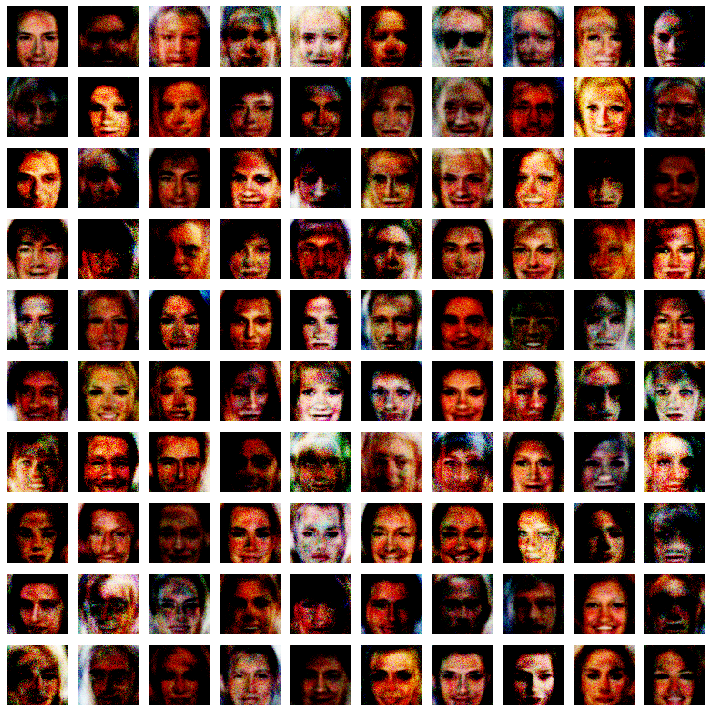

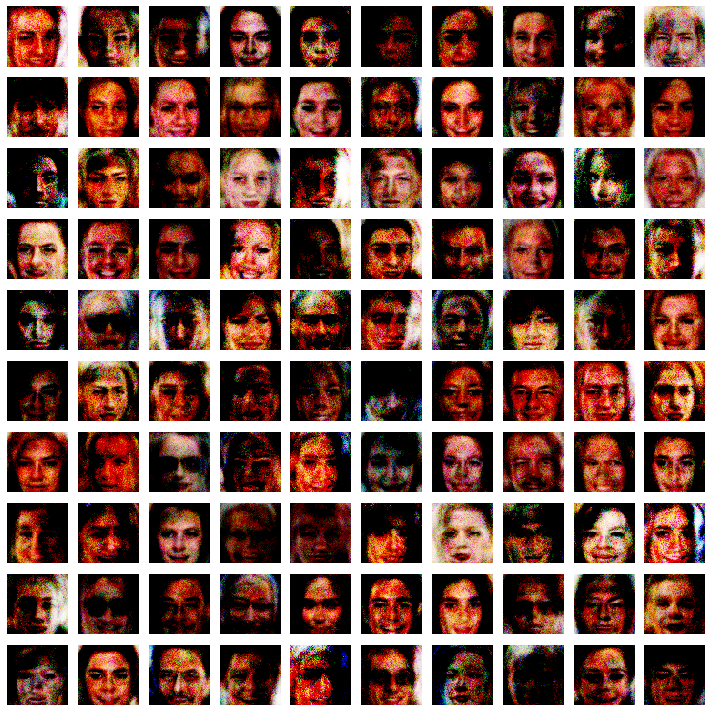

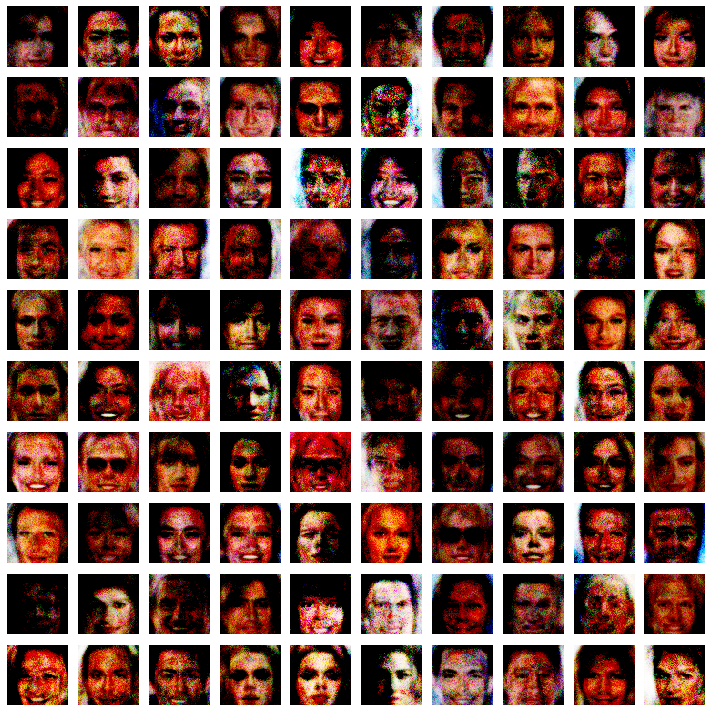

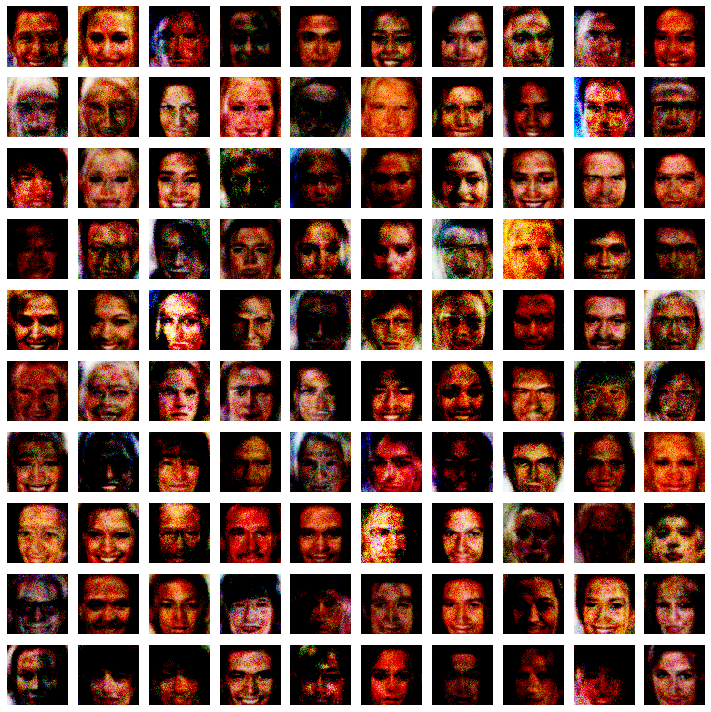

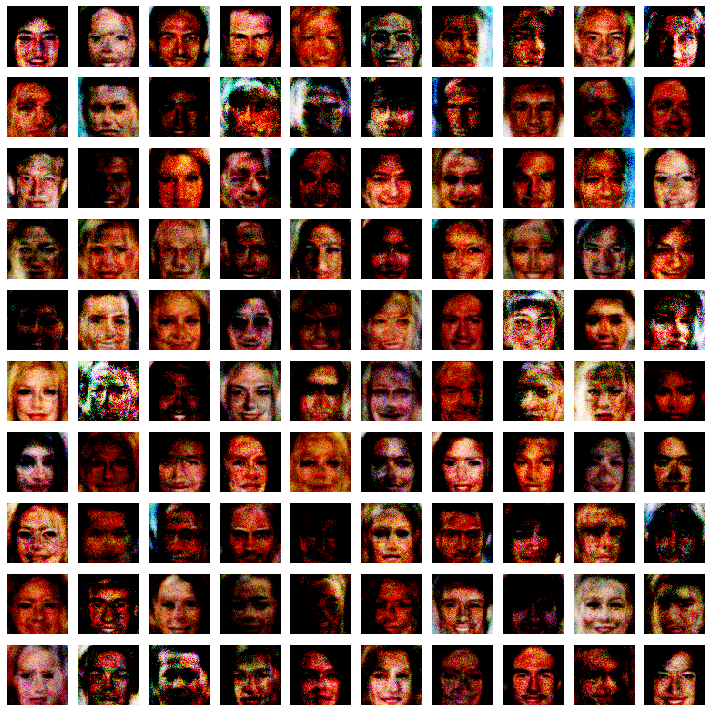

...

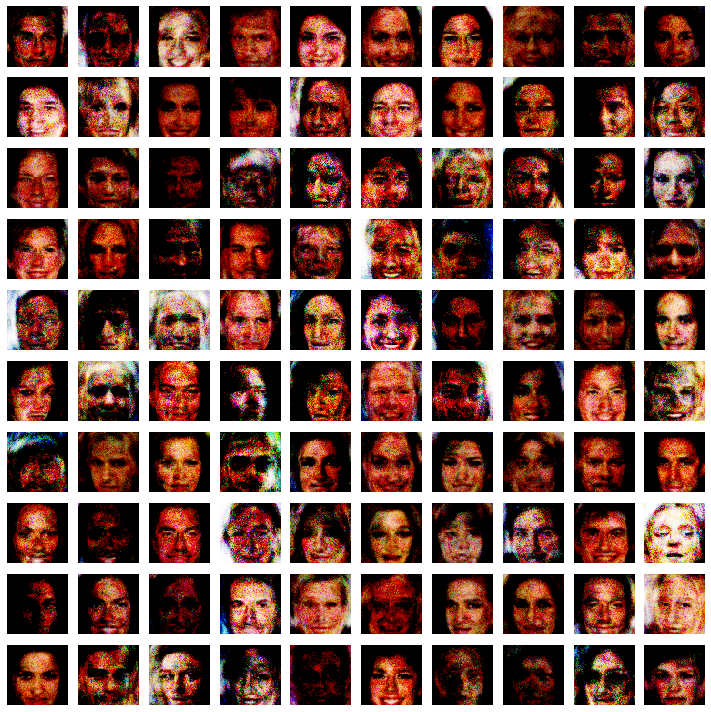

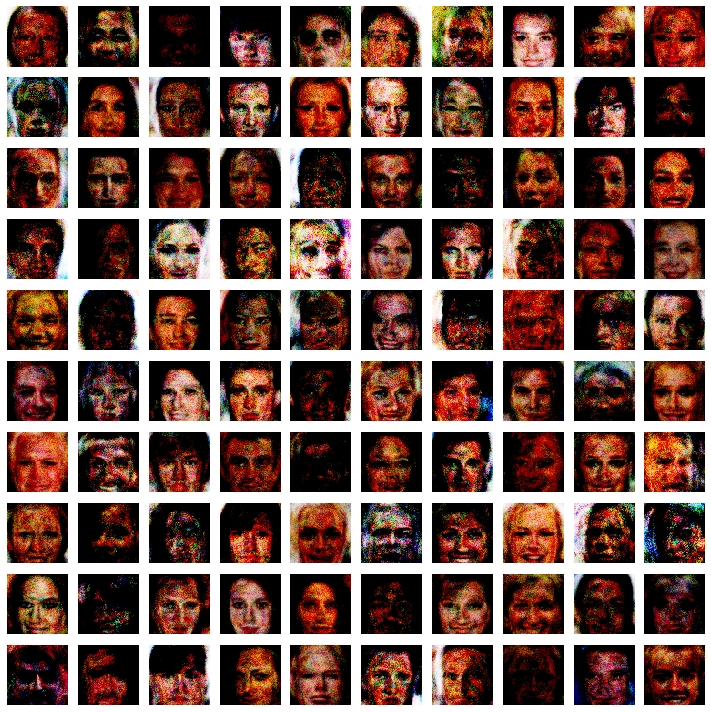

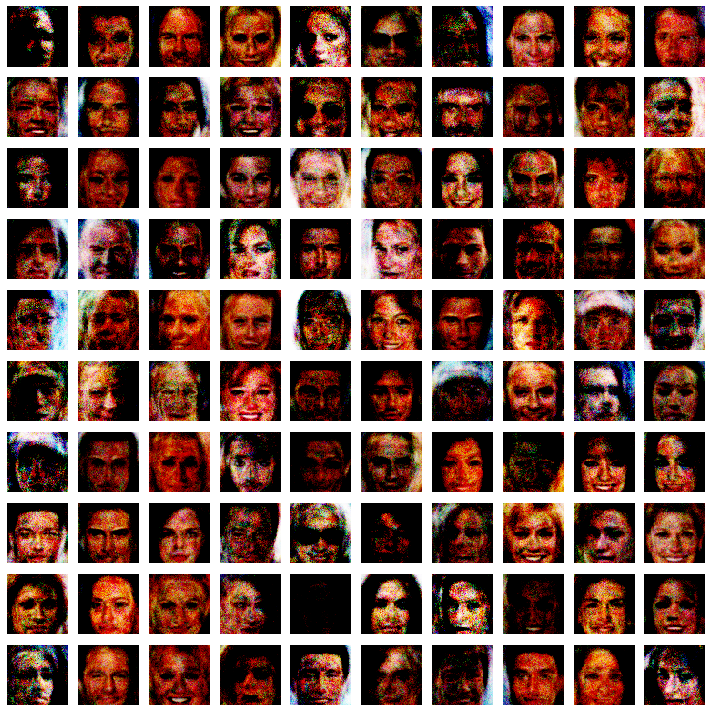

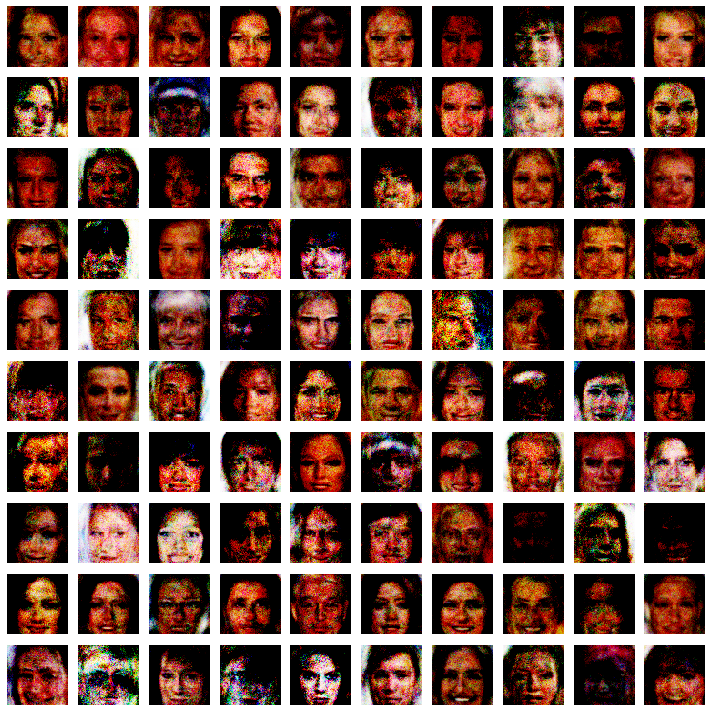

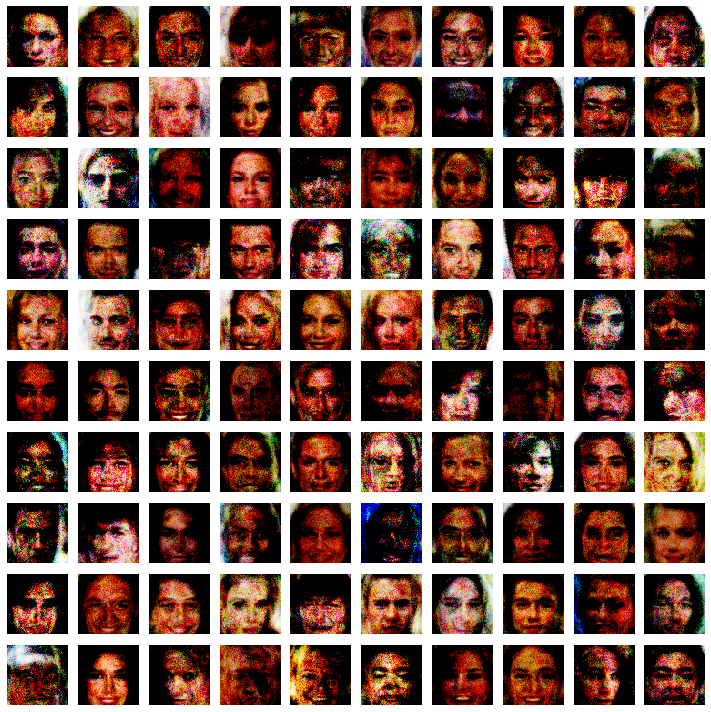

In [69]:
training(train,1000,128)

In [202]:
def training(training_data ,epochs,batch_size,save_images_interval):

    labels_r = np.ones((batch_size,1))
    labels_g = np.zeros((batch_size,1))

    for epoch in range(epochs):
        ind = np.random.randint(0,training_data.shape[0],batch_size)
        img_real = training_data[ind]
        noise = np.random.normal(0,1,(batch_size,100))
        img_fake = generator(noise)

        d_loss_real = discriminator.train_on_batch(img_real,labels_r)
        d_loss_fake = discriminator.train_on_batch(img_fake,labels_g)
        d_loss = 0.5 * np.add(d_loss_real,d_loss_fake)

        g_loss = combined.train_on_batch(noise,labels_r)
        print ("%d [Discriminator loss: %f, acc.: %.2f%%] [Generator loss: %f]" % (epoch, d_loss[0], 100*d_loss[1], g_loss))

        if epoch % save_images_interval == 0:
            save_images(epoch)

    generator.save("saved_models/facegenerator.h5")

In [203]:
training(training_data = train,epochs=101, batch_size=32, save_images_interval=100)

W0820 18:20:13.138046 4510598592 training.py:1952] Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
W0820 18:20:13.224225 4510598592 training.py:1952] Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?


0 [Discriminator loss: 0.619632, acc.: 71.88%] [Generator loss: 1.084062]


W0820 18:20:15.307658 4510598592 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0820 18:20:15.316431 4510598592 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0820 18:20:15.318852 4510598592 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0820 18:20:15.321830 4510598592 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
W0820 18:20:15.327821 4510598592 image.py:693] Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1 [Discriminator loss: 0.626265, acc.: 76.56%] [Generator loss: 1.204832]
2 [Discriminator loss: 0.608759, acc.: 75.00%] [Generator loss: 1.182049]
3 [Discriminator loss: 0.570553, acc.: 71.88%] [Generator loss: 1.292139]
4 [Discriminator loss: 0.491994, acc.: 84.38%] [Generator loss: 1.445489]
5 [Discriminator loss: 0.521876, acc.: 71.88%] [Generator loss: 1.485394]
6 [Discriminator loss: 0.463789, acc.: 81.25%] [Generator loss: 1.456295]
7 [Discriminator loss: 0.536125, acc.: 84.38%] [Generator loss: 1.271461]
8 [Discriminator loss: 0.676891, acc.: 42.19%] [Generator loss: 0.875628]
9 [Discriminator loss: 0.700391, acc.: 40.62%] [Generator loss: 0.837671]
10 [Discriminator loss: 0.643243, acc.: 59.38%] [Generator loss: 1.072568]
11 [Discriminator loss: 0.551034, acc.: 81.25%] [Generator loss: 1.257122]
12 [Discriminator loss: 0.513470, acc.: 78.12%] [Generator loss: 1.427056]
13 [Discriminator loss: 0.520981, acc.: 81.25%] [Generator loss: 1.502745]
14 [Discriminator loss: 0.445798, 